<a href="https://colab.research.google.com/github/4teven/AI-is-all-you-Need/blob/main/Deep_Learning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Deep Learning**


## Regularization




1.   **L1 and L2**
2.   **Dropout**
3.   Data Augment
  * Mirroring
  * Random Cropping
      * Rotation
      * Shearing
      * Local warping
  * Color shifting
      * PCA

4.   Early stopping
  * Stop the iteration at a quite good dev set error point






> **L1 and L2**





*   **Weight decay** limits the size of the weights by increasing the penalty term in the loss function, making it impossible for the model to arbitrarily increase the weights to fit the noise in the training data
*   L2 regularization tends to make the distribution of weights more even, preventing individual weights from being too large, weights determine how inputs affect outputs. Larger weights can cause neurons to produce large output changes in response to small changes in inputs
  *  Reducing the over-reliance of the model on certain features improves the stability of the model





* L2:

$$
L = L_{orginal} + \frac{\lambda}{2}\sum_{i=1}^{n} w_i^2
$$



*   The regularization term makes it possible to update the weights during the gradient descent update process not only by considering the **reduction of the loss function**, but also by not increasing the regularization **penalty term**
  *   If there is noise in the training data, the model may require very large weights to accurately fit these noise points
  *   The model needs to find a balance between reducing $L_{original}$ and keeping 𝑅(𝑤) small when minimizing the total loss L
     *  By derivative:
     $$\frac{\partial L}{\partial w_i} = \frac{\partial L_{\text{original}}}{\partial w_i} + \lambda w_i $$
    
     * Update params at time t:
     $$
     w_{t+1}=(1- ŋλ)w_t -  ŋ \frac{\partial 𝓵(w_t,b_t)}{\partial w_t}
     $$
     Normally, ŋλ<1, in Deep learning we called it **Weight Decay**
     
     * This means that every time the weights are updated, there is an extra $2\lambda w_i$ item that stops the weights from being too large
  



L2:

Used for a small number of samples to reduce variance from the train set, overfitting

L1:

Used to get rid of useless features

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
pip install d2l

In [ ]:
%matplotlib inline
import torch
from torch import nn
from d2l import torch as d2l

$$y = 0.05 + \sum_{i=1}^{d} 0.01 x_i + \epsilon \quad \text{where} \quad \epsilon \sim \mathcal{N}(0, 0.01^2)$$


In [ ]:
n_train, n_test, num_inputs, batch_size = 20, 100, 200, 5
true_w, true_b = torch.ones((num_inputs, 1)) * 0.01, 0.05
train_data = d2l.synthetic_data(true_w, true_b, n_train)
train_iter = d2l.load_array(train_data, batch_size)
test_data = d2l.synthetic_data(true_w, true_b, n_test)
test_iter = d2l.load_array(test_data, batch_size, is_train=False)

In [ ]:
def init_params():
    w = torch.normal(0, 1, size=(num_inputs, 1), requires_grad=True)
    b = torch.zeros(1, requires_grad=True)
    return [w, b]

In [ ]:
def l2_penalty(w):
    return torch.sum(w.pow(2)) / 2

In [ ]:
def train(lambd):
    w, b = init_params()
    net, loss = lambda X: d2l.linreg(X, w, b), d2l.squared_loss
    num_epochs, lr = 100, 0.003
    animator = d2l.Animator(xlabel='epochs', ylabel='loss', yscale='log',
                            xlim=[5, num_epochs], legend=['train', 'test'])
    for epoch in range(num_epochs):
        for X, y in train_iter:
            l = loss(net(X), y) + lambd * l2_penalty(w)
            l.sum().backward()
            d2l.sgd([w, b], lr, batch_size)
        if (epoch + 1) % 5 == 0:
            animator.add(epoch + 1, (d2l.evaluate_loss(net, train_iter, loss),
                                     d2l.evaluate_loss(net, test_iter, loss)))
    print('L2 Norm of w:', torch.norm(w).item())

L2 Norm of w: 13.11491870880127


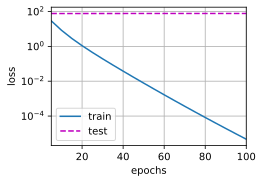

In [ ]:
train(lambd=0)

L2 Norm of w: 0.37415698170661926


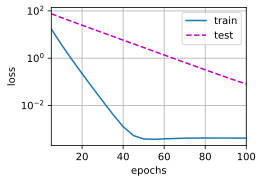

In [ ]:
train(lambd=3)

In [ ]:
def train_concise(wd):
    net = nn.Sequential(nn.Linear(num_inputs, 1))
    for param in net.parameters():
        param.data.normal_()
    loss = nn.MSELoss(reduction='none')
    num_epochs, lr = 100, 0.003
    # No decay in Bias
    trainer = torch.optim.SGD([
        {"params":net[0].weight,'weight_decay': wd},
        {"params":net[0].bias}], lr=lr)
    animator = d2l.Animator(xlabel='epochs', ylabel='loss', yscale='log',
                            xlim=[5, num_epochs], legend=['train', 'test'])
    for epoch in range(num_epochs):
        for X, y in train_iter:
            trainer.zero_grad()
            l = loss(net(X), y)
            l.mean().backward()
            trainer.step()
        if (epoch + 1) % 5 == 0:
            animator.add(epoch + 1,
                         (d2l.evaluate_loss(net, train_iter, loss),
                          d2l.evaluate_loss(net, test_iter, loss)))
    print('L2 Norm of w：', net[0].weight.norm().item())

L2 Norm of w： 14.750377655029297


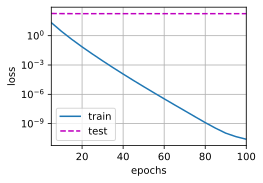

In [ ]:
train_concise(0)

L2 Norm of w： 0.3605937361717224


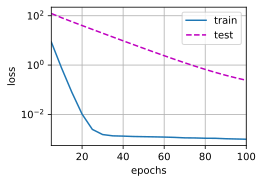

In [ ]:
train_concise(3)



> **Dropout**

1. *Tradition Dropout*

Dropout is a regularization method that randomly discards a fraction of neurons and their connections in each training iteration.

**Purpose**: to prevent co-adaptation between neurons, where the model is too dependent on some specific combination of neurons.

**Property**:
*   Dropout forces each neuron of the model to be more adaptable, as any neuron can be dropped during training.


*   Dropout breaks the complex co-adaptive relationships between neurons, preventing the model from relying too heavily on particular combinations of neurons

**Training phase**:

For each layer, neurons are retained with probability 𝑝 (usually 0.5) and discarded with probability 1-𝑝.

The output of discarded neurons is set to 0 and does not participate in subsequent computations.

**Test phase**:

Dropout is not used, i.e., all neurons are kept.

Scaling of the neuron outputs is required to match the activation value expectations from training.


2. *Inverted Dropout*

Inverted Dropout is the **scaling** of the outputs of the retained neurons during the **training phase**, **without any scaling or adjustment** during the **testing phase**.

**Purpose**: To ensure that the expectation of neuron activation values in the training and testing phases are consistent and to simplify the implementation.



Advantages:
* Ensure consistent activation value expectations in the training and testing phases by scaling in the training phase.
  * Ensure that the behavior of the neural network is as consistent as possible between the training and testing phases
  * So that the features and patterns learned by the model during training can be effectively applied in the testing phase.
* No need to scale activation values during testing, reducing implementation complexity and computational overheads

**Usually used in the area in CV(Computer Vision)**

In [ ]:
# Inverted Dropout logic
d3 = np.random.randn(a3.shape[0], a3.shape[1]) < keep_prob
#Generate a matrix of the same shape as a3 with elements taking values between (0,1) and obeying a uniform distribution.
a3 = np.multiply(a3, d3)
a3 /= keep_prob #Scaling the activation values of retained neurons

In [ ]:
net = nn.Sequential(nn.Flatten(),
        nn.Linear(784, 256),
        nn.ReLU(),
        nn.Dropout(0.5),
        nn.Linear(256, 256),
        nn.ReLU(),
        nn.Dropout(0.5),
        nn.Linear(256, 10))

def init_weights(m):
    if type(m) == nn.Linear:
        nn.init.normal_(m.weight, std=0.01)

net.apply(init_weights);

In [ ]:
num_epochs, lr, batch_size = 10, 0.5, 256
loss = nn.CrossEntropyLoss(reduction='none')
train_iter, test_iter = d2l.load_data_fashion_mnist(batch_size)
trainer = torch.optim.SGD(net.parameters(), lr=lr)
d2l.train_ch3(net, train_iter, test_iter, loss, num_epochs, trainer)

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:617: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


AttributeError: module 'd2l.torch' has no attribute 'train_ch3'



> Example



In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
import warnings
warnings.filterwarnings('ignore')

df = pd.read_csv('/content/drive/MyDrive/MD/Learning is Learning/sonar_dataset.csv',header=None)
df.sample(5)

,0,1,2,3,4,5,6,7,8,9,...,51,52,53,54,55,56,57,58,59,60
102,0.0587,0.1210,0.1268,0.1498,0.1436,0.0561,0.0832,0.0672,0.1372,0.2352,...,0.0331,0.0111,0.0088,0.0158,0.0122,0.0038,0.0101,0.0228,0.0124,M
25,0.0201,0.0026,0.0138,0.0062,0.0133,0.0151,0.0541,0.0210,0.0505,0.1097,...,0.0108,0.0070,0.0063,0.0030,0.0011,0.0007,0.0024,0.0057,0.0044,R
182,0.0095,0.0308,0.0539,0.0411,0.0613,0.1039,0.1016,0.1394,0.2592,0.3745,...,0.0181,0.0019,0.0102,0.0133,0.0040,0.0042,0.0030,0.0031,0.0033,M
111,0.0530,0.0885,0.1997,0.2604,0.3225,0.2247,0.0617,0.2287,0.0950,0.0740,...,0.0244,0.0199,0.0257,0.0082,0.0151,0.0171,0.0146,0.0134,0.0056,M
146,0.1021,0.0830,0.0577,0.0627,0.0635,0.1328,0.0988,0.1787,0.1199,0.1369,...,0.0709,0.0317,0.0309,0.0252,0.0087,0.0177,0.0214,0.0227,0.0106,M


In [ ]:
df.shape

(208, 61)

In [ ]:
df.isna().sum()

,0
0,0
1,0
2,0
3,0
4,0
...,...
56,0
57,0
58,0
59,0


In [ ]:
df.columns # no column names

Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35,
       36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53,
       54, 55, 56, 57, 58, 59, 60],
      dtype='int64')

In [ ]:
df[60].value_counts()

,count
60,
M,111
R,97


In [ ]:
X = df.drop(60,axis=1)
y = df[60]

In [ ]:
y_cat = pd.get_dummies(y,drop_first=True).astype(int)
y_cat.sample(5)

,R
18,1
40,1
143,0
37,1
94,1


In [ ]:
y_cat.value_counts()

,count
R,
0,111
1,97


In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y_cat, test_size=0.25, random_state=1)

In [ ]:
X_train.shape, X_test.shape

((156, 60), (52, 60))

In [ ]:
import tensorflow as tf
from tensorflow import keras

In [ ]:
model = keras.Sequential([
    keras.layers.Dense(60, input_dim=60, activation='relu'),
    keras.layers.Dense(30, activation='relu'),
    keras.layers.Dense(15, activation='relu'),
    keras.layers.Dense(1, activation='sigmoid')
])

model.compile(optimizer='adam',
              loss='binary_crossentropy',
              metrics=['accuracy'])

model.fit(X_train, y_train, epochs=100, batch_size=8)

In [ ]:
model.evaluate(X_test, y_test)

2/2 ━━━━━━━━━━━━━━━━━━━━ 3s 444ms/step - accuracy: 0.6931 - loss: 1.4888


[1.330589771270752, 0.7115384340286255]

In [ ]:
y_pred = model.predict(X_test).reshape(-1)
print(y_pred[:10])

y_pred = np.round(y_pred)
print(y_pred[:10])

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 269ms/step
[8.2509306e-09 9.9519628e-01 9.9748981e-01 1.2170662e-05 9.9999988e-01
 9.9995315e-01 8.6864012e-01 9.9999988e-01 1.5436457e-05 9.9999988e-01]
[0. 1. 1. 0. 1. 1. 1. 1. 0. 1.]


In [ ]:
y_test[:10]

,R
186,0
155,0
165,0
200,0
58,1
34,1
151,0
18,1
202,0
62,1


In [ ]:
from sklearn.metrics import confusion_matrix , classification_report

print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.69      0.81      0.75        27
           1       0.75      0.60      0.67        25

    accuracy                           0.71        52
   macro avg       0.72      0.71      0.71        52
weighted avg       0.72      0.71      0.71        52



In [ ]:
model_drop = keras.Sequential([
    keras.layers.Dense(60, input_dim=60, activation='relu'),
    keras.layers.Dropout(0.5),
    keras.layers.Dense(30, activation='relu'),
    keras.layers.Dropout(0.5),
    keras.layers.Dense(15, activation='relu'),
    keras.layers.Dropout(0.5),
    keras.layers.Dense(1, activation='sigmoid')
])
model_drop.compile(optimizer='adam',
              loss='binary_crossentropy',
              metrics=['accuracy'])

model_drop.fit(X_train, y_train, epochs=100, batch_size=8)

In [ ]:
model_drop.evaluate(X_test, y_test)

2/2 ━━━━━━━━━━━━━━━━━━━━ 4s 309ms/step - accuracy: 0.7756 - loss: 0.4653


[0.44677111506462097, 0.7884615659713745]

In [ ]:
y_pred = model_drop.predict(X_test).reshape(-1)
print(y_pred[:10])

y_pred = np.round(y_pred)
print(y_pred[:10])

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 231ms/step
[0.00196861 0.52878666 0.81494325 0.0308568  0.999298   0.7595447
 0.25516772 0.99932134 0.04821543 0.99960494]
[0. 1. 1. 0. 1. 1. 0. 1. 0. 1.]


In [ ]:
y_test[:10]

,R
186,0
155,0
165,0
200,0
58,1
34,1
151,0
18,1
202,0
62,1


In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.74      0.93      0.82        27
           1       0.89      0.64      0.74        25

    accuracy                           0.79        52
   macro avg       0.81      0.78      0.78        52
weighted avg       0.81      0.79      0.78        52



## MLP

* Why do we need Neural Networks?

  Thinking about nonlinear classification boundaries

  1. Apply a linear classifier to some features of the data
    * but not that general
  2. If we just again use a linear function for 𝞥 ?
  $$
  𝞥(x) = W^T x
  $$
  This does not work, it still a linear classifier

  Thus, we have
  $$
  𝞥(x)=𝛔(W^Tx)
  $$
  Where $ W \in \mathbb{R}^{n \times d}$, and 𝛔: $\mathbb{R}^{d} → \mathbb{R}^{d}$ is essentially any nonlinear function

  * And we are having a nonlinear classifier which is the basic form of Neural Network

**Example**

$$
h_{\theta}(x)= W_2^T𝛔(W_1^Tx)
$$
$$
\theta = \{W_1 \in \mathbb{R}^{n\times d},W_2 \in \mathbb{R}^{d\times k}\}
$$
Where 𝛔 is sigmoid or ReLu function or etc.

**Theorem (1D case)**
Given any smooth function $ f: \mathbb{R} \to \mathbb{R} $, closed region $\mathcal{D} \subset \mathbb{R}$, and $\epsilon > 0$, we can construct a one-hidden-layer neural network $\hat{f}$ such that:

$$
\max_{x \in \mathcal{D}} \left| f(x) - \hat{f}(x) \right| \leq \epsilon
$$

**Proof:**

Select some dense sampling of points $(x^{(i)}, f(x^{(i)}))$ over $\mathcal{D}$. Create a neural network that passes exactly through these points (see next slide). Because the neural network function is piecewise linear, and the function $f$ is smooth, by choosing the $x^{(i)}$ close enough together, we can *approximate the function arbitrarily closely*.




> **MLP**

A more generic form of a L-layer neural network - a.k.a "MLP", feedforward network,fully-connected network


$$
Z_{i+1}= 𝛔_i(Z_iW_i), i =1,...,L
$$
$$
Z_1=X (Input)
$$
$$
h_{\theta}(X) = Z_{L+1} (Output)
$$
$$
[Z_i \in \mathbb{R}^{m\times n_i},W_i \in \mathbb{R}^{n_i\times n_{i+1}}]
$$

which parameters $ \theta = \{W_1,...,W_L\} $ where bias terms is ignored here


In [ ]:

# MLP with 1 hidden layer
import torch
import torch.nn as nn
def relu(X):
  return torch.maximum(X, torch.tensor(0.0))

W_1 = nn.Parameter(torch.randn(num_inputs,num_hiddens)*0.01) # *0.01 is to initialize the parameter and prevent to explode
b_1 = nn.Parameter(torch.zeros(num_hiddens,1))
W_2 = nn.Parameter(torch.randn(num_hiddens,num_outputs)*0.01)
b_2 = nn.Parameter(torch.zeros(num_outputs,1))

H = relu(torch.matmul(W_1,X)+b_1) # relu(X@W_1+b_1)
y_hat = torch.matmul(W_2,H)+b_2 #H@W_2 + b_2

In [ ]:
import torch
import torch.nn as nn

# ReLU 激活函数
def relu(X):
    return X.clamp(min=0)  # 或者使用 torch.maximum(X, torch.tensor(0.0))

# 假设 num_inputs、num_hiddens、num_outputs 是已经定义的
num_inputs = 3
num_hiddens = 4
num_outputs = 2

# 初始化参数
W_1 = nn.Parameter(torch.randn(num_inputs, num_hiddens) * 0.01)
b_1 = nn.Parameter(torch.zeros(num_hiddens, 1))
W_2 = nn.Parameter(torch.randn(num_hiddens, num_outputs) * 0.01)
b_2 = nn.Parameter(torch.zeros(num_outputs, 1))

# 输入数据 X (形状为 num_inputs x batch_size)
X = torch.randn(num_inputs, 5)  # 假设 batch_size 为 5

# 前向传播
H = relu(torch.matmul(W_1.T, X) + b_1)  # 隐藏层计算
y_hat = torch.matmul(W_2.T, H) + b_2    # 输出层计算

print(y_hat)


tensor([[ 1.4999e-04,  2.3141e-05,  7.8689e-05,  8.8667e-05,  2.1071e-04],
        [-1.4834e-04,  7.6033e-05,  1.6806e-04,  7.7347e-05, -2.0840e-04]],
       grad_fn=<AddBackward0>)


In [ ]:
print(X)

tensor([[-0.5425, -0.8004, -1.4478, -0.2879,  2.6579],
        [ 0.3825, -0.4567, -1.2293,  1.0742,  0.1411],
        [-0.9293,  0.9351, -0.4611, -0.0383,  0.3785]])


In [ ]:
loss_fn = nn.MSELoss()
y = torch.randn(num_outputs, 5)  # 假设这是标签
loss = loss_fn(y_hat, y)
print('Loss:', loss.item())


Loss: 0.6018139123916626


In [ ]:
learning_rate = 0.01
with torch.no_grad():
    W_1 -= learning_rate * W_1.grad
    b_1 -= learning_rate * b_1.grad
    W_2 -= learning_rate * W_2.grad
    b_2 -= learning_rate * b_2.grad

    # 清零梯度
    W_1.grad.zero_()
    b_1.grad.zero_()
    W_2.grad.zero_()
    b_2.grad.zero_()


TypeError: unsupported operand type(s) for *: 'float' and 'NoneType'

In [ ]:
import torch.optim as optim

# 定义优化器
optimizer = optim.SGD([W_1, b_1, W_2, b_2], lr=learning_rate)

# 前向传播、计算损失...
loss = loss_fn(y_hat, y)

# 反向传播计算梯度
loss.backward()

# 使用优化器更新参数
optimizer.step()


In [ ]:
print('Updated W_1:', W_1)
print('Updated b_1:', b_1)
print('Updated W_2:', W_2)
print('Updated b_2:', b_2)

Updated W_1: Parameter containing:
tensor([[-0.0101, -0.0086,  0.0077, -0.0165],
        [-0.0008,  0.0183, -0.0100,  0.0100],
        [ 0.0078,  0.0003,  0.0025, -0.0021]], requires_grad=True)
Updated b_1: Parameter containing:
tensor([[-1.5101e-05],
        [ 1.4128e-05],
        [ 6.2096e-05],
        [-1.2839e-05]], requires_grad=True)
Updated W_2: Parameter containing:
tensor([[ 0.0108, -0.0054],
        [ 0.0050,  0.0079],
        [ 0.0121, -0.0120],
        [-0.0090, -0.0001]], requires_grad=True)
Updated b_2: Parameter containing:
tensor([[ 0.0042],
        [-0.0015]], requires_grad=True)


In [ ]:
# 清零梯度
optimizer.zero_grad()




---



## Convolution Neural Networks (CNN)




Dense Layer -> Convolution layer

Learning ImageNet (300 * 300) images with 1K classes by a MLP with a single Hidden layer with 10k outputs. In this case, assume we have 10,000 neurons in the hidden layer (90,000 of inputs and 1000 for output, we take a medium value)

-- Thus, we will have 90,000 * 10,000 parameter to train for this NN which nearly 1 billion. That's too much of parameter for MLP


**Solution for this**


Some  prior knowledge that can be added

For recognizing object in Image:

1. Translation Invariance:

The object to be recognize will not change too much if it shift to somewhere else

2. Locality:

Recognizing one object do not need the pixel that far away (the pixels around are highly related)


---



> **Convolutional Neural Network (CNN)**




*   A neural network ueses stack of convolution layers to extract features

  -- (Not necessary to process picture, something related to spatial infos, only need to satisfy the locality and Translation Invariance)

  *   Activation is applied after each convolution layer
  *   Using pooling to reduce location sensitivity

* Parameter sharing:
  
  A feature detetcor(vertical edge) that's useful in one part of the image is probably useful in another part of the image

* Sparsity of Connections:

  In each layer, each output value depends only on a small number of inputs

*   Modern CNNs are deep neural network with various hyper-params and layer connections (AlexNet, VGG, Inceptions, ResNet, MobileNet)





> **Convolution Layer**





*  **Locality**:

  An output is computed from K*K input windows (Only focus on the part we want, ignore the others).
  
  But for MLP (Fully connect NN), it will go through all the pixels of the image.


*   **Translation Invariance**:

  If we have an learnt weight, transform it to another place, it can still recognize objects.



*  **#** The number of params of a conv layer does not depend on input/output sizes


*   **A** kernel may learn to identify a pattern

  The k*k window is called kernel, usually being used to learn the some pattern or feature of the image.

  Varies between different data or models, however, we will use different kinds of channel which select multiple set of datat to obtain a multi-channel output to learn different kinds of pattern.




In [ ]:
import torch
# Convolution with single input and output channels
def corr2d(X, K): # X is the input and K is the weight both are metrics
    """Compute 2D cross-correlation."""
    h, w = K.shape #window size
    Y = torch.zeros((X.shape[0] - h + 1, X.shape[1] - w + 1)) # output size
    for i in range(Y.shape[0]):
        for j in range(Y.shape[1]):
            Y[i, j] = (X[i:i + h, j:j + w] * K).sum()
    return Y

In [ ]:
X = torch.tensor([[0.0, 1.0, 2.0], [3.0, 4.0, 5.0], [6.0, 7.0, 8.0]])
K = torch.tensor([[0.0, 1.0], [2.0, 3.0]])
corr2d(X, K)

tensor([[19., 25.],
        [37., 43.]])

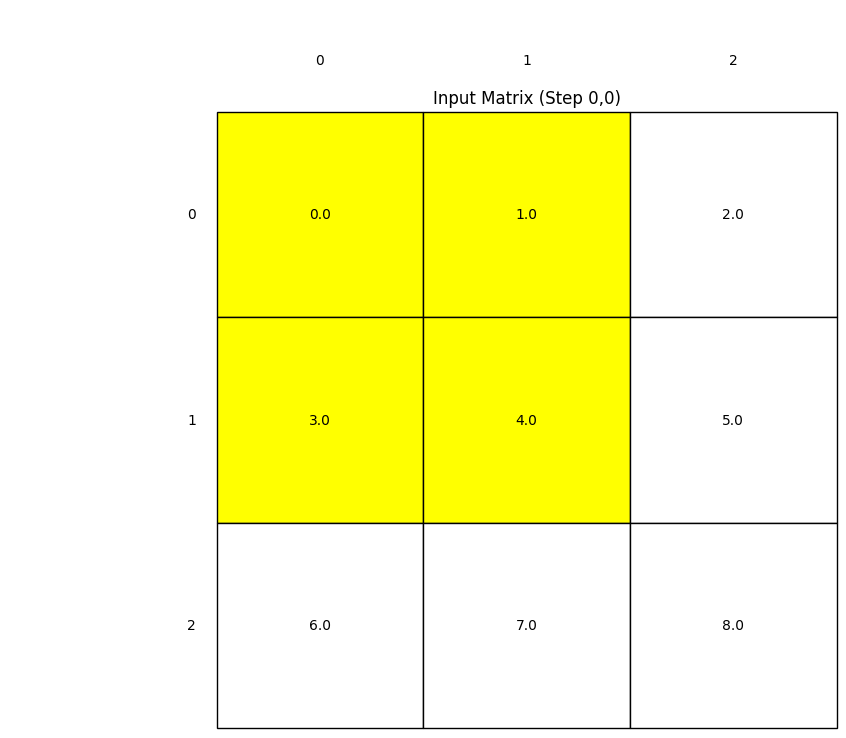

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.table import Table
import time
import torch

X = torch.tensor([[0.0, 1.0, 2.0],
                  [3.0, 4.0, 5.0],
                  [6.0, 7.0, 8.0]])
K = torch.tensor([[0.0, 1.0],
                  [2.0, 3.0]])

h, w = K.shape
Y = torch.zeros((X.shape[0] - h + 1, X.shape[1] - w + 1))

fig, ax = plt.subplots(figsize=(8, 8))

def draw_table(data, title, highlight_coords=None):
    ax.clear()
    ax.set_axis_off()
    table = Table(ax, bbox=[0, 0, 1, 1])
    nrows, ncols = data.shape
    width, height = 1.0 / ncols, 1.0 / nrows

    # Add cells
    for (i, j), val in np.ndenumerate(data.numpy()):
        if highlight_coords and (i, j) in highlight_coords:
            color = 'yellow'
        else:
            color = 'white'
        table.add_cell(i, j, width, height, text=val, loc='center', facecolor=color)

    # Row and column labels
    for i in range(nrows):
        table.add_cell(i, -1, width, height, text=i, loc='right',
                       edgecolor='none', facecolor='none')
    for j in range(ncols):
        table.add_cell(-1, j, width, height/2, text=j, loc='center',
                       edgecolor='none', facecolor='none')

    ax.add_table(table)
    ax.set_title(title)
    plt.pause(1)

for i in range(Y.shape[0]):
    for j in range(Y.shape[1]):
        region = X[i:i + h, j:j + w]
        Y[i, j] = torch.sum(region * K)
        draw_table(X, f'Input Matrix (Step {i},{j})', highlight_coords=[(i + x, j + y) for x in range(h) for y in range(w)])
        draw_table(K, 'Kernel')
        draw_table(Y, 'Output Matrix')

plt.show()



---





>  **Vertical Edge Detection**



Given the input matrix:

$$
\begin{bmatrix}
10 & 10 & 10 & 0 & 0 & 0 \\
10 & 10 & 10 & 0 & 0 & 0 \\
10 & 10 & 10 & 0 & 0 & 0 \\
10 & 10 & 10 & 0 & 0 & 0 \\
10 & 10 & 10 & 0 & 0 & 0 \\
\end{bmatrix}
$$

The convolution operation with the filter:

$$
\text{Filter} =
\begin{bmatrix}
1 & 0 & -1 \\
1 & 0 & -1 \\
1 & 0 & -1 \\
\end{bmatrix}
$$

Produces the output matrix:

$$
\begin{bmatrix}
0 & 30 & 30 & 0 \\
0 & 30 & 30 & 0 \\
0 & 30 & 30 & 0 \\
0 & 30 & 30 & 0 \\
\end{bmatrix}
$$

This highlights the vertical edges in the image.


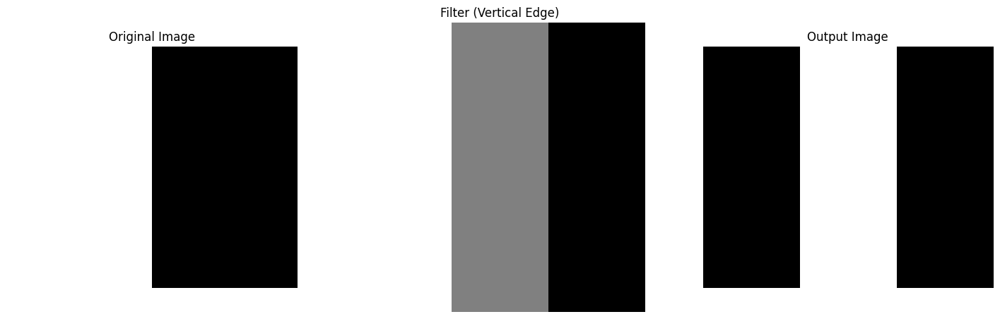

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Define the input matrix (image) - Grayscale, each value corresponds to a different intensity
image = np.array([[5, 5, 5, 0, 0, 0],
                  [5, 5, 5, 0, 0, 0],
                  [5, 5, 5, 0, 0, 0],
                  [5, 5, 5, 0, 0, 0],
                  [5, 5, 5, 0, 0, 0]])

# Define the filter for vertical edge detection
filter_vertical = np.array([[1, 0, -1],
                            [1, 0, -1],
                            [1, 0, -1]])

# Function to apply the filter (convolution)
def convolution2d(image, kernel):
    kernel_height, kernel_width = kernel.shape
    padded_image = np.pad(image, ((kernel_height//2, kernel_height//2), (kernel_width//2, kernel_width//2)), mode='constant')
    output = np.zeros_like(image)

    for i in range(image.shape[0]):
        for j in range(image.shape[1]):
            region = padded_image[i:i + kernel_height, j:j + kernel_width]
            output[i, j] = np.sum(region * kernel)

    return output

# Apply the convolution
output = convolution2d(image, filter_vertical)

# Adjust output values for visualization
output_normalized = np.clip(output, -5, 5)  # Clip values for better visualization

# Plot the input image, the filter, and the output
plt.figure(figsize=(18, 6))

# Original Image
plt.subplot(1, 3, 1)
plt.title("Original Image")
plt.imshow(image, cmap='gray', vmin=0, vmax=5)
plt.axis('off')

# Filter Visualization
plt.subplot(1, 3, 2)
plt.title("Filter (Vertical Edge)")
plt.imshow(filter_vertical, cmap='gray', vmin=-1, vmax=1)
plt.axis('off')

# Output after Vertical Edge Detection
plt.subplot(1, 3, 3)
plt.title("Output Image")
plt.imshow(output, cmap='gray', vmin=0, vmax=10)  # Set appropriate vmin and vmax
plt.axis('off')
plt.show()


plt.show()


Above is just a abstract graph to show the vertical edge detection,

We can see that there is boundary between white and gray for orginal image

by CNN, it can be augmented in a white band in the output



---





> **Padding**



In CNNs, padding is mainly used to control the spatial dimensions of the feature map. Specifically, padding helps to maintain consistent input and output sizes or adjust the size of the feature maps based on the requirements.

1. **Why is Padding Needed?**

  - **To Preserve Size**: Without padding, the border elements in an image have fewer neighboring elements, which could cause the feature map size to shrink after each convolution operation. Padding helps maintain consistent input and output sizes, making it easier to build deeper networks.
  
  - **To Preserve Border Information**: Padding helps retain the border information of data, avoiding the loss of crucial edge features during convolution.

2. **Common Types of Padding**

* **Valid Padding (No Padding)**

  - **Definition**: No padding is applied to the input, and convolution is performed directly.

  - **Characteristic**: The output feature map size will be smaller than the input.

  - **Formula**:

$$
\text{Output Size} = \left\lfloor \frac{\text{Input Size} - \text{Kernel Size}}{\text{Stride}} \right\rfloor + 1
$$

* **Same Padding (Zero Padding)**

  - **Definition**: Padding with zeros is applied around the border of the input, ensuring that the output feature map has the same size as the input (when stride = 1).

  - **Characteristic**: The output size is preserved to be the same as the input size.

  - **Formula**:

$$
\text{Padding} = \frac{(\text{Stride} - 1) \times \text{Input Size} - \text{Stride} + \text{Kernel Size}}{2}
$$

* **Full Padding**

  - **Definition**: Padding is added around the border of the input to ensure the convolution kernel completely covers all border pixels.

  - **Characteristic**: The output feature map size will be larger than the input size.

  - **Application**: Rarely used, mainly for specific requirements.


In [ ]:
import tensorflow as tf
from tensorflow.keras.layers import Conv2D
from tensorflow.keras.models import Sequential

model = Sequential([
    Conv2D(filters=32, kernel_size=(3, 3), padding='valid', activation='relu', input_shape=(28, 28, 1)), # zero padding
    Conv2D(filters=64, kernel_size=(3, 3), padding='same', activation='relu'), # same padding
])

model.summary()


Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_4 (Conv2D)                    │ (None, 26, 26, 32)          │             320 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_5 (Conv2D)                    │ (None, 26, 26, 64)          │          18,496 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 18,816 (73.50 KB)

 Trainable params: 18,816 (73.50 KB)

 Non-trainable params: 0 (0.00 B)


* **Stride**

$$
Output Dimension = \frac{n+2p-f}{s} +1
$$

p is the padding

n is the input dimension

f is the filter dimension

s is the step/stride



> **3D CNN**



$$
Height * Width * channels
$$
RGB images for examples and this is for both Input and filter

$$
Output = OuputDimension*OutputDimension*filterNumber
$$

If Layer $l$ is a Convolution Layer:

- $f^{[l]}$: Filter size
- $ p^{[l]} $: Padding
- $ s^{[l]} $: Stride
- $ n_c^{[l]} $: Number of filters

Each filter is:
$
f^{[l]} \times f^{[l]} \times n_c^{[l-1]}
$

Activations:
$
a^{[l]}: n_H^{[l]} \times n_W^{[l]} \times n_c^{[l]}
$

Weights:
$
W^{[l]}: f^{[l]} \times f^{[l]} \times n_c^{[l-1]} \times n_c^{[l]}
$

Bias:
$
b^{[l]}: (1, 1, 1, n_c^{[l]})
$

Input Dimensions:
$
n_H^{[l-1]} \times n_W^{[l-1]} \times n_c^{[l-1]}
$

Output Dimensions:
$
n_H^{[l]} \times n_W^{[l]} \times n_c^{[l]}
$

Output Height and Width Calculation:

$
n_H^{[l]} = \left( \frac{n_H^{[l-1]} + 2p^{[l]} - f^{[l]}}{s^{[l]}} \right) + 1
$

$
n_W^{[l]} = \left( \frac{n_W^{[l-1]} + 2p^{[l]} - f^{[l]}}{s^{[l]}} \right) + 1
$

Number of Parameters:
- **Weights**: $ f^{[l]} \times f^{[l]} \times n_c^{[l-1]} \times n_c^{[l]} $
- **Bias**: $ n_c^{[l]} $


**Example and Notion:**

Say that, we having a $6×6×3$ input, and using a $3×3×3$ filter to Convolute:
* If we have only one filter,
  - The output will be like: using the filter to convolute for each $3×3$ channel and add together for one element
  - The ouput will be like $4×4$ with only one filter


- Suppose you have an input tensor $X$ of size **$2 \times 2 \times 3$**:

  $$
  X =
  \begin{bmatrix}
  [1, 2, 3] & [4, 5, 6] \\
  [7, 8, 9] & [10, 11, 12]
  \end{bmatrix}
  $$

  Here, each element is a 3-dimensional vector.

$1 \times 1$ Convolution Kernels:

- We use **two** $1 \times 1$ convolution kernels to reduce the channel number from **3** to **2**.
- The kernels are:
  - Kernel $W_1 = [0.1, 0.2, 0.3]$
  - Kernel $W_2 = [0.4, 0.5, 0.6]$

Convolution Operation:

- Apply each kernel to every spatial location of the input tensor.

- For position $(1,1)$, the input vector is $[1, 2, 3]$. Calculate the output using each kernel:

  $$
  z_1 = 1 \times 0.1 + 2 \times 0.2 + 3 \times 0.3 = 0.1 + 0.4 + 0.9 = 1.4
  $$
  $$
  z_2 = 1 \times 0.4 + 2 \times 0.5 + 3 \times 0.6 = 0.4 + 1.0 + 1.8 = 3.2
  $$

- Therefore, the output at position $(1,1)$ is a 2-dimensional vector: **$[1.4, 3.2]$**.

Output Tensor:

- After applying $1 \times 1$ convolutions to all positions, the output tensor has a size of **$2 \times 2 \times 2$**:
  
  $$
  Y =
  \begin{bmatrix}
  [1.4, 3.2] & [\dots, \dots] \\
  [\dots, \dots] & [\dots, \dots]
  \end{bmatrix}
  $$



---





> **Pooling Layer**



*   Convolution is sensitive to location
  
  A pixel shift in the input results in a pixel shift in output


*   A pooling layer computes mean/max in k*k windows

  To improve the robust ability for location shifting




Pooling Layer: Max Pooling

Input Matrix (4x4):
$$
\begin{bmatrix}
1 & 3 & 2 & 1 \\
2 & 9 & 1 & 1 \\
1 & 3 & 2 & 3 \\
5 & 6 & 1 & 2
\end{bmatrix}
$$

Pooling Operation:
- **Filter size** $ f : 2 \times 2$
- **Stride** $s: 2$

Max Pooling Steps:
1. Apply the $2 \times 2$ filter with a stride of 2 to each sub-region of the input matrix.
2. Take the maximum value from each sub-region.

Max Pooling Result (2x2):
$$
\begin{bmatrix}
9 & 2 \\
6 & 3
\end{bmatrix}
$$

Output Dimensions:
- Since the filter size is $ f = 2 $ and the stride is $s = 2 $, the output matrix dimensions are $ 2 \times 2$.


In [ ]:
def pool2d(X, pool_size, mode='max'):
    p_h, p_w = pool_size
    Y = torch.zeros((X.shape[0] - p_h + 1, X.shape[1] - p_w + 1))
    for i in range(Y.shape[0]):
        for j in range(Y.shape[1]):
            if mode == 'max':
                Y[i, j] = X[i: i + p_h, j: j + p_w].max()
            elif mode == 'avg':
                Y[i, j] = X[i: i + p_h, j: j + p_w].mean()
    return Y

In [ ]:
X = torch.tensor([[0.0, 1.0, 2.0], [3.0, 4.0, 5.0], [6.0, 7.0, 8.0]])
pool2d(X, (2, 2))

tensor([[4., 5.],
        [7., 8.]])

In [ ]:
pool2d(X, (2, 2), 'avg')

tensor([[2., 3.],
        [5., 6.]])



---





> **Classic Networks**

* LeNet-5






| Layer        | Activation Shape   | Activation Size | # size |# Parameters |
|--------------|--------------------|-----------------|--------------|-------------|
| **Input**    | (32, 32, 3)        | 3,072           | 0            |
| **CONV1**    | (f=5, s=1)         | (28, 28, 6)     | 4,704        | 456          |
| **POOL1**    |                    | (14, 14, 6)     | 1,176        | 0            |
| **CONV2**    | (f=5, s=1)         | (10, 10, 16)    | 1,600        | 2,416        |
| **POOL2**    |                    | (5, 5, 16)      | 400          | 0            |
| **FC3**      |                    | (120, 1)        | 120          | 48,120       |
| **FC4**      |                    | (84, 1)         | 84           | 10,164       |
| **Softmax**  |                    | (10, 1)         | 10           | 850          |

PS:

CONV1:
$f \times f \times 3 \times 6 = 5 \times 5 \times 3 \times 6 = 456$


* $ n_H, n_w$ decreasing, $n_c$ increasing
* conv pool conv pool fc fc output




---



* AlexNet


| Layer        | Activation Shape   | Activation Size | # Size |
|--------------|--------------------|-----------------|--------------|
| **Input**    | (227, 227, 3)        | 154,587           | 0            |
| **CONV1**    | (f=11, s=4)         | (55, 55, 96)     | 290,400        | 456          |
| **MAX POOL1**    |  (f=3, s=2)       | (27, 27, 96)     | 69,984       | 0            |
| **CONV2**    | (f=5, same)         | (27, 27, 256)    |  186,624      | 2,416        |
| **MAX POOL2**    | (f=3, s=2)        | (13, 13, 256)      | 43,264          | 0            |
| **CONV3**      |  (f=3, same)       | (13, 13, 384)     | 64,896          | 48,120       |
| **CONV4**   |  (f=3, same)          | (13, 13, 384)      | 84           | 10,164       |
| **CONV5** |  f=3                | (13, 13, 256)     | 43,264           | 850          |
| **MAX POOL3** |  (f=3, s=2)        | (6, 6, 256)     | 9,216           | 850          |
| **FC1** |          | (9216,1)     | 9,216           | 850          |
| **FC2** |         | (4096,1)     | 4096          | 850          |
| **Softmax** |         | (1000,1)     | 1000         | 850          |

* Using ReLu as activation function for each layer

* LRN



---



* VGG -16


| Layer        | Activation Shape   | Activation Size | # Size |
|--------------|--------------------|-----------------|--------------|
| **Input**    | (224, 224, 3)        | 150528          | 0            |
| **CONV1 [64]**    | (f=3, s=1,same)         | (224, 224, 64)     |             |
| **CONV2 [64]**   |  (f=3, s=1,same)       | (224, 224, 64)       |       | 0            |
| **MAX POOL1**    | (f=2, s=2)        | (112, 112, 64)      |           | 0            |
| **CONV3 [128]**    | (f=3, s=1,same)         | (112, 112, 128)      |             |
| **CONV4 [128]**   |  (f=3, s=1,same)       | (112, 112, 128)      |       | 0            |
| **MAX POOL2**    | (f=2, s=2)        | (56, 56, 128)       |           | 0            |        |
| **CONV5 [256]**    | (f=3, s=1,same)         | (56, 56, 256)      |             |
| **CONV6 [256]**   |  (f=3, s=1,same)       | (56, 56, 256)      |       | 0            |
| **CONV7 [256]**   |  (f=3, s=1,same)       | (56, 56, 256)      |       | 0            |
| **MAX POOL3**    | (f=2, s=2)        | (28, 28, 256)       |           | 0            |
| **CONV8,9,10 [512]**   |  (f=3, s=1,same)       | (28,28,512)      |       | 0            |
| **MAX POOL4**    | (f=2, s=2)        | (14, 14, 512)       |           | 0            |
| **CONV11,12,13 [512]**   |  (f=3, s=1,same)       | (14,14,512)      |       | 0            |
| **MAX POOL5**    | (f=2, s=2)        | (7, 7, 512)       |           | 0            |
| **FC1**    |       | (4096,1)       |           |
| **FC2**    |       | (4096,1)       |           |
| **Softmax** |         | (1000,1)     | 1000         |



*   The structure is uniform
*   doubling the filter dimension for each set of layers





---



* ResNet

Residual Block

Overview:
- **Residual Block** is a key component in ResNet.
- The idea is to add a "shortcut" or "skip connection" to pass the input directly to the output after going through a few layers.

Mathematical Representation:

1. **First Layer Calculation**:
   $$
   z^{[l+1]} = W^{[l+1]} a^{[l]} + b^{[l+1]}
   $$
   $$
   a^{[l+1]} = g(z^{[l+1]})
   $$

2. **Second Layer Calculation**:
   $$
   z^{[l+2]} = W^{[l+2]} a^{[l+1]} + b^{[l+2]}
   $$

3. **Skip Connection and Activation**:
   - Add the input $a^{[l]}$ to the output of the linear transformation.
   $$
   a^{[l+2]} = g(z^{[l+2]} + a^{[l]})
   $$

Steps in Residual Block:

1. **Input Activation**:$a^{[l]}$
2. **Linear Layer**: Compute $ z^{[l+1]} = W^{[l+1]} a^{[l]} + b^{[l+1]}$
3. **Activation Function** (ReLU): $ a^{[l+1]} = g(z^{[l+1]})$
4. **Linear Layer**: Compute $ z^{[l+2]} = W^{[l+2]} a^{[l+1]} + b^{[l+2]}$
5. **Skip Connection**: Add $a^{[l]}$  (input) to $ z^{[l+2]}$

6. **Activation Function** (ReLU): $a^{[l+2]} = g(z^{[l+2]} + a^{[l]})$

---

- **Shortcut Connection**: The input $a^{[l]}$ is added to the output of the two-layer sequence before applying the activation function.
- **Activation Function**: $g$ is typically a ReLU function.
- **Purpose**: The skip connection helps prevent the vanishing gradient problem, allowing gradients to flow more easily through deeper networks.


- The input $a^{[l]}$ flows through two main paths:
  1. **Main Path**: Linear -> ReLU -> Linear -> Add from input -> ReLU.
  2. **Skip Connection**: Directly adds the original input to the output of the main path before the final activation.

 Why Use Residual Blocks?
- **Easier Training**: By allowing the gradient to skip layers, residual blocks help with training very deep networks.
- **Avoid Vanishing Gradients**: Gradients can flow directly back through the skip connections without being diminished.


**Why ResNet works**

ResNet's ability to successfully train ultra-deep neural networks is due to several key factors:

1. Jump connections improve gradient flow

  By introducing jump connections in the residual module, gradients can be passed directly from higher layers to lower layers, significantly alleviating the problems of gradient vanishing and gradient explosion. This direct gradient transfer allows the network to backpropagate more efficiently, facilitating deeper network training.

2. Residual learning simplifies the optimization objective

  Learning the residual function F(x) = H(x) - x is a simpler task than learning H(x) directly. When the residual function F(x) is zero, the network can easily achieve a constant mapping, avoiding the performance degradation problem. This prevents the training error from rising due to increasing the number of layers even when the network becomes deeper.

3. Bottleneck structure improves network efficiency

  By using 1x1 convolutional layers for dimension compression and recovery, the bottleneck structure reduces the amount of computation and the number of parameters, which improves the training and inference efficiency of the network. This design reduces resource consumption while maintaining the expressive power of the network.

> ResNet-34

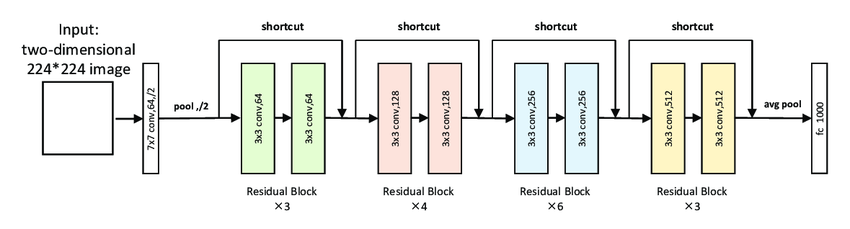

In [ ]:
import tensorflow as tf
from tensorflow.keras.layers import Input, Conv2D, BatchNormalization, Activation, Add, MaxPooling2D, GlobalAveragePooling2D, Dense
from tensorflow.keras.models import Model

def residual_block(inputs, filters, kernel_size=3, stride=1):
    x = Conv2D(filters, kernel_size, strides=stride, padding='same')(inputs)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(filters, kernel_size, strides=1, padding='same')(x)
    x = BatchNormalization()(x)

    if stride != 1 or inputs.shape[-1] != filters: # ensure the two path has the same dimension before adding
        inputs = Conv2D(filters, 1, strides=stride, padding='same')(inputs)
        inputs = BatchNormalization()(inputs)

    x = Add()([x, inputs])
    x = Activation('relu')(x)
    return x

def build_resnet34(input_shape=(224, 224, 3), num_classes=1000):
    inputs = Input(shape=input_shape)

    # Initial blocks
    x = Conv2D(64, 7, strides=2, padding='same')(inputs)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    x = MaxPooling2D(3, strides=2, padding='same')(x)

    # Residual Block
    filters = [64, 128, 256, 512]
    blocks = [3, 4, 6, 3]  # ResNet-34 residual block numbers

    for i, (f, b) in enumerate(zip(filters, blocks)): #[(0, (64, 3)), (1, (128, 4)), (2, (256, 6)), (3, (512, 3))]
        for j in range(b):
            stride = 2 if j == 0 and i != 0 else 1
            x = residual_block(x, f, stride=stride)

    # global pooling and fully connected layer
    x = GlobalAveragePooling2D()(x)
    outputs = Dense(num_classes, activation='softmax')(x)

    model = Model(inputs, outputs)
    return model

# ResNet-34 Model
resnet34 = build_resnet34(input_shape=(224, 224, 3), num_classes=1000)
resnet34.summary()


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.resnet50 import preprocess_input, decode_predictions
import numpy as np

# ResNet-50
model = ResNet50(weights='imagenet')

#
img_path = 'elephant.jpg'
img = image.load_img(img_path, target_size=(224, 224))
x = image.img_to_array(img)
x = np.expand_dims(x, axis=0)
x = preprocess_input(x)


preds = model.predict(x)

# decode the results into a list of tuples (class, description, probability)
print('Predicted:', decode_predictions(preds, top=3)[0])




---



> **Inception Network**

* Before, let's imagine a 1$×$1 filter, what can it be done?

1. **Dimensionality Reduction and Expansion (DRE) of channel dimensions**

  By adjusting the number of output channels of 1x1 convolution, the channel dimension of the feature map can be effectively **reduced** (computation and consumption) or **increased**(channel number and model performance).

  Example:

  In ResNet's Bottleneck Architecture, 1x1 convolution is used for dimensionality reduction, followed by 3x3 convolution and then dimensionality increase. This design effectively reduces the number of parameters and computational complexity of the model.

2. **Implementing Network-In-Network Structures**

  This approach is equivalent to applying a small fully-connected network at each pixel point, thus improving the expressive power of the model.

  Example: In GoogLeNet (Inception-v1), 1x1 convolution is used to downscale the feature map before performing 3x3 or 5x5 convolution, reducing the amount of computation while preserving key information.

5. **Implementing Depthwise Separable Convolutions**

  In Depthwise Separable Convolution, 1x1 convolution is used for pointwise convolution of channels, combined with channel-by-channel Depthwise Convolution to further reduce model parameters and computation.

  Example:
  
  MobileNet uses Depthwise Convolution where the 1x1 Convolution is responsible for mixing information across channels, significantly reducing the computational complexity of the model for mobile and embedded devices.


* **Motivation for Inception network**

Input Dimensions:
- **Input Tensor**: $ 28 \times 28 \times 192 $

Inception Module:

The Inception Module processes the input tensor in multiple parallel branches with different filter sizes and pooling operations. Each branch extracts different types of features from the input tensor.

Parallel Branches:

1. **$ 1 \times 1 $ Convolution**:
   - **Output Dimensions**: $28 \times 28 \times 64 $
   
2. **$ 3 \times 3 $ Convolution** (Padding = "Same"):
   - **Output Dimensions**: $ 28 \times 28 \times 128 $
   
3. **$ 5 \times 5 $ Convolution** (Padding = "Same"):
   - **Output Dimensions**: $ 28 \times 28 \times 32 $
   
4. **Max Pooling** (Padding = "Same", Stride = 1):
   - **Output Dimensions**: $ 28 \times 28 \times 32 $ (With extra 1$×$1 to change the channel number)

Output of Inception Module:

- The outputs from all branches are concatenated along the depth (channel) dimension.
- **Concatenated Output Dimensions**:
  - $
  28 \times 28 \times (64 + 128 + 32 + 32) = 28 \times 28 \times 256
  $

Explanation:
- The Inception Module helps the network to learn different types of features at multiple scales.
- The module takes the input tensor ($28 \times 28 \times 192 $) and processes it through multiple branches:
  - **$ 1 \times 1 $** convolution to reduce dimensionality and capture fine-grained details.
  - **$ 3 \times 3 $** and **$ 5 \times 5 $** convolutions to capture spatial patterns of varying sizes.
  - **Max Pooling** to capture dominant features while reducing spatial dimensions.
- Finally, the concatenated output from each branch is stacked together, resulting in an output tensor of shape **$ 28 \times 28 \times 256 $**.



In [ ]:
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, Input
from tensorflow.keras.models import Model

# 定义输入层
input_layer = Input(shape=(32, 32, 256))  # 32x32大小，256个通道

# 1x1卷积用于降维到64个通道
conv1x1 = Conv2D(filters=64, kernel_size=(1, 1), padding='same', activation='relu')(input_layer)

# 创建模型
model = Model(inputs=input_layer, outputs=conv1x1)
model.summary()


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 32, 32, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d (Conv2D)                      │ (None, 32, 32, 64)          │          16,448 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 16,448 (64.25 KB)

 Trainable params: 16,448 (64.25 KB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
from tensorflow.keras.layers import Add, BatchNormalization, Activation

def bottleneck_block(inputs, filters, stride=1):
    # 1x1卷积降维
    x = Conv2D(filters, (1, 1), strides=stride, padding='same')(inputs)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    # 3x3卷积
    x = Conv2D(filters, (3, 3), padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    # 1x1卷积升维
    x = Conv2D(filters * 4, (1, 1), padding='same')(x)
    x = BatchNormalization()(x)

    # 跳跃连接
    if stride != 1 or inputs.shape[-1] != filters * 4:
        shortcut = Conv2D(filters * 4, (1, 1), strides=stride, padding='same')(inputs)
        shortcut = BatchNormalization()(shortcut)
    else:
        shortcut = inputs

    # 相加
    x = Add()([x, shortcut])
    x = Activation('relu')(x)
    return x

# 定义输入层
input_layer = Input(shape=(56, 56, 256))

# 添加一个瓶颈残差块
block = bottleneck_block(input_layer, filters=64, stride=2)

# 创建模型
model = Model(inputs=input_layer, outputs=block)
model.summary()


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_1             │ (None, 56, 56, 256)    │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_1 (Conv2D)         │ (None, 28, 28, 64)     │         16,448 │ input_layer_1[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization       │ (None, 28, 28, 64)     │            256 │ conv2d_1[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation (Activation)   │ (None, 28, 28, 64)     │              0 │ batch_normalization[0… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_2 (Conv2D)         │ (None, 28, 28, 64)     │         36,928 │ activation[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_1     │ (None, 28, 28, 64)     │            256 │ conv2d_2[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_1 (Activation) │ (None, 28, 28, 64)     │              0 │ batch_normalization_1… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_3 (Conv2D)         │ (None, 28, 28, 256)    │         16,640 │ activation_1[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_4 (Conv2D)         │ (None, 28, 28, 256)    │         65,792 │ input_layer_1[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_2     │ (None, 28, 28, 256)    │          1,024 │ conv2d_3[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_3     │ (None, 28, 28, 256)    │          1,024 │ conv2d_4[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ add (Add)                 │ (None, 28, 28, 256)    │              0 │ batch_normalization_2… │
│                           │                        │                │ batch_normalization_3… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_2 (Activation) │ (None, 28, 28, 256)    │              0 │ add[0][0]              │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 138,368 (540.50 KB)

 Trainable params: 137,088 (535.50 KB)

 Non-trainable params: 1,280 (5.00 KB)

In [ ]:
from tensorflow.keras.layers import DepthwiseConv2D

def depthwise_separable_conv(inputs, pointwise_filters, depth_multiplier=1):
    # 深度卷积
    x = DepthwiseConv2D(kernel_size=(3, 3), padding='same', depth_multiplier=depth_multiplier)(inputs)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    # 逐点卷积（1x1卷积）
    x = Conv2D(pointwise_filters, (1, 1), padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    return x

# 定义输入层
input_layer = Input(shape=(112, 112, 32))

# 添加深度可分离卷积层
ds_conv = depthwise_separable_conv(input_layer, pointwise_filters=64, depth_multiplier=1)

# 创建模型
model = Model(inputs=input_layer, outputs=ds_conv)
model.summary()


Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_2 (InputLayer)           │ (None, 112, 112, 32)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ depthwise_conv2d (DepthwiseConv2D)   │ (None, 112, 112, 32)        │             320 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_4                │ (None, 112, 112, 32)        │             128 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ activation_3 (Activation)            │ (None, 112, 112, 32)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_5 (Conv2D)                    │ (None, 112, 112, 64)        │           2,112 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_5                │ (None, 112, 112, 64)        │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ activation_4 (Activation)            │ (None, 112, 112, 64)        │               0 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 2,816 (11.00 KB)

 Trainable params: 2,624 (10.25 KB)

 Non-trainable params: 192 (768.00 B)

* Why we use 1 $×$ 1 instead of  3$×$3  

**Because it is fast computing with less parameters and easy to adjust**




> **MobileNets**

* Low computational cost at deployment
* Useful for mobil and embedded vision applications
* Key idea: Normal vs. depthwise-separable convolutions

1. Depthwise Convolution

Convolute one layer by one:

Input: $n × n × n_c $

filter: $f × f $ (one filter)

Outputput: $n_o × n_o × n_c $

(Normally, we use $f × f × n_c$ filter and Output $n_o × n_o$)

2. Pointwise Convolution

Take the output from previous step:

Input: $n_o × n_o × n_c $

filter: $1 × 1 × n_c $ #number of filter = 5

Output: $n_o × n_o × 5 $

Adding the channel wise numbers

* **Comparing to normal convolution:**

Cost of Normal Convolution: 2160

Depthwise + pointwise: 432+240 = 672

672/2160 = 0.31



*   MobileNet V1

  With 13 times of the combination of Depthwise and pointwise layer and extra pool,fc,softmax as a whole structure
*   MobileNet V2

  With Residual Connection inside (Expansion+Depthwise+projection) 17 times and extra pool,fc,softmax as a whole structure

  * Bottleneck
  
      Illustration
  
      Input: n×n×3

      Expansion: 1 × 1 × 3 with number of 18

      ↓

      n × n × 18

      Depthwise: n × n × 18

      pointwise filter(projection): 1 × 1 × 18 with number of 3
      
      ↓

      n × n × 3

      * By expansion, increae the representation within the block, makes the performance richer
      * Due to it requires of high computation deploying on edge device, by projection, it can reduce the memory consumption







## Transfer Learning




Transfer Learning is a research problem in ML that focuses on storing knowledge gained while solving one problem and applying it to a different but related problem.

(E.g. knowledge gained while learning to recognize cars would apply when trying to recognize trucks)


In [ ]:
import numpy as np
import cv2

import PIL.Image as Image
import os

import matplotlib.pylab as plt

import tensorflow as tf
import tensorflow_hub as hub

from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential

In [ ]:
import tf_keras

mobilenet_v2 ="https://tfhub.dev/google/tf2-preview/mobilenet_v2/classification/4"
classifier_model = mobilenet_v2
IMAGE_SHAPE = (224, 224)

classifier = tf_keras.Sequential([
    hub.KerasLayer(classifier_model, input_shape=IMAGE_SHAPE+(3,))
])

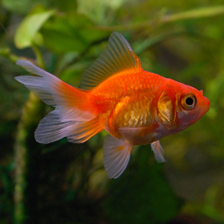

In [ ]:
gold_fish = Image.open('/content/drive/MyDrive/MD/Learning is Learning/pictures/goldfish.jpg').resize(IMAGE_SHAPE)
gold_fish

In [ ]:
gold_fish = np.array(gold_fish)/255.0
gold_fish.shape

(224, 224, 3)

In [ ]:
gold_fish[np.newaxis, ...].shape

(1, 224, 224, 3)

In [ ]:
result = classifier.predict(gold_fish[np.newaxis, ...])

1/1 [==============================] - 0s 25ms/step


In [ ]:
result.shape

(1, 1001)

In [ ]:
predict_label_index = np.argmax(result)
predict_label_index # the class label 2 is goldfish in

2

In [ ]:
with open('/content/drive/MyDrive/MD/Learning is Learning/pictures/ImageNetLabels.txt') as f:
  labels = f.read().splitlines()
labels[:5] # goldfish is 2

['background', 'tench', 'goldfish', 'great white shark', 'tiger shark']

In [ ]:
labels[predict_label_index]

'goldfish'

Flowers dataset

In [ ]:
dataset_url = "https://storage.googleapis.com/download.tensorflow.org/example_images/flower_photos.tgz"
data_dir = tf.keras.utils.get_file('flower_photos', origin=dataset_url,  cache_dir='.', untar=True)

228813984/228813984 ━━━━━━━━━━━━━━━━━━━━ 1s 0us/step


In [ ]:
import pathlib
data_dir = pathlib.Path(data_dir)
data_dir

PosixPath('datasets/flower_photos')

In [ ]:
list(data_dir.glob('*/*.jpg'))[:5]

[PosixPath('datasets/flower_photos/roses/4061451210_1650590c6a.jpg'),
 PosixPath('datasets/flower_photos/roses/8642943283_47e44d049d_m.jpg'),
 PosixPath('datasets/flower_photos/roses/16149016979_23ef42b642_m.jpg'),
 PosixPath('datasets/flower_photos/roses/19988406792_68201f76e3_n.jpg'),
 PosixPath('datasets/flower_photos/roses/410425647_4586667858.jpg')]

In [ ]:
image_count = len(list(data_dir.glob('*/*.jpg')))
print(image_count)

3670


In [ ]:
roses = list(data_dir.glob('roses/*'))
roses[:5]

[PosixPath('datasets/flower_photos/roses/4061451210_1650590c6a.jpg'),
 PosixPath('datasets/flower_photos/roses/8642943283_47e44d049d_m.jpg'),
 PosixPath('datasets/flower_photos/roses/16149016979_23ef42b642_m.jpg'),
 PosixPath('datasets/flower_photos/roses/19988406792_68201f76e3_n.jpg'),
 PosixPath('datasets/flower_photos/roses/410425647_4586667858.jpg')]

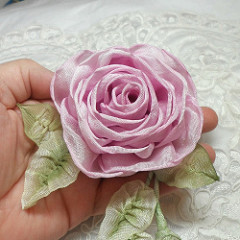

In [ ]:
import PIL
PIL.Image.open(str(roses[1]))

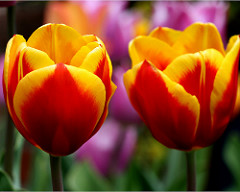

In [ ]:
tulips = list(data_dir.glob('tulips/*'))
PIL.Image.open(str(tulips[0]))

In [ ]:
flowers_images_dict = {
    'roses': list(data_dir.glob('roses/*')),
    'daisy': list(data_dir.glob('daisy/*')),
    'dandelion': list(data_dir.glob('dandelion/*')),
    'sunflowers': list(data_dir.glob('sunflowers/*')),
    'tulips': list(data_dir.glob('tulips/*')),
}

In [ ]:
flowers_labels_dict = {
    'roses': 0,
    'daisy': 1,
    'dandelion': 2,
    'sunflowers': 3,
    'tulips': 4,
}

In [ ]:
flowers_images_dict['roses'][:5]

[PosixPath('datasets/flower_photos/roses/4061451210_1650590c6a.jpg'),
 PosixPath('datasets/flower_photos/roses/8642943283_47e44d049d_m.jpg'),
 PosixPath('datasets/flower_photos/roses/16149016979_23ef42b642_m.jpg'),
 PosixPath('datasets/flower_photos/roses/19988406792_68201f76e3_n.jpg'),
 PosixPath('datasets/flower_photos/roses/410425647_4586667858.jpg')]

In [ ]:
str(flowers_images_dict['roses'][0])

'datasets/flower_photos/roses/4061451210_1650590c6a.jpg'

In [ ]:
img = cv2.imread(str(flowers_images_dict['roses'][0]))
img.shape

(333, 500, 3)

In [ ]:
cv2.resize(img,(224,224)).shape

(224, 224, 3)

In [ ]:
X, y = [], []

for flower_name, images in flowers_images_dict.items():
    for image in images:
        img = cv2.imread(str(image))
        resized_img = cv2.resize(img,(224,224))
        X.append(resized_img)
        y.append(flowers_labels_dict[flower_name])

In [ ]:
X = np.array(X)
y = np.array(y)

In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=0)

In [ ]:
X_train_scaled = X_train / 255
X_test_scaled = X_test / 255

In [ ]:
X[0].shape

(224, 224, 3)

In [ ]:
IMAGE_SHAPE+(3,)

(224, 224, 3)

In [ ]:
x0_resized = cv2.resize(X[0], IMAGE_SHAPE)
x1_resized = cv2.resize(X[1], IMAGE_SHAPE)
x2_resized = cv2.resize(X[2], IMAGE_SHAPE)
x0_resized.shape, x1_resized.shape, x2_resized.shape

((224, 224, 3), (224, 224, 3), (224, 224, 3))

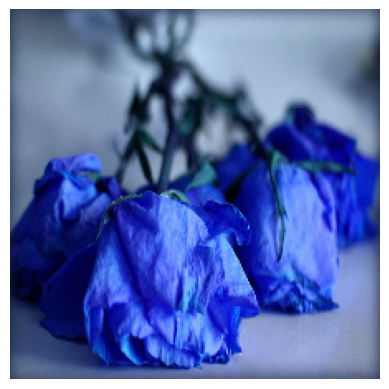

In [ ]:
plt.axis('off')
plt.imshow(X[0])

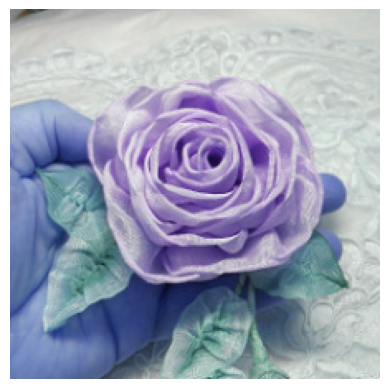

In [ ]:
plt.axis('off')
plt.imshow(X[1])

In [ ]:
predicted = classifier.predict(np.array([x0_resized,x1_resized,x2_resized]))

1/1 [==============================] - 0s 24ms/step


In [ ]:
predicted = np.argmax(predicted, axis=1)
predicted

array([795, 722, 722])

In [ ]:
labels[predicted[0]], labels[predicted[1]], labels[predicted[2]]

('shower curtain', 'pillow', 'pillow')

Use another model to extract the feature of the flowers

In [ ]:
feature_extractor_model = "https://tfhub.dev/google/tf2-preview/mobilenet_v2/feature_vector/4"

pretrained_model_without_top_layer = hub.KerasLayer(
    feature_extractor_model, input_shape=(224, 224, 3), trainable=False)

In [ ]:
num_of_flowers = 5

model = tf_keras.Sequential([
  pretrained_model_without_top_layer,
  tf_keras.layers.Dense(num_of_flowers)
])

model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer_5 (KerasLayer)  (None, 1280)              2257984   
                                                                 
 dense (Dense)               (None, 5)                 6405      
                                                                 
Total params: 2264389 (8.64 MB)
Trainable params: 6405 (25.02 KB)
Non-trainable params: 2257984 (8.61 MB)
_________________________________________________________________


In [ ]:
model.compile(
  optimizer="adam",
  loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
  metrics=['acc'])

model.fit(X_train_scaled, y_train, epochs=5)

Epoch 1/5
86/86 [==============================] - 5s 14ms/step - loss: 0.7625 - acc: 0.7188
Epoch 2/5
86/86 [==============================] - 1s 13ms/step - loss: 0.4001 - acc: 0.8605
Epoch 3/5
86/86 [==============================] - 1s 13ms/step - loss: 0.3109 - acc: 0.8961
Epoch 4/5
86/86 [==============================] - 1s 13ms/step - loss: 0.2596 - acc: 0.9150
Epoch 5/5
86/86 [==============================] - 1s 13ms/step - loss: 0.2233 - acc: 0.9328


In [ ]:
model.evaluate(X_test_scaled,y_test)

29/29 [==============================] - 1s 14ms/step - loss: 0.3820 - acc: 0.8671


[0.3819946348667145, 0.8671023845672607]

In [ ]:
predicted_1 = model.predict(X_test_scaled)

29/29 [==============================] - 1s 12ms/step


In [ ]:
a = tf.nn.softmax(predicted_1[0])
b = tf.nn.softmax(predicted_1[1])
c = tf.nn.softmax(predicted_1[2])

In [ ]:
np.argmax(a),np.argmax(b),np.argmax(c)

(1, 0, 2)

In [ ]:
y_test[0],y_test[1],y_test[2]

(1, 0, 2)

## RNN


Dense layer -> Recurrent networks



> **RNN:**



*   Language model: predict the next word

  * hello -> world   
  * hello world -> !

*   Use MLP naively doesn't handle sequence info well:
  * each time using a simple fully connected layer to do a softmax regression and classify;
  * The problem is as we do the first prediction which is hello -> world is quite good, but at the second time we predicting world -> ! it does not see the previous word (no hello for this time)
  * If we add hello before world, the length will change (We know that the size of the fully connected layer cannot be changed)
  * The key problem is the time series are ignored

*  RNN:
  * hello -> world remains the same, we assume that the output from the previous fully connect layer has not go into Softmax yet, it may contains the info of hello, copy this value and concat this with world, and repeat this process for the next predictions.
  * The info of hello we called it Hidden status which it can be passed backward and no matter how many steps it goes, the length/size does not change, and it will contains all the info that has been gone through.




> **RNN and Gated RNN**

* Simple RNN:

  we assue the hidden status from previous layer is $h_{t-1}$ and current layer at time t will also product $h_t$ to next layer.

  $$ h_t = f(W_{hh} h_{t-1} + W_{hx}x_t + b_h)$$
  $$
  y_t = g(W_{yh}h_t + b_y)
  $$
  (For simple RNN.the output $y_t = h_t$)

  Where f and g are activation functions, $W_{hh},W_{hx},W_{yh}$ are weights and $b_h,b_y$ are bias terms
  * It differents from MLP is that it add one more thing which takes the output from previous time as the input and multiplied with a weight parameter





```
opt = Optimizer(params = (W_hh,W_hx,W_yh,b_h,b_y))
h[0]=0
l = 0
for t=1,...,T:
  h[t] = f(W_hh @ h[t-1] + W_hx @ x[t] + b_h)
  y[t] = g(W_yh @ h[t] + b_y)
  l += Loss(y[t],y_star[t])
l.backward()
opt.step()
opt.zero_grad()
```



In [ ]:
class RNNScratch(d2l.Module):
    def __init__(self, num_inputs, num_hiddens, sigma=0.01):
        super().__init__()
        self.save_hyperparameters()
        self.W_xh = nn.Parameter(
            torch.randn(num_inputs, num_hiddens) * sigma)
        self.W_hh = nn.Parameter(
            torch.randn(num_hiddens, num_hiddens) * sigma)
        self.b_h = nn.Parameter(torch.zeros(num_hiddens))

* Gated RNN(LSTM,GRU): finer control of information flow

  * Forget input: suppress $x_t$ when computing $h_t$

    (suppress something not that important,like .,\, or the a an)

  * Forget past: suppress $h_{t-1}$ when computing $h_t$
    (something that so far away from now)

* LSTM

  Long short term memory cells are a particular form of hidden unit update that avoids the problem of vanilla RNNs

1. Divide the hidden unit into two components, called the hidden state and the cell state


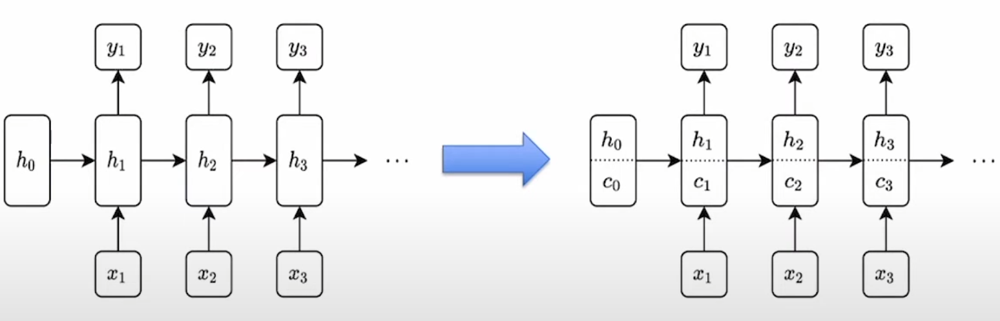

2. Use a very specific formula to update the hidden state and cell state

$$
\begin{bmatrix}
i_t \\
f_t \\
g_t \\
o_t
\end{bmatrix}
=
\begin{bmatrix}
sigmoid \\
sigmoid \\
\tanh \\
sigmoid
\end{bmatrix}
\left( W_{hh} h_{t-1} + W_{hx} x_t + b_h \right)
$$

$$
c_t = c_{t-1} \odot f_t + i_t \odot g_t
$$

$$
h_t = \tanh(c_t) \odot o_t
$$


Key points:
* We form $c_t$ by scaling down $c_{t-1}$(where $f_t$ is in $[0,1]^d$), then adding a term(where is in $[-1,1]^d$) to it

  (If $f_t$ is 0 it will ignore the previous states, otherwise will remember entirely past state)
* Importantly, "saturating" sigmoid activation for $f_t$ at 1 would just pass through $c_{t-1}$ untouched
* For a wider range of weights, LSTMs don not suffer vanishing gradients

In [ ]:
import torch
import torch.nn as nn
import numpy as np

In [ ]:
model = nn.LSTMCell(20,100)
print(model.weight_hh.shape)
print(model.weight_ih.shape)

torch.Size([400, 100])
torch.Size([400, 20])




> Single LSTM Cell



Applies a multi-layer long short-term memory (LSTM) RNN to an input sequence.

For each element in the input sequence, each layer computes the following function:

$$
i_t = \sigma(W_{ii} x_t + b_{ii} + W_{hi} h_{t-1} + b_{hi})
$$

$$
f_t = \sigma(W_{if} x_t + b_{if} + W_{hf} h_{t-1} + b_{hf})
$$

$$
g_t = \tanh(W_{ig} x_t + b_{ig} + W_{hg} h_{t-1} + b_{hg})
$$

$$
o_t = \sigma(W_{io} x_t + b_{io} + W_{ho} h_{t-1} + b_{ho})
$$

$$
c_t = f_t \odot c_{t-1} + i_t \odot g_t
$$

$$
h_t = o_t \odot \tanh(c_t)
$$


In [ ]:
def sigmoid(x):
  return 1/(1+np.exp(-x))

def lstm_cell(x,h,c,W_hh,W_ih,b):
  i,f,g,o = np.split(W_hh@h + W_ih@x + b, 4)
  i,f,g,o = sigmoid(i),sigmoid(f),np.tanh(g),sigmoid(o)
  c_out = f*c + i*g
  h_out = o*np.tanh(c_out)
  return h,c

In [ ]:
x = np.random.randn(1,20).astype(np.float32)
h_0 = np.random.randn(1,100).astype(np.float32)
c_0 = np.random.randn(1,100).astype(np.float32)

In [ ]:
h_, c_ = model(torch.tensor(x),(torch.tensor(h_0),torch.tensor(c_0)))

In [ ]:
h_.shape,c_.shape

(torch.Size([1, 100]), torch.Size([1, 100]))

In [ ]:
h,c = lstm_cell(x[0],h_0[0],c_0[0],model.weight_hh.detach().numpy(),model.weight_ih.detach().numpy(),(model.bias_hh+model.bias_ih).detach().numpy())



> Full sequence LSTM



In [ ]:
model = nn.LSTM(20,100,num_layers=1)

In [ ]:
X = np.random.randn(50,20).astype(np.float32)
h_0 = np.random.randn(1,100).astype(np.float32)
c_0 = np.random.randn(1,100).astype(np.float32)

In [ ]:
def lstm(X,h,c,w_hh,w_ih,b):
  H = np.zeros((X.shape[0],h.shape[0]))
  for t in range(X.shape[0]):
    h,c = lstm_cell(X[t],h,c,w_hh,w_ih,b)
    H[t] = h
  return H,c

In [ ]:
H,cn = lstm(X,h_0[0],c_0[0],model.weight_hh_l0.detach().numpy(),model.weight_ih_l0.detach().numpy(),(model.bias_hh_l0+model.bias_ih_l0).detach().numpy())

In [ ]:
H_,(hn_,cn_) = model(torch.tensor(X)[:,None,:],(torch.tensor(h_0)[:,None,:],torch.tensor(c_0)[:,None,:]))



> Train LSTMs



In [ ]:
opt = optim.SGD([W_hh,W_ih,b])

In [ ]:
def train_lstm(X,h0,c0,W_hh,W_ih,b,opt):
  H,cn = lstm(X,h0,c0,W_hh,W_ih,b)
  l = loss(H,Y)
  l.backward()
  opt.step()
  opt.zero_grad()

def train_deep_lstm(X,h0,c0,Y,W_hh,W_ih,b,opt):
  H = X
  depth = len(W_hh)
  for d in range(depth):
    H,cn = lstm(H,h0[d],c0[d],W_hh[d],W_ih[d],b[d])
    h0[d] = H[-1].detach().copy()
    c0[d] = cn.detach().copy()
  l = loss(H,Y)
  l.backward()
  opt.step()
  opt.zero_grad()

In [ ]:
h0,c0 = zeros(...)
for i in range(sequence_len // block_size):
  h0,c0 = train_deep_lstm(X[i*block_size:(i+1)*block_size],h0,c0,Y[i*block_size:(i+1)*block_size],W_hh,W_ih,b,opt)

NameError: name 'zeros' is not defined



> **Bi-RNN and Deep RNN**

* One direction -> Two directions

  Forward layer:
  put the info of previous moment to present

  Backward layer:
  put the info of t+1 to the direction of time t

  (Time t here is not the real time we understand, it is the **word sequence** in text)

  Combining the Forward and Backward layer as $y_t$

* Deep RNN

  Making multiple layers of RNN as MLP




> **Model Selection**




*   Tabular
  * Trees
  * Linear/MLP
*   Text/speech
  * RNNs
  * Transformers - which can deal with both timeseries info and spatial info
* Images/audio/video
  * CNNs
  * Transformers





> **Summary**

1. MLP:

A Multilayer Perceptron stacks multiple fully connected layers together, using activation layers to achieve a nonlinear model.

2. CNN (Convolutional Neural Network):

A Convolutional Neural Network can be seen as a specialized form of fully connected layers. The convolutional layers utilize spatial locality and translation invariance, simplifying the fully connected layers.

With fewer parameters, CNNs are better suited for processing image information. By stacking convolutional layers and pooling layers, an efficient model for capturing spatial information can be constructed.

3. RNN (Recurrent Neural Network):

A Recurrent Neural Network can be viewed as fully connected layers that incorporate past information into the present. By adding an extra edge to the fully connected layer, we obtain a recurrent neural network capable of processing data with temporal sequences.




---



## GAN



Unlike supervised classification setting, the "goal" is less obvious

To build effective training mechanism, we need to define a "distance" between generated and real datasets and use that to drive the training


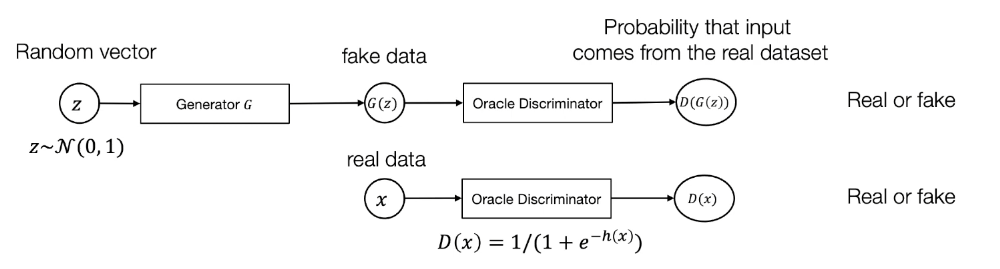

Assume that we have an oracle discriminator that can tell the difference between real and fake data. Then we need train the generator to "fool" the oracle discriminator. We need to maximize the discriminator loss:

$$
\text Generator\space objective: max_{G}
\{-E_{z～Noise} log(1-D(G(z)))\}
$$

Where $D(G(z))$ is the probability that $\hat{y}$ =1

We do not have an oracle discriminator, but we can learn it using the real and generated fake data

Discriminator Objective:
$$
min_{D}\{-E_{x～Data} log(D(x))-E_{z～Noise} log(1-D(G(z)))\}
$$

Putting it together, it becomes an "MinMax" game between D and G:

$$
min_{D}max_{G}\{-E_{x～Data} log(D(x))-E_{z～Noise} log(1-D(G(z)))\}
$$



Iterative process:
* Discriminator update
  * Sample minbatch of D(G(z))(generated fake data), get a minibatch of D(x) (real data)
  * Update D to minimize $min_{D}\{-E_{x～Data} log(D(x))-E_{z～Noise} log(1-D(G(z)))\}$
* Generator update
  * Sample minibatch of D(G(z))
  * Update G to minimize $max_{G}\{-E_{z～Noise} log(1-D(G(z)))\}$, this can be done by feeding label=1 to the model

In [ ]:
class Generator(nn.Module):
  def __init__(self):
    super(Generator, self).__init__()

    def block(in_feat, out_feat, normalize=True):
      layers = [nn.Linear(in_feat, out_feat)]
      if normalize:
        layers.append(nn.BatchNorm1d(out_feat, 0.8))
      layers.append(nn.LeakyReLU(0.2, inplace=True))
      return layers

    self.model = nn.Sequential(
        *block(opt.latent_dim, 128, normalize=False),
        #block returns a list of layers
        # The * unpacks that list so that its individual elements (the layers) are passed as separate arguments to nn.Sequential
        *block(128, 256),
        *block(256, 512),
        *block(512, 1024),
        nn.Linear(1024, int(np.prod(img_shape))),#img_shape * image_shape
        nn.Tanh()
    )

  def forward(self, z):
    img = self.model(z)
    img = img.view(img.size(0), *img_shape)
    return img

In [ ]:
class Discriminator(nn.Module):
  def __init__(self):
    super(Discriminator, self).__init__()

    self.model = nn.Sequential(
        nn.Linear(int(np.prod(img_shape)), 512),
        nn.LeakyReLU(0.2, inplace=True),
        nn.Linear(512, 256),
        nn.LeakyReLU(0.2, inplace=True),
        nn.Linear(256, 1),
        nn.Sigmoid(),
    )

    def forward(self, img):
    img_flat = img.view(img.size(0), -1)
    validity = self.model(img_flat)

    return validity

In [ ]:
for epoch in range(opt.n_epochs):
  for i, (imgs, _) in enumerate(dataloader):
    valid = Variable(Tensor(imgs.size(0), 1).fill_(1.0), requires_grad=False)
    fake = Variable(Tensor(imgs.size(0), 1).fill_(0.0), requires_grad=False)

In [ ]:
real_imgs = Variable(imgs.type(Tensor)) # real data

In [ ]:
real_loss = adversarial_loss(Discriminator(real_imgs), valid) # discriminate real data into real
fake_loss = adversarial_loss(Discriminator(gen_imgs.detach()), fake) # discriminate generated data in to fake
d_loss = (real_loss + fake_loss) / 2

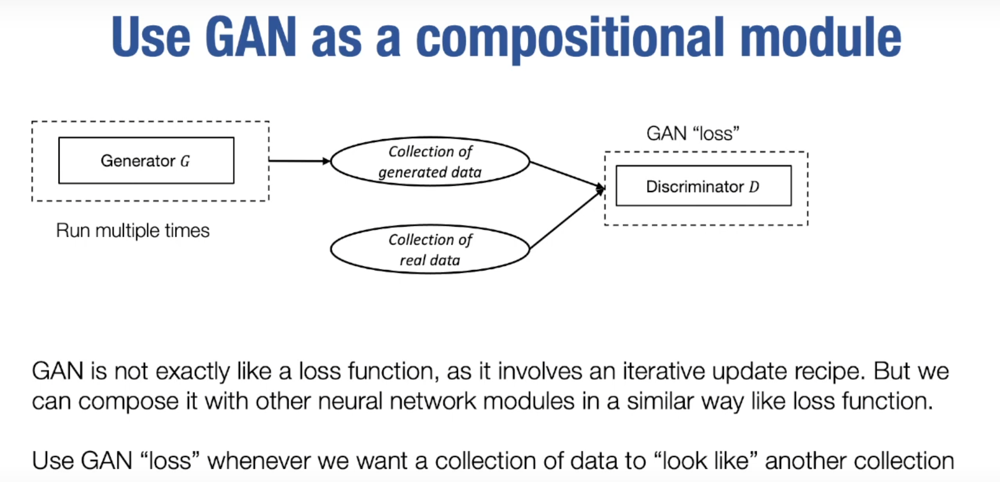

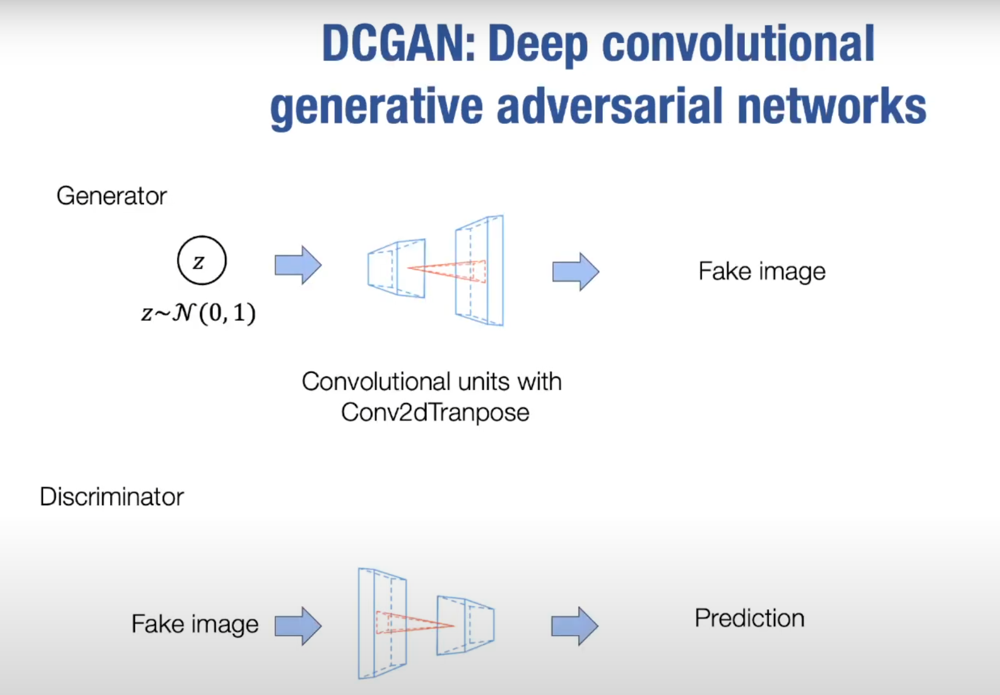

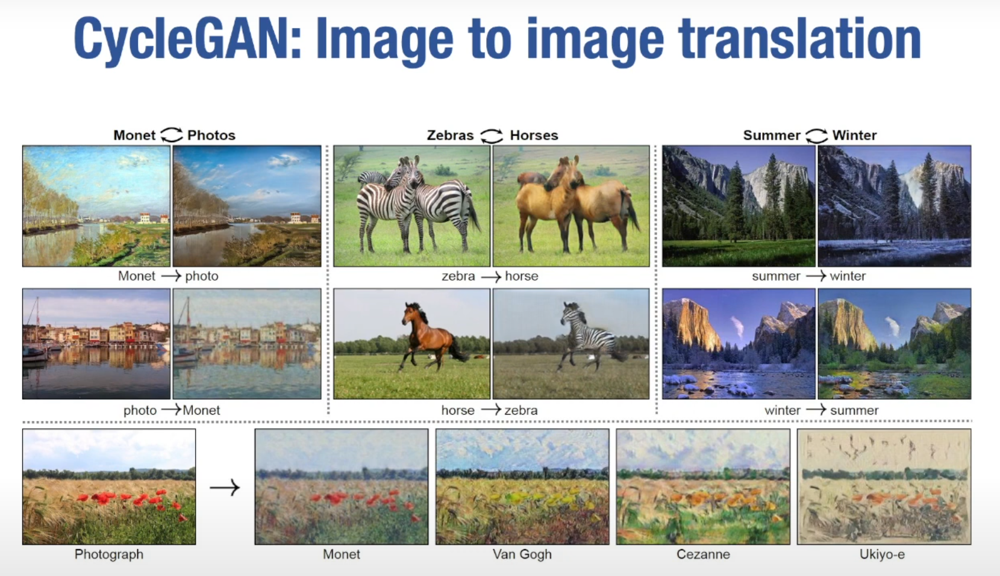

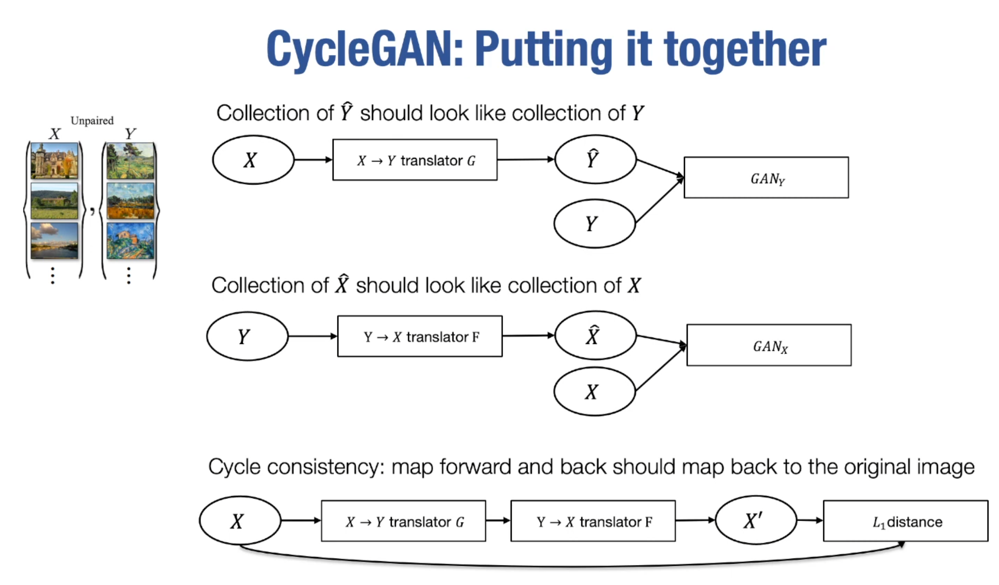

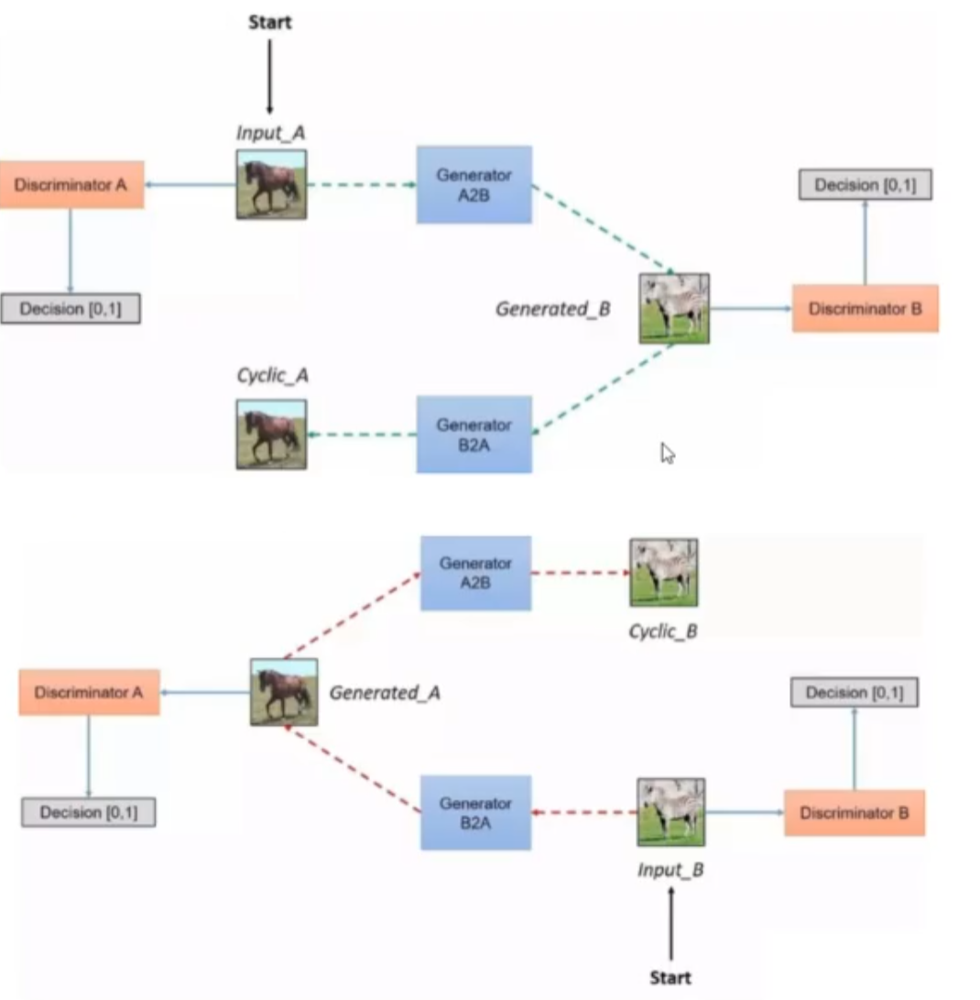

Generative Adversarial Networks introduce the idea of **game theory** which consist of two part:

1. Generator: generates fake data from random noise to decept discriminator
2. Discriminator: Discriminate the real data and the fake data generated

**Goal**
* As real as possible of the generated data
* Improve the ability of the discriminator to distinguish real and fake data

This two part adverse against each other to generate "real" data

## **NLP and LLMs**

### Word Representation



* **One-hot representation**
  * e.g. A [1,0,0,...,0] orange [0,0,...,1,0,...,1]
  * Drawbacks:
    * e.g. I want a glass of orange _____ (juice)
    
         I want a glass of apple ______

         (It can fill the juice for one sentence, but can not related to the second one as a highly similar one as well)

         Inner product between are 0!


* **Word Embedding**

$$
\begin{array}{|c|c|c|c|c|c|c|}
\hline
 & \textbf{Man (5391)} & \textbf{Woman (9853)} & \textbf{King (4914)} & \textbf{Queen (7157)} & \textbf{Apple (456)} & \textbf{Orange (6257)} \\
\hline
\text{Gender} & -1 & 1 & -0.95 & 0.97 & 0.00 & 0.01 \\
\hline
\text{Royal} & 0.01 & 0.02 & 0.93 & 0.95 & -0.01 & 0.00 \\
\hline
\text{Age} & 0.03 & 0.02 & 0.70 & 0.69 & 0.03 & -0.02 \\
\hline
\text{Food} & 0.04 & 0.01 & 0.02 & 0.01 & 0.95 & 0.97 \\
\hline
\end{array}
$$

Where the vector for Man could be: [-1,0.01,0.03,0.04,...]

You can find that Apple and Orange has similar vector. Allow algorithm to generalizing more across.


    

  * How can we do Man -> Woman as King ->?
  
  $e_{man} - e_{woman} = [-2,0,0,0]$

  $e_{king} - e_{queen} = [-2,0,0,0]$

  So the algorithms is to find
  $e_{man} - e_{woman} ≈ e_{King} - e_{?}$

  make this equation stands

 **To be generalize:**

  Find word w which
  $$
  argmax \ \text{cos_sim}(e_{w},e_{King}-e_{man}+e_{woman})
  $$

  Where $\text{cos_sim}(e_{w},e_{King}-e_{man}+e_{woman})$ os callled **Cosine similarity**

  $$
  \text{cos_sim}(\mathbf{u}, \mathbf{v}) = \frac{\mathbf{u}^T \mathbf{v}}{\|\mathbf{u}\|_2 \|\mathbf{v}\|_2}
  $$
  Which indicates the similarity (Inner product) between each vector

  It can be able to do this:

  Man:Woman as Boy:Girl

  Big:Bigger as Tall:Taller

In [ ]:
import numpy as np
from tensorflow.keras.preprocessing.text import one_hot
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense,Flatten,Embedding

In [ ]:
reviews = [
    'nice food',
    'amazing restaurant',
    'too good',
    'just loved it!',
    'will go again',
    'horrible food',
    'never go there',
    'poor service',
    'poor equality',
    'needs improvement'
]

sentiment = np.array([1,1,1,1,1,0,0,0,0,0])

In [ ]:
one_hot('amazing restaurant',30)

[27, 18]

In [ ]:
vocab_size = 50

encoded_reviews = [one_hot(d,vocab_size) for d in reviews]
encoded_reviews

[[39, 29],
 [18, 1],
 [36, 4],
 [34, 38, 29],
 [17, 43, 5],
 [40, 29],
 [8, 43, 47],
 [40, 31],
 [40, 32],
 [5, 15]]

In [ ]:
max_length=3

padded_reviews = pad_sequences(encoded_reviews,maxlen=max_length,padding='post')
padded_reviews

array([[39, 29,  0],
       [18,  1,  0],
       [36,  4,  0],
       [34, 38, 29],
       [17, 43,  5],
       [40, 29,  0],
       [ 8, 43, 47],
       [40, 31,  0],
       [40, 32,  0],
       [ 5, 15,  0]], dtype=int32)

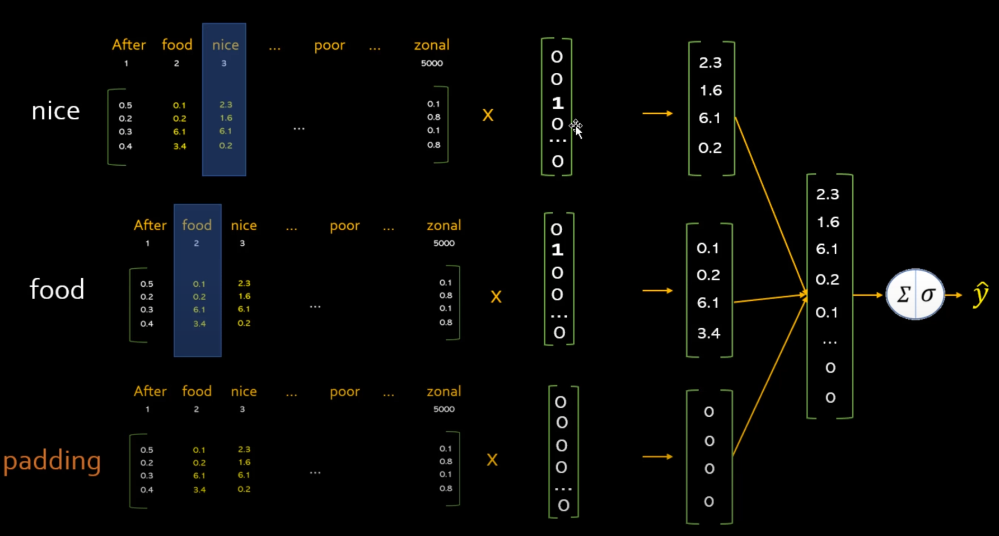

In [ ]:
embeded_vector_size = 5

model = Sequential()
model.add(Embedding(vocab_size,embeded_vector_size,input_length=max_length,name='embedding'))
model.add(Flatten())
model.add(Dense(1,activation='sigmoid'))

/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/embedding.py:90: UserWarning: Argument `input_length` is deprecated. Just remove it.
  warnings.warn(


In [ ]:
X = padded_reviews
y = sentiment

In [ ]:
model.compile(optimizer='adam',loss='binary_crossentropy',metrics=['accuracy'])
model.summary()

Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ embedding (Embedding)                │ ?                           │     0 (unbuilt) │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_2 (Flatten)                  │ ?                           │     0 (unbuilt) │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ ?                           │     0 (unbuilt) │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 0 (0.00 B)

 Trainable params: 0 (0.00 B)

 Non-trainable params: 0 (0.00 B)

In [ ]:
model.fit(X,y,epochs=50,verbose=0)

In [ ]:
loss,accuracy = model.evaluate(X,y)
accuracy

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step - accuracy: 1.0000 - loss: 0.5904


1.0

In [ ]:
weights = model.get_layer('embedding').get_weights()[0]

In [ ]:
weights[39] # nice

array([ 0.06270808,  0.05802705,  0.0380394 , -0.09941413,  0.08441348],
      dtype=float32)

In [ ]:
weights[18] #amazing

array([ 0.00439606,  0.05456872,  0.02484024, -0.04673329,  0.09086044],
      dtype=float32)

 * **Embedding matrix**

Say we having a matrix with $ 300 × 10,000$ which 10,000 stands for the dictionary as previou, we call the matrix as $E$

And we still having a vector $ 10,000 × 1$ stands for the words vector in dictonary as $o$

We have $$ E * o_{j} = e_{j} $$
Where $e_{j}$ stands for the embedding for word j

It finds the j column in E as $e_{j}$




Example:

I want a glass of orange juice to go along with my cereal.

Target -> juice

Context:
  
  * Last 4 words
  * 4 words on left & right
  * Last 1 word
  * Nearby 1 word (e.g. glass)

Use these context to fit the network

* **Word2Vec**

  1. ***CBOW***

    I want a glass of orange juice to go along with my cereal.

    Context: randomly choose (e.g. glass of ____ juice)

    Target: randomly choose (e.g. orange)

  
  * Model

    Vocab size = 10,000k
      
    Context c ('glass of ____ juice') → Target t ('orange')

  $$o_{c} → E → e_{c} → Softmax → y_{hat}$$

  $$ Softmax: p(t \mid c) = \frac{e^{\Theta_t^T e_c}}{\sum_{j=1}^{10,000} e^{\Theta_j^T e_c}}$$

| context | word | | target |
| --- | --- | --- | --- |
|orange| juice| → | 1|
|orange| king| → |0|
|orange| book| → |0|
|orange| the| → |0|
|orange| of| → |0|


  2. ***Skip-grams***

  Target t ('orange') → Context c ('glass of ____ juice')




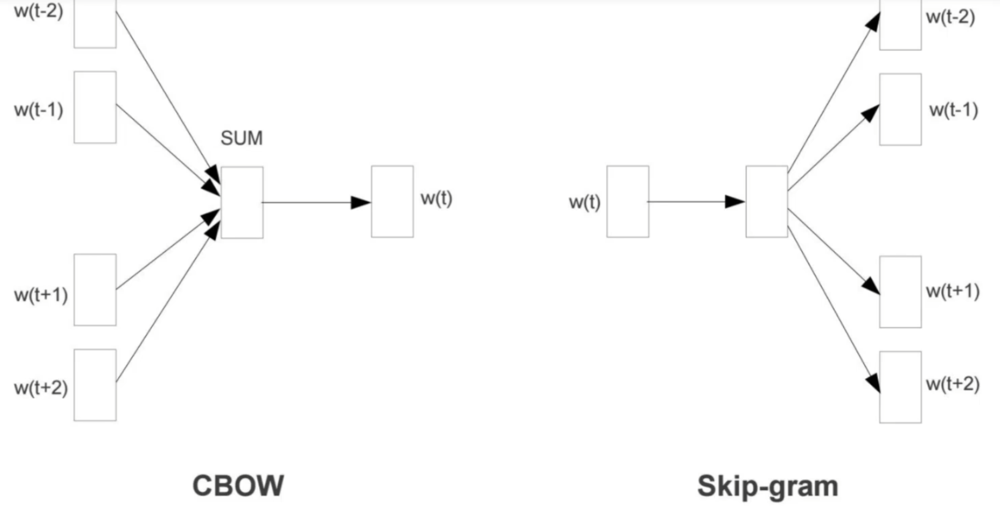

  * Optimizing methods

    1. Hierarchical Softmax

      Using Huffman tree to transform the prob of vocab into path prob, which reducing complexity
    2. Negative Sampling

    * Intuition:

      The softmax's computation work is massive, so we come up with ideas that not doing prediction task (input A, output B) but do some comparison task (input A,B to see are they sequential)

      But if we go through all the examples we find that maybe, there existing so many combinations of A,B so the output will be a huge list of 1

    * So, we have:

      e.g. choosing k negative samples and 1 positive sample for each iteration where having 10,000 samples

      So, not training 10,000 softmax but training 10,000 binary classification

       - much easier !!

In [ ]:
import gensim
import pandas as pd

In [ ]:
df = pd.read_json("Cell_Phones_and_Accessories_5.json", lines=True)
df

,reviewerID,asin,reviewerName,helpful,reviewText,overall,summary,unixReviewTime,reviewTime
0,A30TL5EWN6DFXT,120401325X,christina,"[0, 0]",They look good and stick good! I just don't li...,4,Looks Good,1400630400,"05 21, 2014"
1,ASY55RVNIL0UD,120401325X,emily l.,"[0, 0]",These stickers work like the review says they ...,5,Really great product.,1389657600,"01 14, 2014"
2,A2TMXE2AFO7ONB,120401325X,Erica,"[0, 0]",These are awesome and make my phone look so st...,5,LOVE LOVE LOVE,1403740800,"06 26, 2014"
3,AWJ0WZQYMYFQ4,120401325X,JM,"[4, 4]",Item arrived in great time and was in perfect ...,4,Cute!,1382313600,"10 21, 2013"
4,ATX7CZYFXI1KW,120401325X,patrice m rogoza,"[2, 3]","awesome! stays on, and looks great. can be use...",5,leopard home button sticker for iphone 4s,1359849600,"02 3, 2013"
...,...,...,...,...,...,...,...,...,...
194434,A1YMNTFLNDYQ1F,B00LORXVUE,eyeused2loveher,"[0, 0]",Works great just like my original one. I reall...,5,This works just perfect!,1405900800,"07 21, 2014"
194435,A15TX8B2L8B20S,B00LORXVUE,Jon Davidson,"[0, 0]",Great product. Great packaging. High quality a...,5,Great replacement cable. Apple certified,1405900800,"07 21, 2014"
194436,A3JI7QRZO1QG8X,B00LORXVUE,Joyce M. Davidson,"[0, 0]","This is a great cable, just as good as the mor...",5,Real quality,1405900800,"07 21, 2014"
194437,A1NHB2VC68YQNM,B00LORXVUE,Nurse Farrugia,"[0, 0]",I really like it becasue it works well with my...,5,I really like it becasue it works well with my...,1405814400,"07 20, 2014"


In [ ]:
df.shape

(194439, 9)

In [ ]:
df.reviewText[0]

"They look good and stick good! I just don't like the rounded shape because I was always bumping it and Siri kept popping up and it was irritating. I just won't buy a product like this again"

In [ ]:
gensim.utils.simple_preprocess("They look good and stick good! I just don't like the rounded shape because I was always bumping it and Siri kept popping up and it was irritating. I just won't buy a product like this again")

['they',
 'look',
 'good',
 'and',
 'stick',
 'good',
 'just',
 'don',
 'like',
 'the',
 'rounded',
 'shape',
 'because',
 'was',
 'always',
 'bumping',
 'it',
 'and',
 'siri',
 'kept',
 'popping',
 'up',
 'and',
 'it',
 'was',
 'irritating',
 'just',
 'won',
 'buy',
 'product',
 'like',
 'this',
 'again']

In [ ]:
review_text = df.reviewText.apply(gensim.utils.simple_preprocess)

In [ ]:
review_text

,reviewText
0,"[they, look, good, and, stick, good, just, don..."
1,"[these, stickers, work, like, the, review, say..."
2,"[these, are, awesome, and, make, my, phone, lo..."
3,"[item, arrived, in, great, time, and, was, in,..."
4,"[awesome, stays, on, and, looks, great, can, b..."
...,...
194434,"[works, great, just, like, my, original, one, ..."
194435,"[great, product, great, packaging, high, quali..."
194436,"[this, is, great, cable, just, as, good, as, t..."
194437,"[really, like, it, becasue, it, works, well, w..."


In [ ]:
model_w2v = gensim.models.Word2Vec(
    window=10,
    min_count=2,
    workers=4
)

In [ ]:
model_w2v.build_vocab(review_text,progress_per=1000)

In [ ]:
model_w2v.train(review_text,total_examples=model_w2v.corpus_count,epochs=model_w2v.epochs)

(61505800, 83868975)

In [ ]:
model_w2v.wv.most_similar("bad")

[('terrible', 0.6798882484436035),
 ('shabby', 0.6253989934921265),
 ('horrible', 0.6220245957374573),
 ('good', 0.5922727584838867),
 ('awful', 0.5583803653717041),
 ('legit', 0.5490954518318176),
 ('poor', 0.5427694320678711),
 ('okay', 0.5309754610061646),
 ('crappy', 0.5307101607322693),
 ('cheap', 0.5183085799217224)]

In [ ]:
model_w2v.wv.similarity(w1="cheap",w2="inexpensive")

0.53293544



---



In [ ]:
from gensim.models import Word2Vec
from nltk.tokenize import word_tokenize
import nltk

# 下载punkt分词器
nltk.download('punkt')

# 示例语料库
corpus = [
    "The quick brown fox jumps over the lazy dog",
    "I love natural language processing",
    "Word embeddings are useful for many NLP tasks",
    "Deep learning models like Skip-Gram can capture semantic relationships"
]

# 预处理：分词
tokenized_corpus = [word_tokenize(sentence.lower()) for sentence in corpus]

# 训练Skip-Gram模型
model = Word2Vec(
    sentences=tokenized_corpus,
    vector_size=100,      # 词向量维度
    window=5,            # 上下文窗口大小
    min_count=1,         # 忽略词频小于min_count的词
    sg=1,                # 1表示使用Skip-Gram，0表示使用CBOW
    workers=4,           # 并行训练的线程数
    epochs=100           # 训练轮次
)

# 保存模型
model.save("skipgram.model")


[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


In [ ]:
# 加载模型
model = Word2Vec.load("skipgram.model")

# 查看词向量
word = 'language'
print(f"Vector for '{word}':\n{model.wv[word]}")

# 查找最相似的词
similar_words = model.wv.most_similar('language', topn=3)
print(f"Words similar to 'language':\n{similar_words}")

# 示例输出：
# Vector for 'language':
# [ 0.001234, -0.003456, ..., 0.005678]
# Words similar to 'language':
# [('processing', 0.75), ('natural', 0.68), ('nlp', 0.65)]


Vector for 'language':
[ 9.8801060e-03 -9.6670920e-03 -6.4146211e-03  2.8701804e-03
  6.4254925e-03 -5.5526290e-03  2.9798164e-03  9.5452825e-03
 -7.0695411e-03 -6.3052336e-03 -4.9735452e-03 -3.9229244e-03
  1.9871243e-03  9.9378154e-03  6.1701294e-03  4.6555526e-04
  3.0019854e-03  8.4347595e-03  8.9260107e-03  4.9663689e-03
  6.0459916e-03 -7.5409417e-03 -3.6721067e-03 -5.7232538e-03
  5.9844526e-03 -2.2344952e-03 -9.1131544e-03  7.6688048e-03
  8.4595131e-03 -3.2669392e-03  9.4447890e-03 -7.7056675e-04
 -3.5707715e-03 -6.2064524e-04  6.1344675e-05 -3.3624917e-03
  3.1047193e-03  5.6194994e-03  6.7424257e-03 -9.0883560e-03
 -2.1696454e-03 -5.6600114e-03  7.5755753e-03  6.5631997e-03
 -4.2815432e-03  2.1952465e-03 -6.3060503e-03 -6.6722678e-05
  9.6492665e-03 -2.4762207e-03 -5.2380734e-03 -7.5361263e-03
 -3.1039254e-03 -8.6830172e-04  3.5292567e-03  9.6875820e-03
 -3.2374281e-03  1.8596309e-03  9.6539054e-03  1.7225654e-03
  9.7851525e-04  9.5371511e-03  9.6040331e-03  7.9391981e-03
 

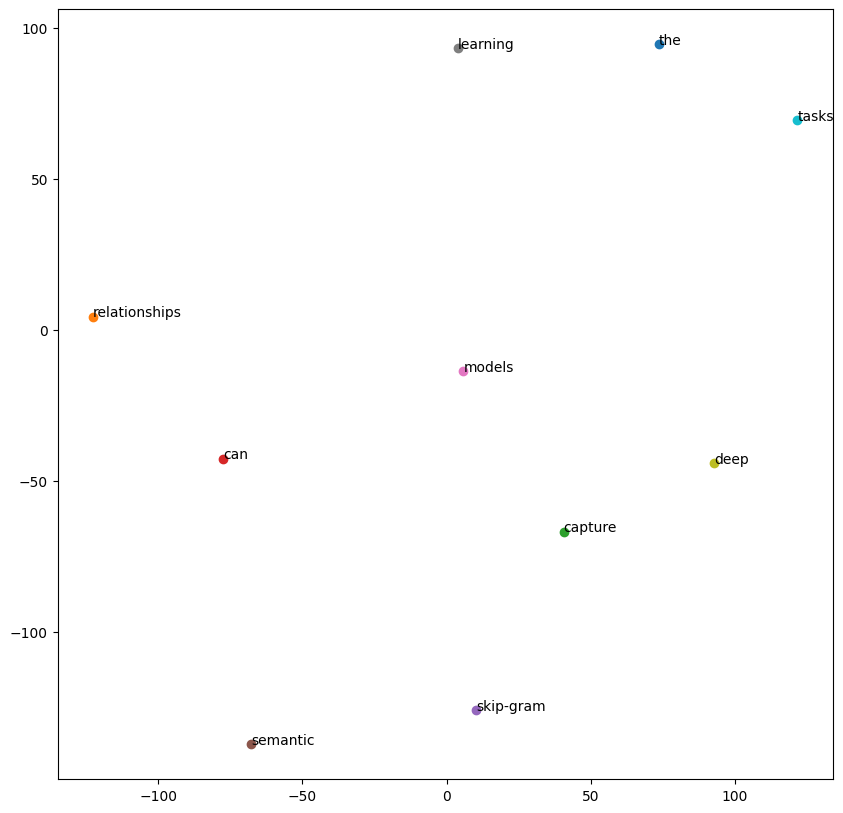

In [ ]:
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
import numpy as np

# 选择要可视化的词
words = list(model.wv.key_to_index)[:10]
word_vectors = [model.wv[word] for word in words]

# 将word_vectors转换为NumPy数组
word_vectors = np.array(word_vectors)

# 使用TSNE降维到2D, perplexity must be less than n_samples (10 in this case)
tsne = TSNE(n_components=2, random_state=0, perplexity=5)  # Set perplexity to 5 (or any value less than 10)
vectors_2d = tsne.fit_transform(word_vectors)

# 绘制
plt.figure(figsize=(10, 10))
for i, word in enumerate(words):
    plt.scatter(vectors_2d[i, 0], vectors_2d[i, 1])
    plt.annotate(word, (vectors_2d[i, 0], vectors_2d[i, 1]))
plt.show()

In [ ]:
from gensim.models import FastText

# 训练FastText模型
model_fasttext = FastText(
    sentences=tokenized_corpus,
    vector_size=100,
    window=5,
    min_count=1,
    sg=1,                # 1表示使用Skip-Gram，0表示使用CBOW
    workers=4,
    epochs=100
)

# 使用FastText模型
print(model_fasttext.wv['processing'])


[ 3.8572837e-04  1.3786202e-03 -4.3526999e-04  1.2539362e-03
 -8.2170696e-04  1.4919915e-03  2.2881695e-05 -6.4493698e-04
 -7.7514257e-04 -1.3275971e-04 -1.1873065e-03  2.1409310e-04
  4.2927777e-04  9.4857119e-04  1.5766923e-03  1.2522015e-04
 -1.0234058e-03 -1.4421707e-03  5.1298260e-04  1.8525419e-04
 -6.6466513e-04 -1.0018293e-03 -5.8132474e-04 -1.1076253e-03
 -1.2336150e-03 -2.5353272e-04  5.9524662e-04 -2.1565366e-04
  7.5983058e-05 -7.0437253e-04 -1.0003507e-04  1.2723466e-04
 -2.0872602e-04  4.1122310e-04 -5.0093420e-04 -2.9690724e-04
 -8.1927795e-04  7.4355351e-04 -9.9327974e-04  6.4171979e-04
  8.6167239e-04  4.0379982e-04  8.6398510e-04 -6.3562248e-04
 -3.2188627e-04  6.1052089e-04 -8.4870687e-04  7.2093256e-04
 -1.7028303e-03  1.3656162e-03 -1.1688734e-03  2.5885776e-03
 -3.0099871e-04  1.1424809e-03  8.6471642e-04  1.7183828e-04
 -2.6556914e-04 -8.5209077e-04 -1.1422228e-03  1.9399355e-04
 -8.8026427e-04  5.2683586e-06 -7.4509054e-04 -9.0863425e-05
 -6.4064504e-04 -1.41422

In [ ]:
from gensim.models import KeyedVectors

# 假设已下载预训练的GloVe向量，并转换为Word2Vec格式
glove_file = 'glove.6B.100d.word2vec.txt'
model_glove = KeyedVectors.load_word2vec_format(glove_file, binary=False)

# 使用GloVe模型
print(model_glove.most_similar('language', topn=3))


In [ ]:
from transformers import BertTokenizer, BertModel
import torch

# 加载预训练的BERT模型和分词器
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
model = BertModel.from_pretrained('bert-base-uncased')

# 编码输入文本
text = "Word2Vec is a popular word embedding technique."
inputs = tokenizer(text, return_tensors='pt')
outputs = model(**inputs)

# 获取词向量
word_embeddings = outputs.last_hidden_state
print(word_embeddings)


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


model.safetensors:   0%|          | 0.00/440M [00:00<?, ?B/s]

tensor([[[-0.2855, -0.3601, -0.2277,  ..., -0.3643, -0.2726,  0.7437],
         [ 0.0966, -0.1130, -0.1615,  ...,  0.0595,  0.5692,  0.4135],
         [ 0.6692, -0.8633,  0.2151,  ..., -0.5832,  0.1434,  0.4623],
         ...,
         [-0.2463,  0.4414, -0.3071,  ..., -0.5961, -0.6300,  0.3650],
         [ 0.7539,  0.2308, -0.5596,  ...,  0.1531, -0.4734, -0.1925],
         [ 0.0329,  0.1627, -0.1322,  ...,  0.5867, -0.6499, -0.2572]]],
       grad_fn=<NativeLayerNormBackward0>)




> **Sentiment classification**

| x | y |
| --- | --- |
|The dessert is excellent | ⋆⋆⋆⋆|
|Service quite good| ⋆⋆|
|Hppd fpr a quick meal, but nothing special| ⋆⋆⋆|
|Completely lacking in good taste| ⋆|

* Simple Model:

  *The dessert is excellent*

  Using embedding matrix:

  The → $e_{8928}$

  dessert → $e_{2469}$

  is → $e_{4694}$

  excellent → $e_{3180}$

  Averaging these
  
  $e_{8928} e_{2469} e_{4694} e_{3180} → Softmax → y_{hat} $


### Attention

Recall the RNN structure previously:

"Attention" in deep networks generally refers to any mechanism where individual states are weighted and then combined
(Where RNN only refers the last state)
$$
    z_t = \theta^T h_t^{(k)}
$$

$$
    w = softmax(z)
$$

$$
    \bar{h} = \sum_{t=1}^{T} w_t h_t^{(k)}
$$
Used originally in RNNs when one wanted to combine latent states over all times in a more general manner than "just" looking at the last state



> Self-Attention

Self-Attention is a mechanism that allows a neural network to weigh the importance of different elements within a sequence when computing representations. It's a fundamental component of the Transformer architecture, which has revolutionized fields like natural language processing and sequence modeling by enabling models to capture long-range dependencies more effectively.

Self-Attention refers to a particular form of attention mechanism

Given three inputs $K,Q,V \in \mathbb{R}^{T \times d}$ ("keys","queries","values", in one of the least-meaningful semantic designations we have in deep learning)

$$
K = \begin{bmatrix}
   \dots \mathbf{k}_1^T \dots\\
   \dots \mathbf{k}_2^T \dots\\
     \vdots \\
   \dots \mathbf{k}_T^T \dots
\end{bmatrix}
$$

$$
Q = \begin{bmatrix}
   \dots \mathbf{q}_1^T \dots\\
   \dots \mathbf{q}_2^T \dots\\
     \vdots \\
   \dots \mathbf{q}_T^T \dots
\end{bmatrix}
$$

$$
V = \begin{bmatrix}
   \dots \mathbf{v}_1^T \dots\\
   \dots \mathbf{v}_2^T \dots\\
     \vdots \\
   \dots \mathbf{v}_T^T \dots
\end{bmatrix}
$$

$$
X = \begin{bmatrix}
   \dots \mathbf{x}_1^T \dots\\
   \dots \mathbf{x}_2^T \dots\\
     \vdots \\
   \dots \mathbf{x}_T^T \dots
\end{bmatrix}
$$

$$
K = Xw_k
$$
$$
Q = Xw_q
$$
$$
V = Xw_v
$$


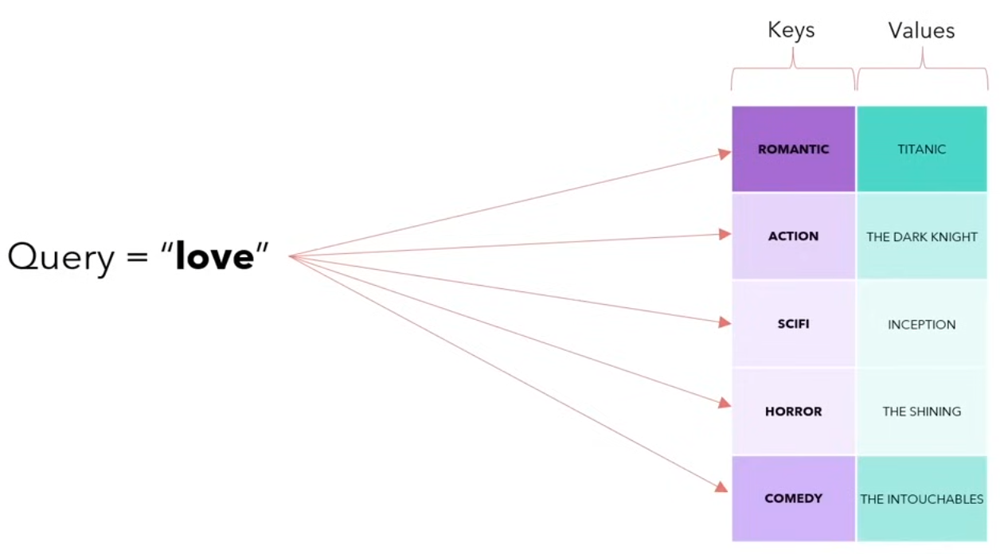

So, $K,Q,V$ are different mapping from Input Tokens to improve the feature expression

We define the self attention operation as

$$
SelfAttention(K,Q,V)= softmax(\frac{K Q^T}{\sqrt{d}})V
$$


$$
KQ^T = \begin{bmatrix}
   \dots \mathbf{k}_1^T q_j \dots\\
   \dots \mathbf{k}_2^T q_j\dots\\
     \vdots \\
   \dots \mathbf{k}_T^T q_j \dots
\end{bmatrix}
$$
1. $k_i^{T} q_j$

  Which is a T × T matrics computes *the similarity between K term and the J term* in some extent

  (This captures how much attention the model should pay to each position in the sequence when processing a particular element)

2. $softmax(K Q^T)$

  Then, softmax is apllied rowwise, which also a T × T matrics

  (This converts the scores into probabilities, highlighting the relative importance of each key for a given query)

3. $softmax(\frac{K Q^T}{\sqrt{d}})V$

  Finally, it becomes a T × d matrics with multiply with V

  (This means each output element at position i incorporates information from all positions in the sequence, weighted by their relevance to position i)

  * Note: when the dimension $d$ is large, it may existing $K Q^T$ has larger value, as it back propogating to previous params, may cause these params cannot get any update(**gradient vanishing**), so we need to divide it by $\sqrt{d}$
  to ensure the variance to be 1.

**So**

The each row of SelfAttention results is a linear combination of all the rows of v, in other words, it mixing together elements of different point of time

The self-attention mechanism allows the model to integrate information from all positions in the sequence for each output position.

This is particularly powerful for capturing dependencies regardless of their distance in the sequence

**Properties:**

* Invariant (really, equivariant) to permutatuons of K,Q,V matrices
  * If you shuffle the input sequence, the output sequence will shuffle correspondingly.
  * This property allows the model to focus on the content rather than the position.
* Allows influence between $k_t,q_t,v_t$ over all times
  * Each position in the output can attend to all positions in the input sequence.
  * This enables the model to capture long-range dependencies efficiently
* Compute cost is $O(T^2 + Td)$ (cannot be easily reduce due to nonlinearity applied to full T × T matrix)
  * The computation involves matrix multiplications and applying the softmax function over a T × T matrix.
  * The computational cost is O(T²d) due to the T × T attention matrix and subsequent operations.
  * This quadratic complexity can be a bottleneck for very long sequences.

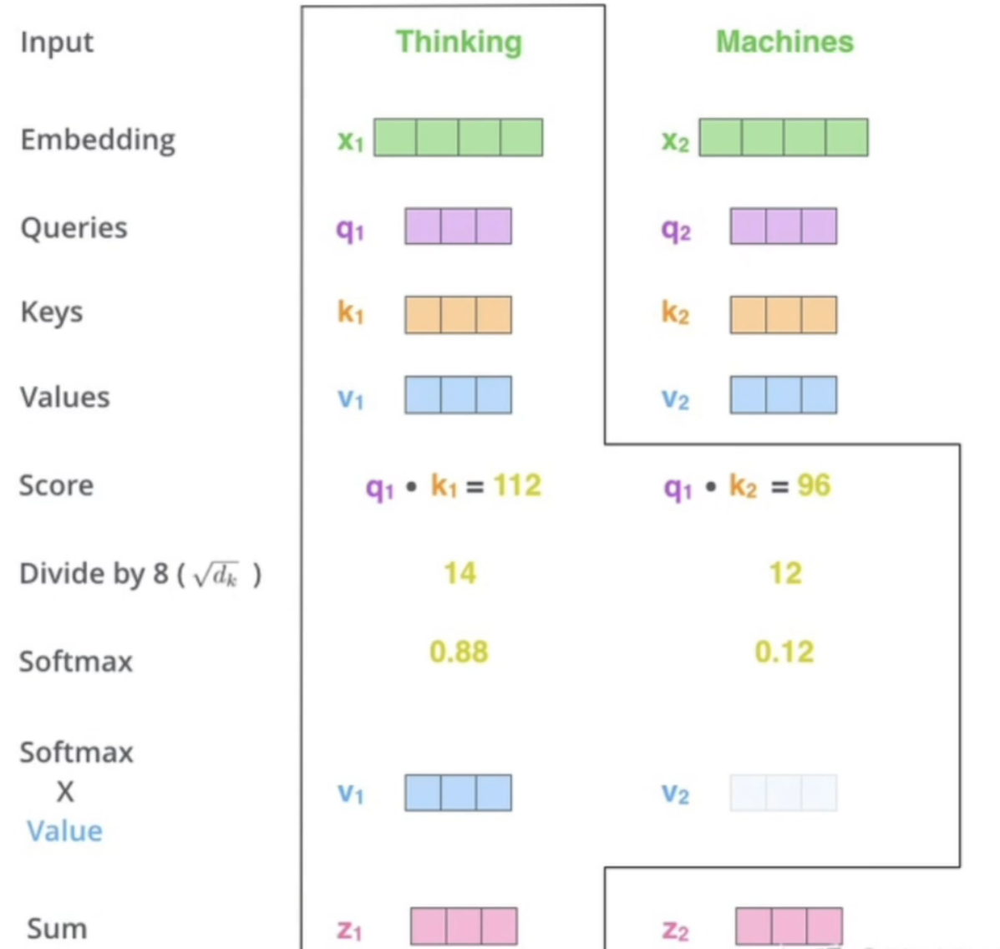

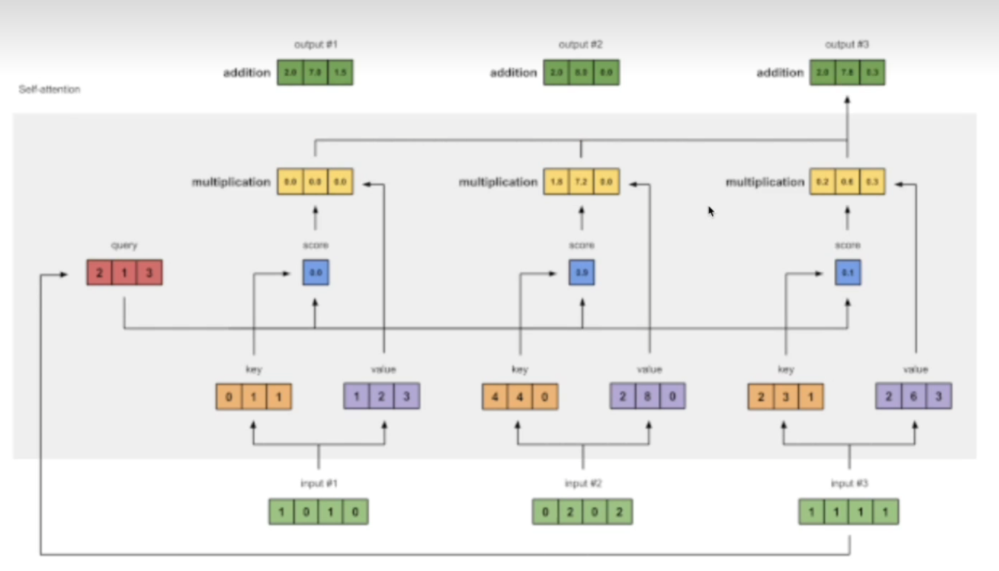

And, token are able to know which feature should be focused on

### Transformers

The Transformer architecture builds upon the self-attention mechanism to handle sequence-to-sequence tasks efficiently

$$
Z^{(i+1)} = Transformer(Z^{(i)})
$$

All time steps are processed in **parallel**, avoids the need for sequential processing as in RNNs

**Layer Structure**
$$
\bar{z_1}=SelfAttention(z^{(i)}w_k,z^{(i)}w_q,z^{(i)}w_v)
$$
$$
   =softmax(\frac{z^{(i)}w_kw_q^Tz^{(i)}}{\sqrt{d}})z^{{i}}w_v
$$
$$
\bar{z_2} = LayerNorm(z^{(i)}+\bar{z_1})
$$

$$
z^{(i+1)} = LayerNorm(\bar{z_2}+ReLu(\bar{z_2}w_1)w_2)
$$

1. *Multi-Head Self-Attention Layer*


Instead of computing a single attention function, the Transformer uses multiple attention "heads."

Each head learns to focus on different parts of the input representation space

For each attention head h = 1, ..., H:

$$
Q_h = X W_h^Q
$$
$$
K_h = X W_h^K
$$
$$
V_h = X W_h^V
$$
$$
\text{head}_h = \text{SelfAttention}(Q_h, K_h, V_h)
$$

Where each matrix of $Q,V,K  \in \mathbb{R}^{T \times d/h}$


$$
y = [head_1,head_2, …, head_n] w_{out}
$$

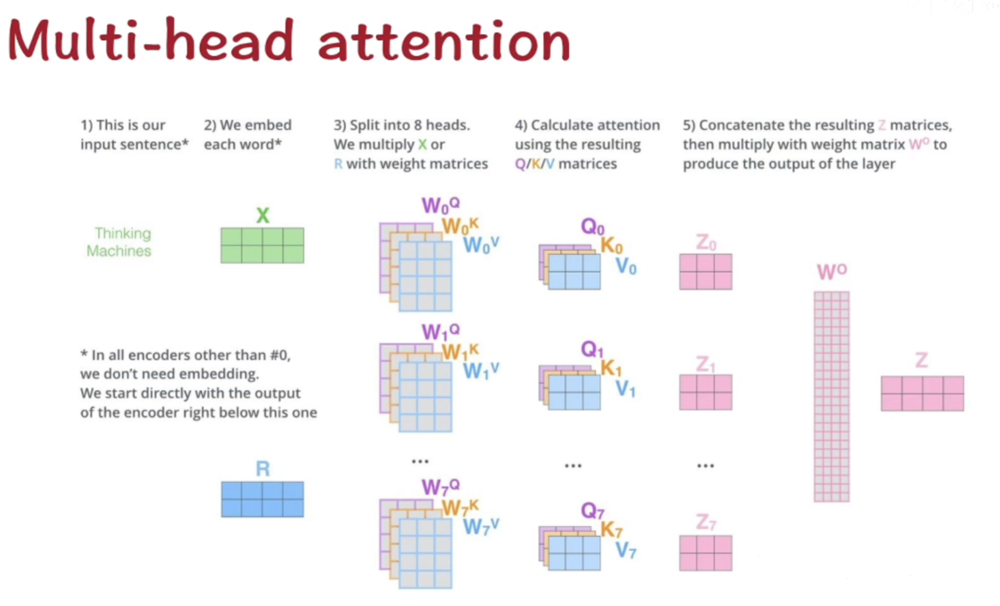

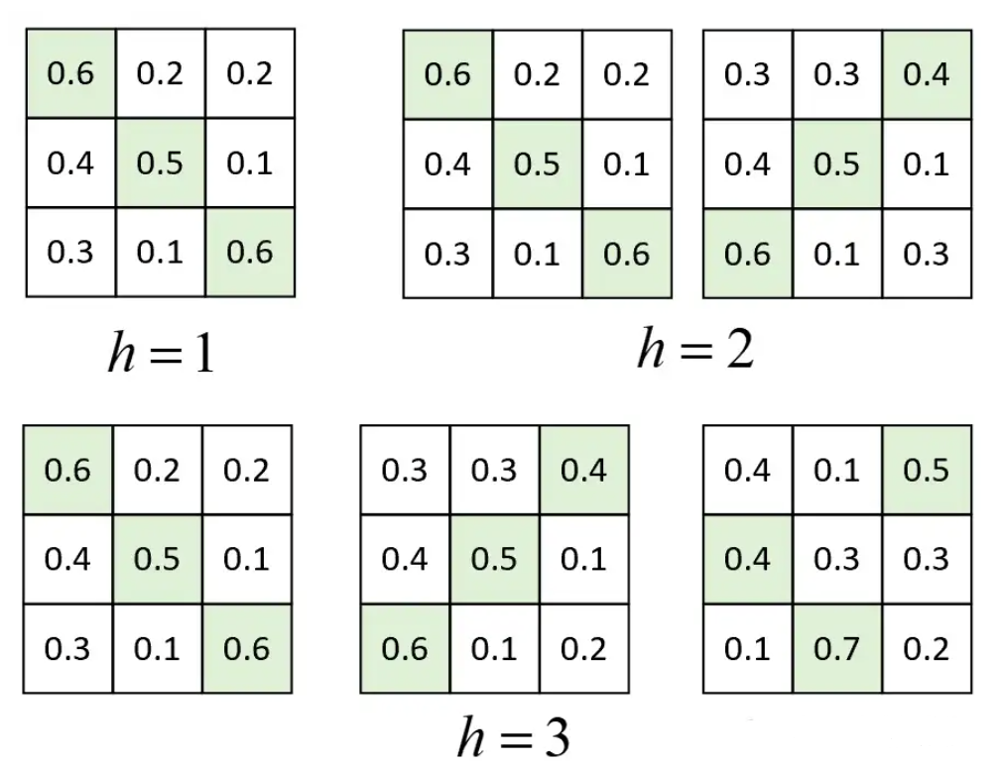

As we can see from above, the more header the more different kind of information(features) captured

In [ ]:
def multihead_attention(X,mask,heads,w_kqv,w_out):
  B,T,d = X.shape
  K,Q,V = np.split(X@w_kqv,3,axis=-1)
  # B x T x d => B x heads x T x d/heads
  K,Q,V = [a.reshape(B,T,heads,d//heads).swapaxes(1,2) for a in [K,Q,V]]
  A = softmax(K@Q.swapaxes(-1,-2)/np.sqrt(d//heads)+mask)
  return (A@V).swapaxes(1,2).reshape(B,T,d)@w_out,A

In [ ]:
heads = 4
attn = nn.MultiheadAttention(d,heads,bias=False,batch_first=True)
Y_, A_ = attn(X,X,X,attn_mask=M)

In [ ]:
Y, A = multihead_attention(
    X.numpy(),M.numpy(),heads,
    attn.in_proj_weight.detach().numpy().T,
    attn.out_proj.weight.detach().numpy().T
)

In [ ]:
print(A.shape, A_.shape)

(50, 4, 100, 100) torch.Size([50, 100, 100])


In [ ]:
np.linalg.norm(A.mean(axis=1)-A_.detach().numpy())

1.0021265e-06

In [ ]:
np.linalg.norm(Y-Y_.detach().numpy()) # checking the difference between our function to the library function

1.1735307e-05

2. *Position-Wise Feed-Forward Network (FFN)*

  a linear layer + ReLu
  $$ FFN(x)=ReLu(xW_1+b_1)W_2+b_2$$
3. *Residual Connections and Layer Normalization:*
  * **Residual (skip) connections** are added around the sublayers to facilitate gradient flow.
  * **Layer normalization** is applied to stabilize training

    - Layer Normalization (across all features in a single instance):   
$$
\text{LN}(x) = \gamma \frac{x - \mu_{layer}}{\sqrt{\sigma_{layer}^2 + \epsilon}} + \beta
$$

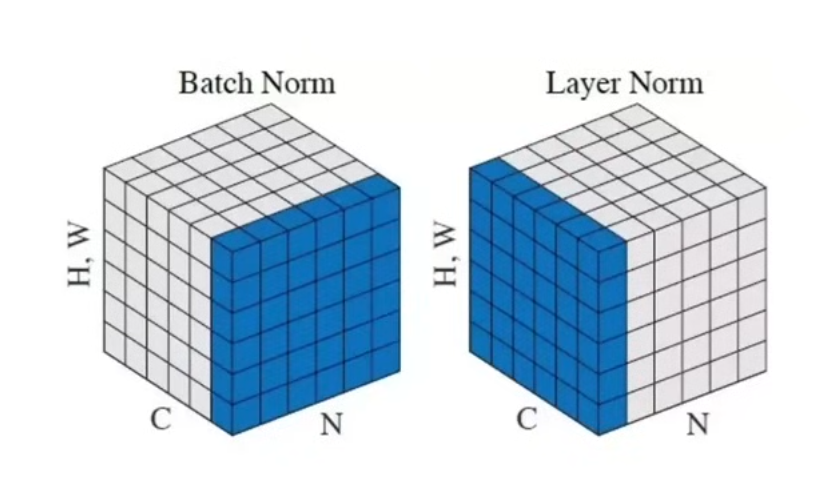

* Where N represents the Batch Dimension here

Pros:
* Full receptive field within a single layer
* Mixing over time does not increase parameter count

Cons:
* All outputs depend on all inputs
* No ordering of data

**How can we deal with the cons:**

1. **All outputs depend on all inputs**

> Masked Self-Attention (Decoder)

To solve the problem of 'acausal' dependencies, we can mask the softmax operator to assign zero weight to any 'future' time step

**Masked self-attention** is a variant of the self-attention mechanism that restricts the attention scope to prevent a position in a sequence from attending to subsequent positions. It is designed to ensure that the model's predictions for a given position t depend only on the known outputs at positions < t

$$
softmax(\frac{K Q^T}{\sqrt{d}}-M)V
$$
Where M is an upper triangular matrix where positions corresponding to future tokens are set to negative infinity (or a large negative number)

$$
M = \begin{bmatrix}
0 & -\infty & -\infty & -\infty \\
0 & 0 & -\infty & -\infty \\
0 & 0 & 0 & -\infty \\
0 & 0 & 0 & 0
\end{bmatrix}
$$

After applying the softmax function, these positions effectively receive zero attention weight:
$$
A = \begin{bmatrix}
A_{11} & 0 & 0 & 0 \\
A_{21} & A_{22} & 0 & 0 \\
A_{31} & A_{32} & A_{33} & 0 \\
A_{41} & A_{42} & A_{43} & A_{44}
\end{bmatrix}
$$

Use masked self-attention to ensure that when predicting the token at position
𝑡, the model only attends to positions ≤𝑡

2. **No ordering to data**

> Postional encodings

To solve the problem of "order invariance", we can add a postional encoding to the input,which associates each input with its **position in the sequence**

Since the model does not inherently consider the order of the sequence (due to the lack of recurrence or convolution), positional encoding is added to input embeddings

$$
X \in \mathbb{R}^n =
\begin{bmatrix}
x_1^T \\
x_2^T \\
\vdots \\
x_T^T
\end{bmatrix}
+
\begin{bmatrix}
\sin(\omega_1 \cdot 1) & \sin(\omega_2 \cdot 1) & \cdots \\
\sin(\omega_1 \cdot 2) & \sin(\omega_2 \cdot 2) & \cdots \\
\vdots & \vdots & \ddots \\
\sin(\omega_1 \cdot T) & \sin(\omega_2 \cdot T) & \cdots
\end{bmatrix}
$$

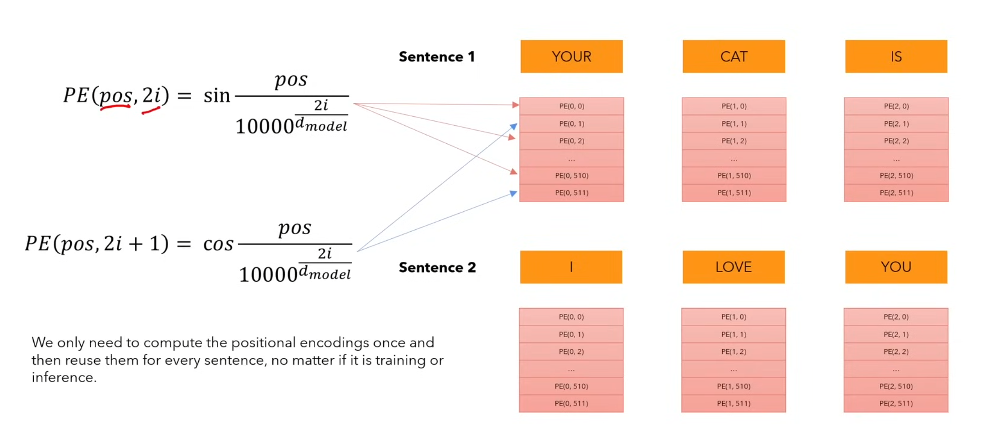

Format for multihead:
$$
SelfAttention(K,Q,V)= (softmax(\frac{K Q^T}{\sqrt{d}})V)w_{out}
$$

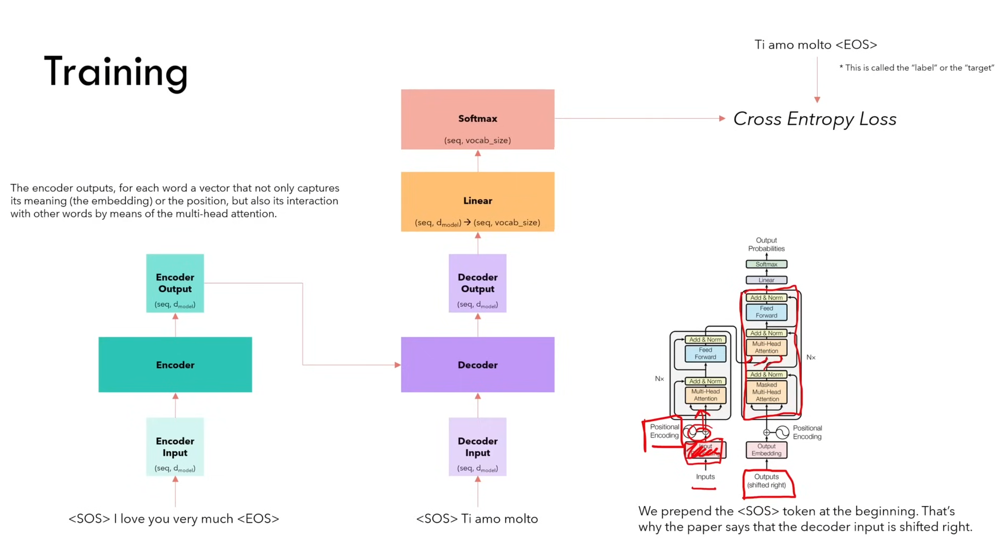

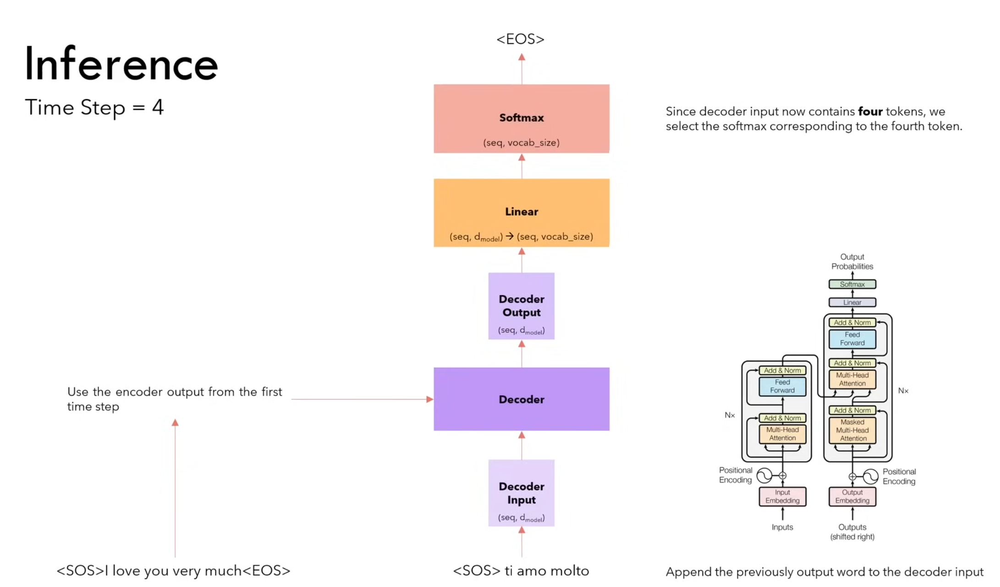

* Inference Strategy:
  * Greedy:

  At every step, select the word with maximum softmax value

  * Beam Search:

  Select top K words at each step and evaluate all possible next words for each and at each step then keep the top k most probable sequences

In [ ]:
import numpy as np
import torch
import torch.nn as nn

In [ ]:
def softmax(z):
  z = np.exp(z-z.max(axis=-1,keepdims=True))
  return z / z.sum(axis=-1,keepdims=True)

def self_attention(X,mask,w_kqv,w_out):
  K,Q,V = np.split(X@w_kqv,3,axis=1)
  A = softmax(K@Q.T/np.sqrt(X.shape[1])+mask)
  return A@V@w_out,A

In [ ]:
T,d = 100, 64
at = nn.MultiheadAttention(d,1,bias=False,batch_first=True)
M = torch.triu(-float("inf")*torch.ones(T,T),diagonal=1)
X = torch.randn(1,T,d)
Y_, A_ = at(X, X, X, attn_mask=M)

In [ ]:
X[0].shape

torch.Size([100, 64])

In [ ]:
M

tensor([[0., -inf, -inf,  ..., -inf, -inf, -inf],
        [0., 0., -inf,  ..., -inf, -inf, -inf],
        [0., 0., 0.,  ..., -inf, -inf, -inf],
        ...,
        [0., 0., 0.,  ..., 0., -inf, -inf],
        [0., 0., 0.,  ..., 0., 0., -inf],
        [0., 0., 0.,  ..., 0., 0., 0.]])

In [ ]:
at.in_proj_weight.shape

torch.Size([192, 64])

In [ ]:
Y,A = self_attention(
    X[0].numpy(),M.numpy(),
    at.in_proj_weight.detach().numpy().T,
    # detach is used to create copies of weight tensor that detached from computational graph
    at.out_proj.weight.detach().numpy().T
    )

In [ ]:
np.linalg.norm(Y-Y_.detach().numpy())

1.5895502e-06


> Mini-batching



In [ ]:
# Mini-Batch

C = np.random.randn(5,4,10,3)
D = np.random.randn(3,6)
(C@D).shape

(5, 4, 10, 6)

In [ ]:
(C.reshape(-1,3)@D).reshape(5,4,10,6).shape

(5, 4, 10, 6)

In [ ]:
def self_attention(X,mask,w_kqv,w_out):
  K,Q,V = np.split(X@w_kqv,3,axis=-1)
  A = softmax(K@Q.swapaxes(-1,-2)/np.sqrt(X.shape[-1])+mask)
  return A@V@w_out,A

In [ ]:
B,T,d = 50, 100, 64
X = torch.randn(B,T,d)
M = torch.triu(-float("inf")*torch.ones(T,T),diagonal=1)
Y_, A_ = at(X,X,X,attn_mask=M)

In [ ]:
Y,A = self_attention(
    X.numpy(),M.numpy(),
    at.in_proj_weight.detach().numpy().T,
    # detach is used to create copies of weight tensor that detached from computational graph
    at.out_proj.weight.detach().numpy().T
    )

In [ ]:
np.linalg.norm(Y-Y_.detach().numpy())# checking the difference between our function to the library function

1.1854309e-05



> Transformer block



In [ ]:
def layer_norm(z,eps):
  return (z-z.mean(axis=-1,keepdims=True))/np.sqrt(z.var(axis=-1,keepdims=True)+eps)
def relu(z):
  return np.maximum(z,0)
def transformer(X,mask,heads,w_kqv,w_out,w_ff1,w_ff2,eps):
  z = layer_norm(X + multihead_attention(X,mask,heads,w_kqv,w_out)[0],eps)
  return layer_norm(z + relu(z@w_ff1)@w_ff2,eps)

In [ ]:
trans = nn.TransformerEncoderLayer(d, heads, dim_feedforward=128, dropout=0.0, batch_first=True)
trans.linear1.bias.data.zero_()
trans.linear2.bias.data.zero_()
Y_ = trans(X,M)

In [ ]:
Y = transformer(
    X.numpy(),M.numpy(),heads,
    trans.self_attn.in_proj_weight.detach().numpy().T,
    trans.self_attn.out_proj.weight.detach().numpy().T,
    trans.linear1.weight.detach().numpy().T,
    trans.linear2.weight.detach().numpy().T,
    eps=trans.norm1.eps
)

In [ ]:
np.linalg.norm(Y-Y_.detach().numpy())

5.9749895e-05


### BERT





Bidirectional Encoder Representations from Transformers(BERT) is a basically trained Transformer Encoder Stack.

* Contextualized embeddings (static embedding - word2vec)
* Bidirectional (considers both left and right context)

**Pre-training Tasks**

BERT is pre-trained on large corpora using two unsupervised tasks:

1. Masked Language Modeling (MLM)

  * Objective:

    Predict masked tokens in the input.
  * Process:

    Randomly mask 15% of the tokens in the input sequence.
  
    The model predicts the original tokens based on context.
  * Benefit:

    Enables the model to learn bidirectional representations.
2. Next Sentence Prediction (NSP)
  * Objective:

    Determine if one sentence follows another in the original text.
  * Process:

    Pairs of sentences are provided:
  
    50% are actual consecutive sentences 50% are random sentences from the corpus.

  * Benefit:

    Helps the model understand sentence relationships.

In [ ]:
!pip install tensorflow-text

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.2/5.2 MB 44.1 MB/s eta 0:00:00


In [ ]:
import tensorflow as tf
import tensorflow_hub as hub
import tensorflow_text

In [ ]:
preprocess_url = "https://tfhub.dev/tensorflow/bert_en_uncased_preprocess/3"
encoder_url = "https://tfhub.dev/tensorflow/bert_en_uncased_L-12_H-768_A-12/4"

In [ ]:
bert_preprocess_model = hub.KerasLayer(preprocess_url)

In [ ]:
text_test= ['nice movie indeed','I love python programming']
text_preprocessed = bert_preprocess_model(text_test)
text_preprocessed.keys()

dict_keys(['input_word_ids', 'input_type_ids', 'input_mask'])

In [ ]:
text_preprocessed['input_mask']
# CLS nice movie indeed SEP

<tf.Tensor: shape=(2, 128), dtype=int32, numpy=
array([[1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]],
      dtype=int32)>

In [ ]:
text_preprocessed['input_word_ids']

<tf.Tensor: shape=(2, 128), dtype=int32, numpy=
array([[  101,  3835,  3185,  5262,   102,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0, 

In [ ]:
bert_model = hub.KerasLayer(encoder_url)
bert_results = bert_model(text_preprocessed)
bert_results.keys()

dict_keys(['sequence_output', 'default', 'encoder_outputs', 'pooled_output'])

In [ ]:
bert_results['pooled_output'] # embedding for sentences

<tf.Tensor: shape=(2, 768), dtype=float32, numpy=
array([[-0.791841  , -0.21422341,  0.4971101 , ...,  0.24394336,
        -0.47346333,  0.8176796 ],
       [-0.9171354 , -0.4792015 , -0.7860241 , ..., -0.61713684,
        -0.7101298 ,  0.92191947]], dtype=float32)>

In [ ]:
bert_results['sequence_output'] # embedding for each token

<tf.Tensor: shape=(2, 128, 768), dtype=float32, numpy=
array([[[ 0.07287344,  0.08554399,  0.14464843, ..., -0.09673803,
          0.08733474,  0.0771742 ],
        [ 0.17838301, -0.190426  ,  0.50375324, ..., -0.05891227,
          0.3273171 , -0.15595274],
        [ 0.18725675, -0.4340524 , -0.48856193, ..., -0.15449005,
          0.00137603, -0.24452274],
        ...,
        [ 0.12071905,  0.1288822 ,  0.46481618, ...,  0.0739056 ,
          0.17412694,  0.1652462 ],
        [ 0.07997318, -0.01187047,  0.5023031 , ...,  0.13818842,
          0.2099407 ,  0.00582774],
        [-0.07204092, -0.28304592,  0.59015363, ...,  0.47573483,
          0.16632828, -0.08924407]],

       [[-0.07840205,  0.36301672, -0.21083072, ..., -0.17175889,
          0.16289352,  0.67258567],
        [ 0.2795229 ,  0.4370875 , -0.3578813 , ..., -0.04430806,
          0.38321158,  0.58896935],
        [ 1.2049354 ,  1.072557  ,  0.48408145, ...,  0.24900073,
          0.40710473,  0.40490073],
        ...,

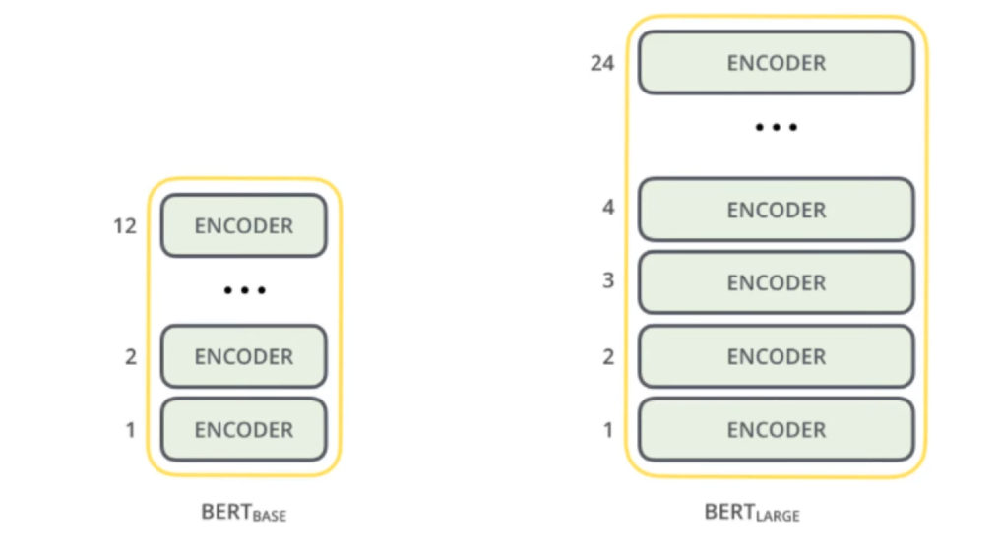

In [ ]:
bert_results['encoder_outputs'] # embedding for each layer

In [ ]:
len(bert_results['encoder_outputs'])

12

In [ ]:
bert_results['encoder_outputs'][-1] == bert_results['sequence_output']

<tf.Tensor: shape=(2, 128, 768), dtype=bool, numpy=
array([[[ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True],
        ...,
        [ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True]],

       [[ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True],
        ...,
        [ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True]]])>



> Text Classification by BERT



In [ ]:
pip install tensorflow-text

In [ ]:
import tensorflow as tf
import tensorflow_hub as hub
import tensorflow_text as text

In [ ]:
import pandas as pd

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/MD/Learning is Learning/spam_bert.csv')
df.head(5)

,Category,Message
0,ham,"Go until jurong point, crazy.. Available only ..."
1,ham,Ok lar... Joking wif u oni...
2,spam,Free entry in 2 a wkly comp to win FA Cup fina...
3,ham,U dun say so early hor... U c already then say...
4,ham,"Nah I don't think he goes to usf, he lives aro..."


In [ ]:
df.groupby('Category').describe()

Message                                                            \
           count unique                                                top   
Category                                                                     
ham         4825   4516                             Sorry, I'll call later   
spam         747    641  Please call our customer service representativ...   

               
         freq  
Category       
ham        30  
spam        4

Existing Imbalanced dataset

In [ ]:
df_spam = df[df['Category']=='spam']
df_spam.shape

(747, 2)

In [ ]:
df_ham = df[df['Category']=='ham']
df_ham.shape

(4825, 2)

In [ ]:
df_ham_under = df_ham.sample(df_spam.shape[0])
df_ham_under.shape

(747, 2)

In [ ]:
df_balanced = pd.concat([df_ham_under, df_spam])
df_balanced.shape

(1494, 2)

In [ ]:
df_balanced['Category'].value_counts()

,count
Category,
ham,747
spam,747


In [ ]:
df_balanced['spam']=df_balanced['Category'].apply(lambda x: 1 if x=='spam' else 0)
df_balanced.sample(5)

,Category,Message,spam
3839,ham,Went to pay rent. So i had to go to the bank t...,0
763,spam,Urgent Ur £500 guaranteed award is still uncla...,1
883,ham,I love to give massages. I use lots of baby oi...,0
611,spam,22 days to kick off! For Euro2004 U will be ke...,1
3522,ham,Hey... are you going to quit soon? Xuhui and i...,0


In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(df_balanced['Message'],df_balanced['spam'], stratify=df_balanced['spam']) # the category equal weighted

In [ ]:
bert_preprocess = hub.KerasLayer("https://tfhub.dev/tensorflow/bert_en_uncased_preprocess/3")
bert_encoder = hub.KerasLayer("https://tfhub.dev/tensorflow/bert_en_uncased_L-12_H-768_A-12/4")

In [ ]:
def get_sentence_embeding(sentences):
    preprocessed_text = bert_preprocess(sentences)
    return bert_encoder(preprocessed_text)['pooled_output']


In [ ]:
get_sentence_embeding(['hello there nice to meet you'])

In [ ]:
e = get_sentence_embeding([
    "banana",
    "grapes",
    "mango",
    "jeff bezos",
    "elon musk",
    "bill gates"
]
)

In [ ]:
from sklearn.metrics.pairwise import cosine_similarity

cosine_similarity([e[0]],[e[1]]), cosine_similarity([e[0]],[e[4]])

(array([[0.9909786]], dtype=float32), array([[0.893641]], dtype=float32))

Functional Model

In [ ]:
pip install keras_nlp

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 548.4/548.4 kB 8.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.2/5.2 MB 75.1 MB/s eta 0:00:00


In [ ]:
import keras_nlp

In [ ]:
# BERT Layer
text_input = tf.keras.layers.Input(shape=(), dtype=tf.string)
preprocessor = keras_nlp.models.BertPreprocessor.from_preset("bert_base_en_uncased",trainable=True)
encoder_inputs = preprocessor(text_input)
encoder = keras_nlp.models.BertBackbone.from_preset("bert_base_en_uncased")
outputs = encoder(encoder_inputs)
pooled_output = outputs["pooled_output"]    # [batch_size, 768].
sequence_output = outputs["sequence_output"] # [batch_size, seq_length, 768].

# Neural Network Layer
l = tf.keras.layers.Dropout(0.1, name="dropout")(outputs['pooled_output'])
l = tf.keras.layers.Dense(1, activation='sigmoid', name="output")(l)

# Construct final model
model = tf.keras.Model(inputs=[text_input], outputs=[l])


In [ ]:
model.summary()

Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_4             │ (None)                 │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bert_text_classifier_pre… │ [(None, 512), (None,   │              0 │ input_layer_4[0][0]    │
│ (BertTextClassifierPrepr… │ 512), (None, 512)]     │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bert_backbone             │ [(None, 768), (None,   │    109,482,240 │ bert_text_classifier_… │
│ (BertBackbone)            │ 512, 768)]             │                │ bert_text_classifier_… │
│                           │                        │                │ bert_text_classifier_… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout (Dropout)         │ (None, 768)            │              0 │ bert_backbone[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ output (Dense)            │ (None, 1)              │            769 │ dropout[0][0]          │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 109,483,009 (417.64 MB)

 Trainable params: 109,483,009 (417.64 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
tf.config.optimizer.set_jit(False)

In [ ]:
METRICS = [
      tf.keras.metrics.BinaryAccuracy(name='accuracy'),
      tf.keras.metrics.Precision(name='precision'),
      tf.keras.metrics.Recall(name='recall')
]

model.compile(optimizer='Adam',
              loss='binary_crossentropy',
              metrics=METRICS)

In [ ]:
model.fit(X_train, y_train, epochs=10)

In [ ]:
reviews = [
    'Reply to win Â£100 weekly! Where will the 2006 FIFA World Cup be held? Send STOP to 87239 to end service',
    'You are awarded a SiPix Digital Camera! call 09061221061 from landline. Delivery within 28days. T Cs Box177. M221BP. 2yr warranty. 150ppm. 16 . p pÂ£3.99',
    'it to 80488. Your 500 free text messages are valid until 31 December 2005.',
    'Hey Sam, Are you coming for a cricket game tomorrow',
    "Why don't you wait 'til at least wednesday to see if you get your ."
]
model.predict(reviews)

## Neural Architecture Search (NAS)

* A neural network has different types of hyperparameters:
  * Topological structure: resnet-ish, mobilenet-ish, #layers
  * Individual layers: kernel_size, #channels in convolution layer, #hidden_outputs in dense/recurrent layers
* NAS automates the design of neural network
  * How to specify the search space of NN
  * How to explore the search space
  * Performance estimation



> **NAS with reinforce learning**

* Using RNN to generate the Hyperparameter
* Get the validation accuracy from trainning
* Reward/feedback the accuracy, reinforce learning

Quite expensive!

> **The One-shot Approach**

* Train a huge model contains all the models from the search space
* Evaluate the performance of child model, using some approximation figures to ranking



> **Differenciatable Architecture Search**

* The architecture is fixed, select the network for each layer
* Regard the selection as a learnable parameter, use softmax to learn the parameter for choosing the network for each layer





## Details steps in DL

### Linear Regression

In [ ]:
!pip install d2l

In [ ]:
%matplotlib inline
import random
import torch
from d2l import torch as d2l

In [ ]:
# use a set of w = [2,-3,4] and b = [4.2] with some noice to generate datas
def synthetic_data(w, b, num_examples):
  X = torch.normal(0, 1, (num_examples, len(w)))
  y = torch.matmul(X, w) + b
  y += torch.normal(0, 0.01, y.shape)
  return X, y.reshape((-1, 1))

true_w = torch.tensor([2, -3.4])
true_b = 4.2
features, labels = synthetic_data(true_w, true_b, 1000)

In [ ]:
features[0], labels[0]

(tensor([-0.4688,  1.4578]), tensor([-1.7046]))

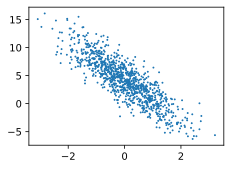

In [ ]:
d2l.set_figsize()
d2l.plt.scatter(features[:, 1].detach().numpy(),
        labels.detach().numpy(), 1)

In [ ]:
def data_iter(batch_size, features, labels):
  num_examples = len(features)
  indices = list(range(num_examples))
  random.shuffle(indices)
  for i in range(0, num_examples, batch_size):
    batch_indices = torch.tensor(indices[i:min(i+batch_size, num_examples)])
    yield features[batch_indices], labels[batch_indices] #iterator

batch_size = 10
for X, y in data_iter(batch_size, features, labels):
  print(X, '\n', y)
  break

tensor([[ 0.6319, -1.6179],
        [-1.1148, -1.1541],
        [-1.0976,  1.4281],
        [-1.5472, -0.2968],
        [ 0.1215, -0.0985],
        [ 1.1301,  0.9122],
        [ 0.5284, -1.6366],
        [ 1.3621, -1.9085],
        [ 0.7375,  0.3718],
        [-0.1809,  1.1177]]) 
 tensor([[10.9558],
        [ 5.8968],
        [-2.8568],
        [ 2.1118],
        [ 4.7795],
        [ 3.3423],
        [10.8255],
        [13.3974],
        [ 4.4251],
        [ 0.0399]])


In [ ]:
# Initialize
w = torch.normal(0, 0.01, size=(2,1), requires_grad=True)
b = torch.zeros(1, requires_grad=True)

In [ ]:
def linreg(X,w,b):
  return torch.matmul(X, w) + b

In [ ]:
def squared_loss(y_hat, y):
  return (y_hat - y.reshape(y_hat.shape)) ** 2 / 2

In [ ]:
def sgd(params, lr, batch_size):
  with torch.no_grad():
    for param in params:
      param -= lr * param.grad / batch_size
      param.grad.zero_()

In [ ]:
Epoch = 3
lr = 0.03
net = linreg
loss = squared_loss
for epoch in range(Epoch):
  for X, y in data_iter(batch_size, features, labels):
    l = loss(net(X, w, b), y) # l.size = [batch_size,1]
    l.sum().backward()
    sgd([w, b], lr, batch_size)
  with torch.no_grad():
    train_l = loss(net(features, w, b), labels)
    print(f'epoch {epoch + 1}, loss {float(train_l.mean()):f}')

epoch 1, loss 0.039237
epoch 2, loss 0.000143
epoch 3, loss 0.000051


In [ ]:
true_w - w.reshape(true_w.shape)

tensor([-0.0005,  0.0002], grad_fn=<SubBackward0>)

In [ ]:
true_b - b

tensor([0.0007], grad_fn=<RsubBackward1>)

Simpler Version

In [ ]:
from torch.utils import data

In [ ]:
def load_array(data_arrays, batch_size, is_train=True):
  dataset = data.TensorDataset(*data_arrays)
  return data.DataLoader(dataset, batch_size, shuffle=is_train)

data_iter = load_array((features, labels), batch_size)

next(iter(data_iter))

[tensor([[-1.1996, -0.4489],
         [-0.4189,  1.2768],
         [ 1.2313,  1.2382],
         [ 1.4666, -1.0541],
         [ 1.7212,  0.4150],
         [ 0.9843, -0.5934],
         [-0.6960, -0.6077],
         [-1.0976,  1.4281],
         [ 0.9489,  0.0540],
         [ 1.6055, -0.2770]]),
 tensor([[ 3.3344],
         [-0.9841],
         [ 2.4454],
         [10.7233],
         [ 6.2377],
         [ 8.1709],
         [ 4.8677],
         [-2.8568],
         [ 5.9217],
         [ 8.3553]])]

In [ ]:
net = torch.nn.Sequential(torch.nn.Linear(2,1))

In [ ]:
net[0].weight.data.normal_(0, 0.01)
net[0].bias.data.fill_(0)

tensor([0.])

In [ ]:
loss = torch.nn.MSELoss()
trainer = torch.optim.SGD(net.parameters(), lr=0.03)

In [ ]:
num_epoch = 3
for epoch in range(num_epoch):
  for X, y in data_iter:
    l = loss(net(X), y) # X,y batch datas
    trainer.zero_grad()
    l.backward()
    trainer.step()
  l = loss(net(features), labels) # features,labels entire data
  print(f'epoch {epoch + 1}, loss {l:f}')

epoch 1, loss 0.000248
epoch 2, loss 0.000103
epoch 3, loss 0.000102


### NN-implementation

In [ ]:
# Code to set up the assignment
from google.colab import drive
drive.mount('/content/drive')
%cd /content/drive/MyDrive/
!mkdir -p 10714f24
%cd /content/drive/MyDrive/10714f24

# NOTE: Run the following line
# - uncomment the following line if you run this section for the first time
# - comment and skip the following line when you run this section for a second time
#   so you will have a local copy of lecture8 under 10714f24/lecture8 that you can
#   continue to edit and play with
# !git clone https://github.com/dlsyscourse/lecture8
%rm -rf /content/needle
!ln -s /content/drive/MyDrive/10714f24/lecture8 /content/needle
%cd /content/needle

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
/content/drive/MyDrive
/content/drive/MyDrive/10714f24
fatal: destination path 'lecture8' already exists and is not an empty directory.
/content/drive/MyDrive/10714f24/lecture8


In [ ]:
%set_env PYTHONPATH /content/needle/python:/env/python
import sys
sys.path.append("/content/needle/python")

env: PYTHONPATH=/content/needle/python:/env/python


In [ ]:
import needle as ndl

In [ ]:
w = ndl.Tensor([1,2,3], dtype="float32")

In [ ]:
w

needle.Tensor([1. 2. 3.])

In [ ]:
g = ndl.Tensor([1,1,1], dtype="float32")

In [ ]:
w.requires_grad
#By default, we create needle Tensors that sets requires_grad to be true
#This will cause us to record the gradient graph by default

True

In [ ]:
# Let us run a sgd style update for a few steps
grad = ndl.Tensor([1,1,1], dtype="float32")
lr = 0.1
for i in range(5):
  w = w + (-lr)*grad

In [ ]:
w.op

In [ ]:
w.inputs[0].op

In [ ]:
w.inputs[0].inputs[0].op

The problem with is approach is that we are actively building up a computational graph that tracks the history of all the past updates. Such un-necessary graph tracking can cause memory and speed issues.

Instead, we can create a "detached" tensor that does not requires grad. When we are

In [ ]:
w.data

needle.Tensor([0.4999999 1.4999999 2.5000005])

In [ ]:
w.data.requires_grad

False

In [ ]:
new_w = w.data + (-lr) * grad.data

In [ ]:
new_w

needle.Tensor([0.39999992 1.3999999  2.4000006 ])

The reason we get the number of 0.39999992 is because of floating point number, by mean that it can not accuratly approximate the number of 0.4 in some cases

In [ ]:
new_w.requires_grad

False

In [ ]:
new_w.inputs

[]



> Numerical stability



Most computations in a deep learning model are executed using 32-bit floating point. We need to pay special attention to potential numerical problems. Softmax is one of the most commonly used operators in loss functions.
Let $z = softmax(x)$, then we have

\begin{equation}
 z_i = \frac{exp(x_i)}{\sum_k exp(x_k)}
\end{equation}

If we naively follow the formula to compute softmax, the result can be inaccurate.

In [ ]:
import numpy as np

In [ ]:
x = np.array([100, 100, 101], dtype="float32") # floating number explodes

def softmax_naive(x):
    z = np.exp(x)
    return z / np.sum(z)

p = softmax_naive(x)
p

<ipython-input-21-35eddb9a8ee0>:4: RuntimeWarning: overflow encountered in exp
  z = np.exp(x)
<ipython-input-21-35eddb9a8ee0>:5: RuntimeWarning: invalid value encountered in divide
  return z / np.sum(z)


array([nan, nan, nan], dtype=float32)

Passing a large number(that is greater than 0) to exp function can easily result in overflow. Note that the following invariance hold for any constant $c$

\begin{equation}
 z_i = \frac{exp(x_i)}{\sum_k exp(x_k)} = \frac{exp(x_i-c)}{\sum_k exp(x_k-c)}
\end{equation}

We can pick $c = max(x)$ so that all the inputs to the exp become smaller or equal to 0


In [ ]:
x = np.array([1000, 10000, 100], dtype="float32")
def softmax_stable(x):
    x = x - np.max(x)
    z = np.exp(x)
    return z / np.sum(z)

softmax_stable(x)

array([0., 1., 0.], dtype=float32)



> Designing a Neural Network Library





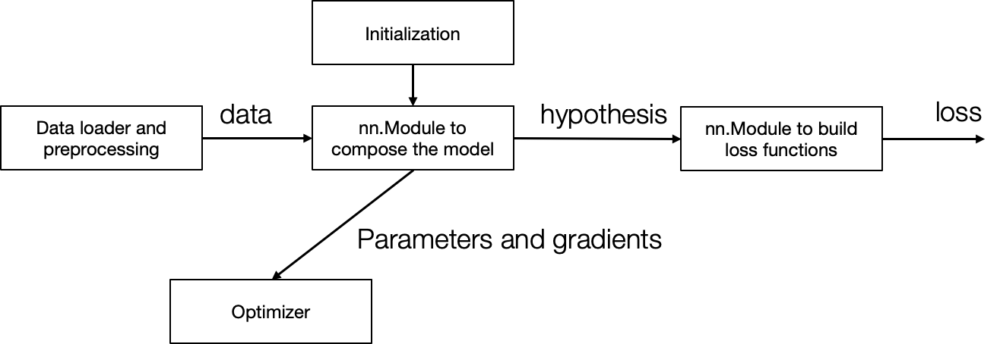

In [ ]:
class Parameter(ndl.Tensor):
    """parameter"""

In [ ]:
def _get_params(value):
    if isinstance(value, Parameter):
        return [value]
    if isinstance(value, dict):
        params = []
        for k, v in value.items():
            params += _get_params(v)
        return params
    if isinstance(value, Module):
        return value.parameters()
    return []

class Module:
    def parameters(self):
        return _get_params(self.__dict__)

    def __call__(self, *args, **kwargs):
        return self.forward(*args, **kwargs)

Now that we have the base Module interface, we can start to define different kind of modules. Let us define a simple scale add module, that computes $y = x \times s + b$. The ScaleAdd is parameterized by $s$ and $b$.

In [ ]:
class ScaleAdd(Module):
  def __init__(self,init_s=1,init_b=0):
    self.s = Parameter([init_s],dtype="float32")
    self.b = Parameter([init_b],dtype="float32")

  def forward(self,x):
    return self.s * x + self.b

In [ ]:
sadd = ScaleAdd()

In [ ]:
sadd.parameters()

# return a self.dict {'s':s,'b':b} to get_params and
# recursively return value

[needle.Tensor([1.]), needle.Tensor([0.])]

In [ ]:
sadd.parameters()[0] is sadd.s

True

In [ ]:
sadd.parameters()[1] is sadd.b

True

In [ ]:
sadd = ScaleAdd(2,1) # s = 2, b = 1

In [ ]:
sadd(ndl.Tensor([2],dtype="float32")) # 2*2 + 1 = 5

needle.Tensor([5.])

We allow a module to contain multiple submodules inside and compose them together

In [ ]:
class MultiPathScaleAdd(Module):
    def __init__(self):
        self.path0 = ScaleAdd()
        self.path1 = ScaleAdd()

    def forward(self, x):
        return self.path0(x) + self.path1(x)

In [ ]:
mpath = MultiPathScaleAdd()
mpath.parameters()

[needle.Tensor([1.]),
 needle.Tensor([0.]),
 needle.Tensor([1.]),
 needle.Tensor([0.])]



> Loss Function



In [ ]:
class L2Loss(Module):
    def forward(self, x ,y):
        z = x + (-1) * y
        return z * z

In [ ]:
x = ndl.Tensor([2], dtype="float32")
y = ndl.Tensor([2], dtype="float32")
loss = L2Loss()(mpath(x), y)

In [ ]:
loss.backward()



> Optimizer



In [ ]:
class Optimizer:
    def __init__(self, params):
        self.params = params

    def reset_grad(self):
        for p in self.params:
            p.grad = None

    def step(self):
        raise NotImplemented()

In [ ]:
class SGD(Optimizer):
    def __init__(self, params, lr):
        self.params = params
        self.lr = lr

    def step(self):
        for w in self.params:
            w.data = w.data + (-self.lr) * w.grad

In [ ]:
class SDGwithMomentum(Optimizer):
    def __init__(self, params, lr, momentum):
        self.params = params
        self.lr = lr
        self.momentum = momentum
        self.velocity = [ndl.zeros_like(p) for p in self.params]

In [ ]:
x = ndl.Tensor([2], dtype="float32")
y = ndl.Tensor([2], dtype="float32")

model = MultiPathScaleAdd()
l2loss = L2Loss()
opt = SGD(model.parameters(), lr=0.01)
num_epoch = 10

for epoch in range(num_epoch):
    opt.reset_grad()
    h = model(x)
    loss = l2loss(h, y)
    training_loss = loss.numpy()
    loss.backward()
    opt.step()

    print(training_loss)

> Tensorflow Input Pipeline



```
tf_dataset = tf.data.Dataset.list_files('images/*').map(process_img).filter(filter_func).map(lamda x:x/255)
```



Load images from imgaes folder => Convert image content to numpy array and extract label from folder => filter blurred images => Scaling

In [ ]:
import tensorflow as tf

In [ ]:
daily_sales_numbers = [21,22,-108,31,-1,32,34,31]

In [ ]:
tf_dataset = tf.data.Dataset.from_tensor_slices(daily_sales_numbers)
tf_dataset

<_TensorSliceDataset element_spec=TensorSpec(shape=(), dtype=tf.int32, name=None)>

In [ ]:
for sales in tf_dataset:
  print(sales.numpy())

21
22
-108
31
-1
32
34
31


In [ ]:
for salse in tf_dataset.take(3):
  print(salse.numpy())

21
22
-108


In [ ]:
tf_dataset = tf_dataset.filter(lambda x:x>0)
for sales in tf_dataset:
  print(sales.numpy())

21
22
31
32
34
31


In [ ]:
tf_dataset = tf_dataset.map(lambda x:x*72)
for sales in tf_dataset:
  print(sales.numpy())

1512
1584
2232
2304
2448
2232


In [ ]:
tf_dataset = tf_dataset.shuffle(2)
for sales in tf_dataset:
  print(sales.numpy())

2232
1512
2232
2304
2448
1584


In [ ]:
for sales_batch in tf_dataset.batch(4):
  print(sales_batch.numpy())

[1512 2232 1584 2304]
[2232 2448]


In [ ]:
tf_dataset = tf.data.Dataset.from_tensor_slices(daily_sales_numbers)

tf_dataset = tf_dataset.filter(lambda x:x>0).map(lambda y:y*72).shuffle(2).batch(2)
for sales in tf_dataset:
  print(sales.numpy())

[1512 2232]
[2304 1584]
[2448 2232]


In [ ]:
images = tf.data.Dataset.list_files('/content/drive/MyDrive/MD/Learning is Learning/pictures/images/*/*',shuffle=False)

In [ ]:
for i in images.take(5):
  print(i.numpy())

b'/content/drive/MyDrive/MD/Learning is Learning/pictures/images/cat/20 Reasons Why Cats Make the Best Pets....jpg'
b'/content/drive/MyDrive/MD/Learning is Learning/pictures/images/cat/7 Foods Your Cat Can_t Eat.jpg'
b'/content/drive/MyDrive/MD/Learning is Learning/pictures/images/cat/A cat appears to have caught the....jpg'
b'/content/drive/MyDrive/MD/Learning is Learning/pictures/images/cat/Adopt-A-Cat Month\xc2\xae - American Humane....jpg'
b'/content/drive/MyDrive/MD/Learning is Learning/pictures/images/cat/All About Your Cat_s Tongue.jpg'


In [ ]:
c_n = ["cat","dog"]

In [ ]:
images_count = len(images)
images_count

100

In [ ]:
train_size = int(images_count*0.8)
train_ds = images.take(train_size)
test_ds = images.skip(train_size)

In [ ]:
s= '/content/drive/MyDrive/MD/Learning is Learning/pictures/images/cat/20 Reasons Why Cats Make the Best Pets....jpg'

In [ ]:
import os
def get_label(file_path):
  return tf.strings.split(file_path,os.path.sep)[-2]

In [ ]:
get_label(s)

<tf.Tensor: shape=(), dtype=string, numpy=b'cat'>

In [ ]:
for label in train_ds.map(get_label):
  print(label.numpy())

In [ ]:
def process_image(file_path):
  label = get_label(file_path)
  img = tf.io.read_file(file_path)
  img = tf.image.decode_jpeg(img)
  img = tf.image.resize(img,[128,128])
  return img,label

In [ ]:
train_ds = train_ds.map(process_image)
for img,label in train_ds.take(3):
  print(label)
  print(img)

tf.Tensor(b'cat', shape=(), dtype=string)
tf.Tensor(
[[[155.       186.       215.      ]
  [156.       187.       216.      ]
  [158.       189.       218.      ]
  ...
  [ 90.99609   84.99609   72.99609 ]
  [ 92.        86.        74.      ]
  [ 93.        87.        75.      ]]

 [[156.01172  187.01172  216.01172 ]
  [157.02344  188.02344  217.02344 ]
  [159.01172  190.01172  219.01172 ]
  ...
  [ 86.98828   82.97656   74.01172 ]
  [ 89.97656   85.96484   77.      ]
  [ 91.        86.98828   78.02344 ]]

 [[159.       190.       219.      ]
  [160.       191.       220.      ]
  [161.01953  192.01953  221.01953 ]
  ...
  [ 80.96094   77.96094   72.96094 ]
  [ 85.        82.        77.      ]
  [ 87.        84.        79.      ]]

 ...

 [[ 91.09766   44.98047   73.17578 ]
  [108.25781   83.16016   86.25781 ]
  [ 36.058594  33.058594  18.058594]
  ...
  [ 51.234375  32.214844  34.195312]
  [ 41.078125  18.078125  26.078125]
  [ 38.941406  24.941406  23.941406]]

 [[141.90625  123.882

In [ ]:
# Scaling
def scale(image,label):
  return image/255,label

In [ ]:
train_ds = train_ds.map(scale)
for image,label in train_ds.take(3):
  print(label)
  print(image[0][0])

tf.Tensor(b'cat', shape=(), dtype=string)
tf.Tensor([0.60784316 0.7294118  0.84313726], shape=(3,), dtype=float32)
tf.Tensor(b'cat', shape=(), dtype=string)
tf.Tensor([0.6878983  0.69181985 0.672212  ], shape=(3,), dtype=float32)
tf.Tensor(b'cat', shape=(), dtype=string)
tf.Tensor([0.7736826  0.8089767  0.79120713], shape=(3,), dtype=float32)


In [ ]:
tf_dataset_1 = tf.data.Dataset.list_files('/content/drive/MyDrive/MD/Learning is Learning/pictures/images/*/*',shuffle=False).map(process_image).map(scale).shuffle(2).batch(2)



> Optimize the pipeline





In [ ]:
import tensorflow as tf
import time

In [ ]:
tf.__version__

'2.17.0'

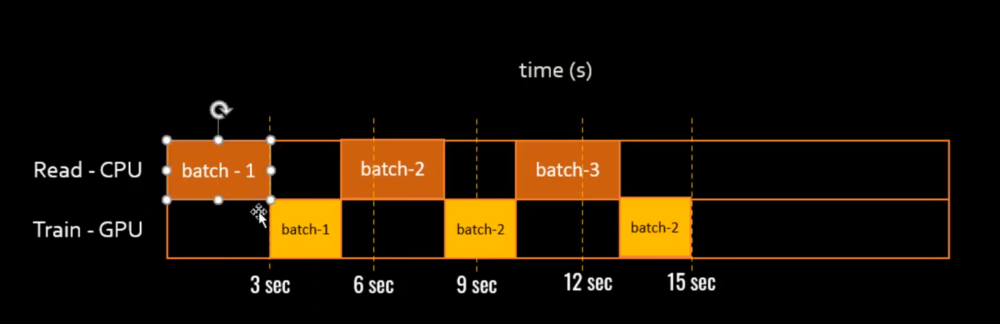

In [ ]:
class FileDataset(tf.data.Dataset):
    def read_files_in_batches(num_samples):
        # Opening the file
        time.sleep(0.03)

        for sample_idx in range(num_samples):
            # Reading data (line, record) from the file
            time.sleep(0.015)

            yield (sample_idx,)

    def __new__(cls,num_samples=3):
        return tf.data.Dataset.from_generator(
            cls.read_files_in_batches,
            output_signature = tf.TensorSpec(shape=(1,), dtype=tf.int64),
            args=(num_samples,)
        )

In [ ]:
def benchmark(dataset,num_epochs=2):
    for epoch in range(num_epochs):
        for sample in dataset:
            time.sleep(0.01)
            #print('.',end='')

In [ ]:
%%timeit
benchmark(FileDataset())

258 ms ± 2.4 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


Use Prefetch technique

In [ ]:
%%timeit
benchmark(FileDataset().prefetch(tf.data.AUTOTUNE))
# my gpu and cpu is superior, so the difference is quite subtle =v=

258 ms ± 1.68 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [ ]:
dataset = tf.data.Dataset.range(5)
for d in dataset:
    print(d.numpy())

0
1
2
3
4


In [ ]:
dataset = dataset.map(lambda x: x**2)
for d in dataset:
    print(d.numpy())

0
1
4
9
16


In [ ]:
dataset = dataset.cache()
for d in dataset.as_numpy_iterator(): # reading data from cache otherwise will recalculate the function above again
    print(d)

0
1
4
9
16


In [ ]:
list(dataset.as_numpy_iterator())# reading data from cache

[0, 1, 4, 9, 16]

In [ ]:
def mapped_function(s):
    tf.py_function(lambda: time.sleep(0.03), [], ())
    return s

In [ ]:
%%timeit -n1 -r1
benchmark(FileDataset().map(mapped_function),5)

1.1 s ± 0 ns per loop (mean ± std. dev. of 1 run, 1 loop each)


In [ ]:
%%timeit -n1 -r1
benchmark(FileDataset().map(mapped_function).cache(),5)

381 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 1 loop each)


### Practical cases



---


> **Handwritten Digits Classification (TensorFlow 2.0)**




In [ ]:
import tensorflow as tf
from tensorflow import keras
from matplotlib import pyplot as plt
%matplotlib inline
import numpy as np

In [ ]:
(X_train_full, y_train_full), (X_test, y_test) = keras.datasets.mnist.load_data()

11490434/11490434 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


In [ ]:
len(X_train_full)

60000

In [ ]:
X_train_full.shape #28*28 pictures with a number of 60000

(60000, 28, 28)

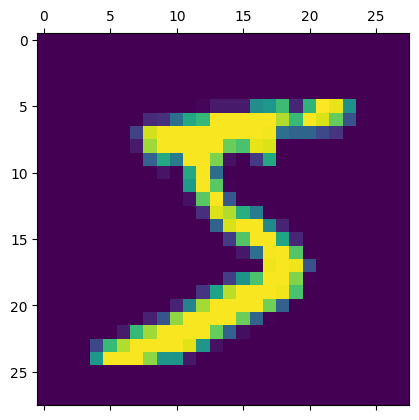

In [ ]:
plt.matshow(X_train_full[0])

In [ ]:
y_train_full[0]

5

In [ ]:
X_train_full = X_train_full / 255
X_test = X_test / 255

In [ ]:
X_train = X_train_full.reshape(60000,28*28)
X_test_1 = X_test.reshape(10000,28*28)
X_train.shape

(60000, 784)

In [ ]:
model = keras.Sequential([
    keras.layers.Dense(10, input_shape=(784,), activation='sigmoid')
])

model.compile(optimizer='SGD', # 'adam'
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])
model.fit(X_train, y_train_full, epochs=5)

/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/5
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 3s 1ms/step - accuracy: 0.7158 - loss: 1.1272
Epoch 2/5
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 3s 1ms/step - accuracy: 0.8769 - loss: 0.4737
Epoch 3/5
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step - accuracy: 0.8891 - loss: 0.4149
Epoch 4/5
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step - accuracy: 0.8950 - loss: 0.3855
Epoch 5/5
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step - accuracy: 0.9018 - loss: 0.3567


In [ ]:
model.evaluate(X_test_1,y_test)

313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - accuracy: 0.8940 - loss: 0.3835


[0.33573076128959656, 0.9089000225067139]

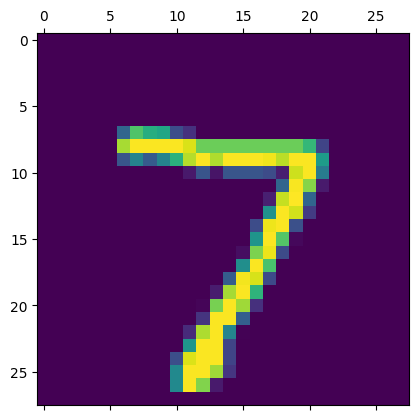

In [ ]:
plt.matshow(X_test[0])

In [ ]:
y_pred = model.predict(X_test_1)
y_pred[0]

313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step


array([0.5608121 , 0.0045984 , 0.46950793, 0.8945297 , 0.20190997,
       0.2883777 , 0.01389787, 0.99978125, 0.45333424, 0.930981  ],
      dtype=float32)

In [ ]:
np.argmax(y_pred[0]) #return the idex of the maximum prediction probability of the result which is the prediction of the digits

7

In [ ]:
y_test[0]

7

In [ ]:
cm = tf.math.confusion_matrix(labels = y_test, predictions = np.argmax(y_pred, axis=1))

Text(95.72222222222221, 0.5, 'Truth')

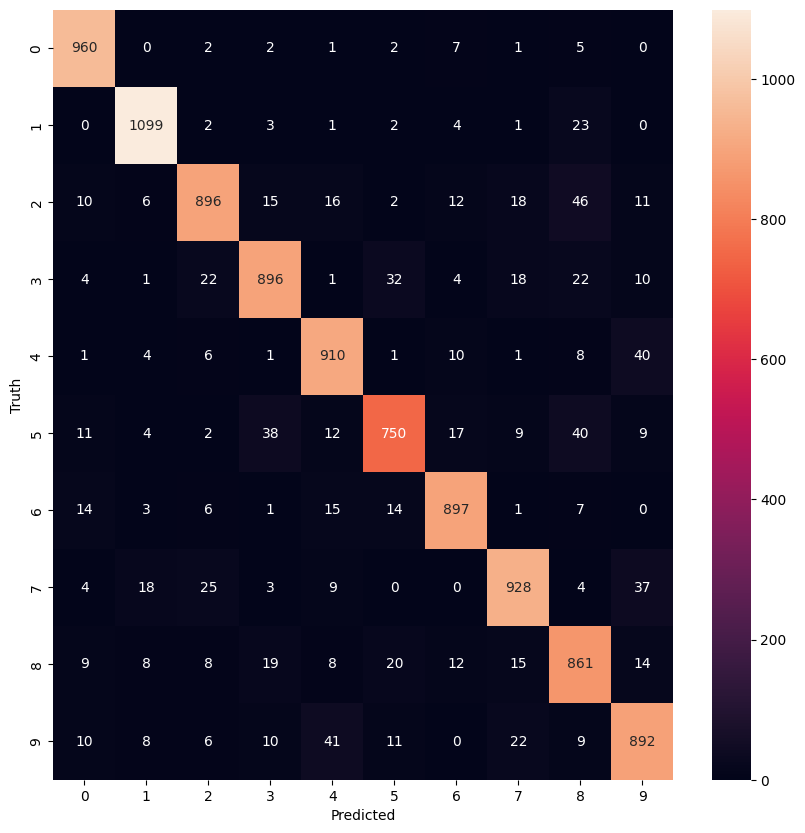

In [ ]:
import seaborn as sn
plt.figure(figsize = (10,10))
sn.heatmap(cm, annot=True, fmt='d')
plt.xlabel('Predicted')
plt.ylabel('Truth')

In [ ]:
model = keras.Sequential([
    keras.layers.Dense(100, input_shape=(784,), activation='relu'),
    keras.layers.Dense(10, activation='sigmoid') # adding one more layer
])

model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

model.fit(X_train, y_train_full, epochs=5)

/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/5
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 5s 1ms/step - accuracy: 0.8722 - loss: 0.4496
Epoch 2/5
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 3s 1ms/step - accuracy: 0.9626 - loss: 0.1300
Epoch 3/5
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - accuracy: 0.9740 - loss: 0.0876
Epoch 4/5
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 3s 1ms/step - accuracy: 0.9811 - loss: 0.0640
Epoch 5/5
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 3s 1ms/step - accuracy: 0.9857 - loss: 0.0476


In [ ]:
model.evaluate(X_test_1,y_test)

313/313 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - accuracy: 0.9715 - loss: 0.0893


[0.0763573944568634, 0.9753999710083008]

In [ ]:
y_pred_1 = model.predict(X_test_1)

313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step


Text(95.72222222222221, 0.5, 'Truth')

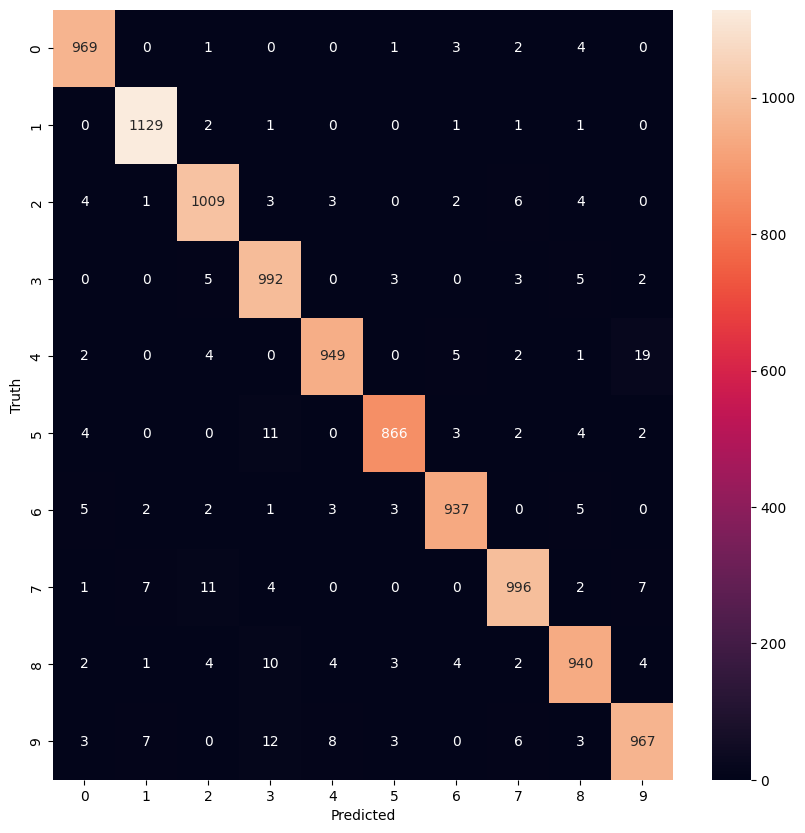

In [ ]:
cm_1 = tf.math.confusion_matrix(labels = y_test, predictions = np.argmax(y_pred_1, axis=1))
plt.figure(figsize = (10,10))
sn.heatmap(cm_1, annot=True, fmt='d')
plt.xlabel('Predicted')
plt.ylabel('Truth')

In [ ]:
model = keras.Sequential([
    keras.layers.Flatten(input_shape=(28, 28)),
    keras.layers.Dense(100, activation='relu'),
    keras.layers.Dense(10, activation='sigmoid')
])

model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

model.fit(X_train_full, y_train_full, epochs=5)

/usr/local/lib/python3.10/dist-packages/keras/src/layers/reshaping/flatten.py:37: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 1/5
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 5s 1ms/step - accuracy: 0.8729 - loss: 0.4482
Epoch 2/5
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 3s 1ms/step - accuracy: 0.9608 - loss: 0.1324
Epoch 3/5
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 3s 1ms/step - accuracy: 0.9740 - loss: 0.0875
Epoch 4/5
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 3s 1ms/step - accuracy: 0.9814 - loss: 0.0626
Epoch 5/5
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 3s 1ms/step - accuracy: 0.9859 - loss: 0.0481


In [ ]:
model.evaluate(X_test,y_test)

313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.9725 - loss: 0.0937


[0.07888732850551605, 0.9765999913215637]

In [ ]:
model.save('my_model.keras')



> Quantization in DL

Quantization is used to reduce the size of the model so that can run on EDGE devices

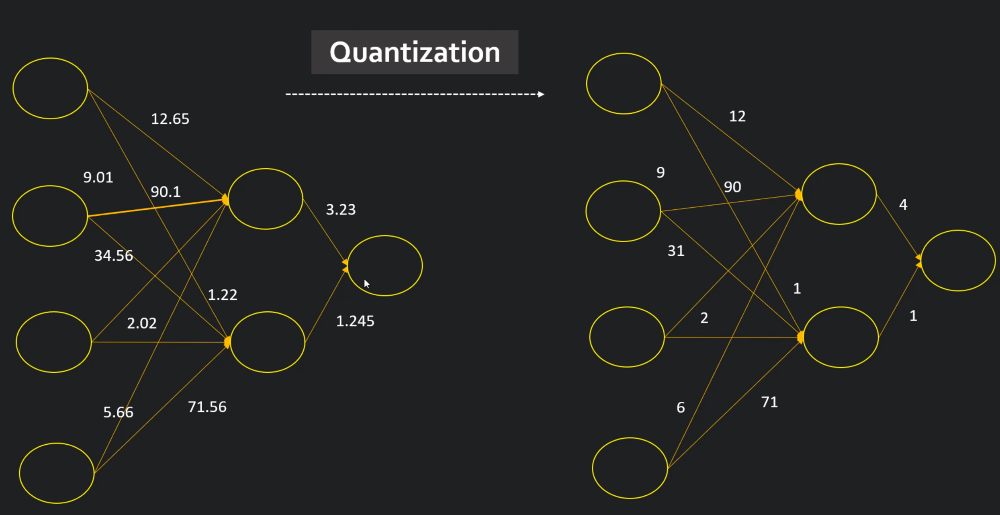

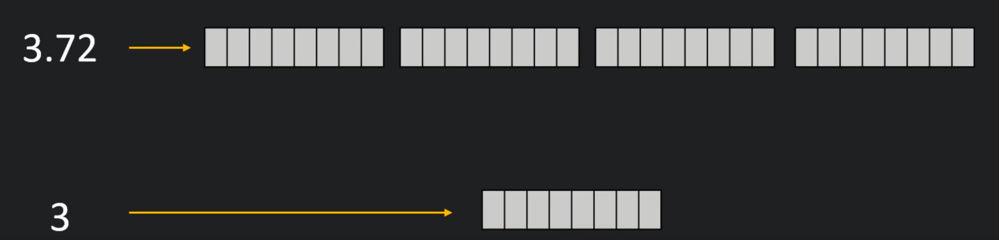

1. Post training Quantization

In [ ]:
converter = tf.lite.TFLiteConverter.from_keras_model(model)
tflite_model = converter.convert()

Saved artifact at '/tmp/tmpggtdtktf'. The following endpoints are available:

* Endpoint 'serve'
  args_0 (POSITIONAL_ONLY): TensorSpec(shape=(None, 28, 28), dtype=tf.float32, name='keras_tensor_233')
Output Type:
  TensorSpec(shape=(None, 10), dtype=tf.float32, name=None)
Captures:
  133145230680384: TensorSpec(shape=(), dtype=tf.resource, name=None)
  133145230682672: TensorSpec(shape=(), dtype=tf.resource, name=None)
  133145230674400: TensorSpec(shape=(), dtype=tf.resource, name=None)
  133145230684256: TensorSpec(shape=(), dtype=tf.resource, name=None)


In [ ]:
len(tflite_model)

319980

In [ ]:
converter = tf.lite.TFLiteConverter.from_keras_model(model)
converter.optimizations = [tf.lite.Optimize.DEFAULT]
tflite_quant_model = converter.convert()

Saved artifact at '/tmp/tmpm8tfw4ae'. The following endpoints are available:

* Endpoint 'serve'
  args_0 (POSITIONAL_ONLY): TensorSpec(shape=(None, 28, 28), dtype=tf.float32, name='keras_tensor_233')
Output Type:
  TensorSpec(shape=(None, 10), dtype=tf.float32, name=None)
Captures:
  133145230680384: TensorSpec(shape=(), dtype=tf.resource, name=None)
  133145230682672: TensorSpec(shape=(), dtype=tf.resource, name=None)
  133145230674400: TensorSpec(shape=(), dtype=tf.resource, name=None)
  133145230684256: TensorSpec(shape=(), dtype=tf.resource, name=None)


In [ ]:
len(tflite_quant_model)

86040

In [ ]:
with open("tflite_model.tflite","wb") as f:
  f.write(tflite_model)

with open("tflite_quant_model.tflite","wb") as f:
  f.write(tflite_quant_model)

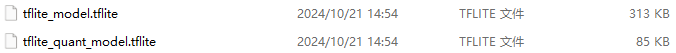

2. Quantization aware training

In [ ]:
pip install tensorflow_model_optimization

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 242.5/242.5 kB 4.8 MB/s eta 0:00:00


In [ ]:
os.environ['TF_USE_LEGACY_KERAS'] = "1"

In [ ]:
import tensorflow_model_optimization as tfmot
quantized_model = tfmot.quantization.keras.quantize_model

q_aware_model = tfmot.quantization.keras.quantize_model(model)

q_aware_model.compile(optimizer='adam',
              loss=tf.keras.losses.CategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])
q_aware_model.summary()

In [ ]:
q_aware_model.fit(X_train, y_train, epochs=1)

In [ ]:
q_aware_model.evaluate(X_test, y_test)

In [ ]:
converter = tf.lite.TFLiteConverter.from_keras_model(q_aware_model)
converter.optimizations = [tf.lite.Optimize.DEFAULT]

tflite_qaware_model = converter.convert()



> Potato Disease Classification Using CNN





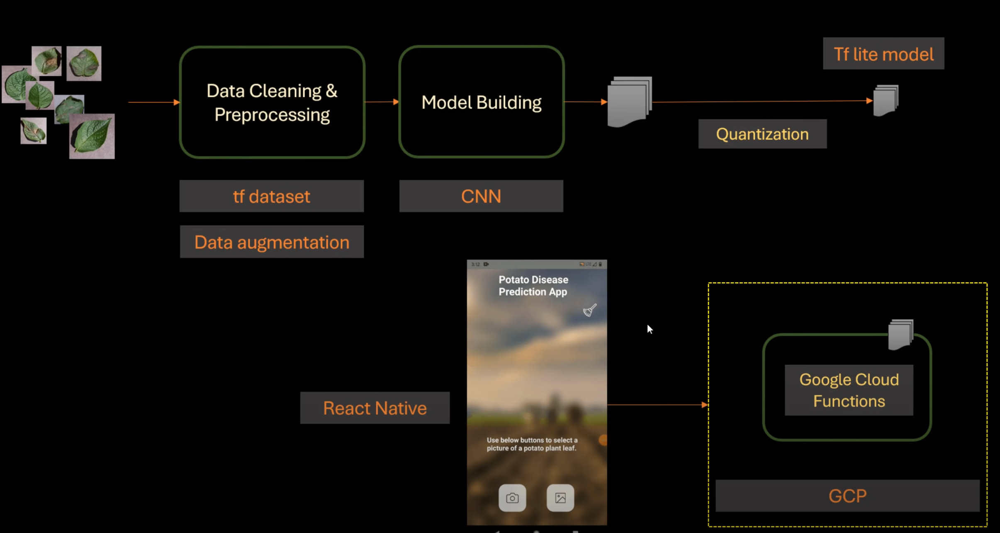

In [ ]:
import tensorflow as tf
from tensorflow.keras import models, layers
import matplotlib.pyplot as plt


In [ ]:
IMAGE_SIZE = 256
BATCH_SIZE = 32
CHANNELS = 3
EPOCHS = 50

In [ ]:
dataset = tf.keras.preprocessing.image_dataset_from_directory(
    '/content/drive/MyDrive/MD/Learning is Learning/PlantVillage/training',
    shuffle=True,
    image_size=(IMAGE_SIZE,IMAGE_SIZE),
    batch_size=BATCH_SIZE
)

Found 2152 files belonging to 3 classes.


In [ ]:
class_names = dataset.class_names
class_names

['Potato___Early_blight', 'Potato___Late_blight', 'Potato___healthy']

In [ ]:
len(dataset)

68

(32, 256, 256, 3)
[0 0 0 0 1 1 1 0 0 0 0 1 0 1 1 1 1 0 0 2 2 1 0 1 2 0 1 1 0 0 1 0]


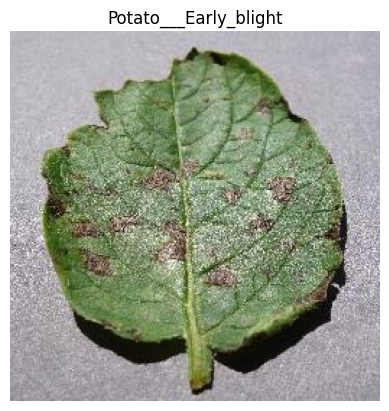

In [ ]:
for images_batch, label_batch in dataset.take(1):
  print(images_batch.shape)
  print(label_batch.numpy())
  plt.imshow(images_batch[0].numpy().astype('uint8'))
  plt.title(class_names[label_batch[0]])
  plt.axis('off')

In [ ]:
# we want
# 80% training
# 10% validation
# 10% testing
train_size = 0.8
len(dataset)*train_size

54.400000000000006

In [ ]:
train_ds = dataset.take(54)
test_ds = dataset.skip(54)

In [ ]:
val_ds = test_ds.take(6)

In [ ]:
test_ds = test_ds.skip(6)

In [ ]:
def get_dataset_partitions_tf(ds, train_split=0.8, val_split=0.1, test_split=0.1, shuffle=True, shuffle_size=10000):
  ds_size = len(ds)

  if shuffle:
    ds = ds.shuffle(shuffle_size, seed=12)

  train_size = int(train_split*ds_size)
  val_size = int(val_split*ds_size)

  train_ds = ds.take(train_size)
  val_ds = ds.skip(train_size).take(val_size)
  test_ds = ds.skip(train_size).skip(val_size)

  return train_ds, val_ds, test_ds

In [ ]:
X_train, X_val, X_test = get_dataset_partitions_tf(dataset)

In [ ]:
len(X_train), len(X_val), len(X_test)

(54, 6, 8)

Cache and prefetch for optimization

In [ ]:
#
X_train = X_train.cache().shuffle(1000).prefetch(buffer_size=tf.data.AUTOTUNE)
X_val = X_val.cache().shuffle(1000).prefetch(buffer_size=tf.data.AUTOTUNE)
X_test = X_test.cache().shuffle(1000).prefetch(buffer_size=tf.data.AUTOTUNE)

Resize and Rescaling in Tensorflow

In [ ]:
resize_rescale = tf.keras.Sequential([
    layers.Rescaling(IMAGE_SIZE, IMAGE_SIZE),
    layers.Rescaling(1./255),
])

Data Augmentation in Tensorflow

In [ ]:
data_aug = tf.keras.Sequential([
    layers.RandomFlip('horizontal_and_vertical'),
    layers.RandomRotation(0.2),
])

Model Building

In [ ]:
model = models.Sequential([
    resize_rescale,
    data_aug,
    layers.Conv2D(32, kernel_size=(3,3), activation='relu', input_shape=(IMAGE_SIZE, IMAGE_SIZE, CHANNELS)),
    layers.MaxPooling2D((2,2)),
    layers.Conv2D(64, kernel_size=(3,3), activation='relu'),
    layers.MaxPooling2D((2,2)),
    layers.Conv2D(64, kernel_size=(3,3), activation='relu'),
    layers.MaxPooling2D((2,2)),
    layers.Conv2D(64, kernel_size=(3,3), activation='relu'),
    layers.MaxPooling2D((2,2)),
    layers.Conv2D(64, kernel_size=(3,3), activation='relu'),
    layers.MaxPooling2D((2,2)),
    layers.Conv2D(64, kernel_size=(3,3), activation='relu'),
    layers.MaxPooling2D((2,2)),
    layers.Flatten(),
    layers.Dense(64, activation='relu'),
    layers.Dense(len(class_names), activation='softmax'),
])

model.build(input_shape=(BATCH_SIZE, IMAGE_SIZE, IMAGE_SIZE, CHANNELS))


/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [ ]:
model.summary()

Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ sequential (Sequential)              │ (32, 256, 256, 3)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ sequential_1 (Sequential)            │ (32, 256, 256, 3)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d (Conv2D)                      │ (32, 254, 254, 32)          │             896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (32, 127, 127, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (32, 125, 125, 64)          │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_1 (MaxPooling2D)       │ (32, 62, 62, 64)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (32, 60, 60, 64)            │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_2 (MaxPooling2D)       │ (32, 30, 30, 64)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_3 (Conv2D)                    │ (32, 28, 28, 64)            │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_3 (MaxPooling2D)       │ (32, 14, 14, 64)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_4 (Conv2D)                    │ (32, 12, 12, 64)            │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_4 (MaxPooling2D)       │ (32, 6, 6, 64)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_5 (Conv2D)                    │ (32, 4, 4, 64)              │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_5 (MaxPooling2D)       │ (32, 2, 2, 64)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (32, 256)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (32, 64)                    │          16,448 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (32, 3)                     │             195 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 183,747 (717.76 KB)

 Trainable params: 183,747 (717.76 KB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
model.compile(
    optimizer='adam',
    loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
    metrics=['accuracy']
)


In [ ]:
history = model.fit(
    X_train,
    batch_size=BATCH_SIZE,
    validation_data=X_val,
    verbose=1,
    epochs=EPOCHS
)

Epoch 1/50
54/54 ━━━━━━━━━━━━━━━━━━━━ 6s 115ms/step - accuracy: 0.4644 - loss: 2.0739 - val_accuracy: 0.5625 - val_loss: 0.8681
Epoch 2/50
54/54 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - accuracy: 0.6060 - loss: 0.8080 - val_accuracy: 0.7031 - val_loss: 0.5762
Epoch 3/50
54/54 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - accuracy: 0.7577 - loss: 0.5605 - val_accuracy: 0.7396 - val_loss: 0.6047
Epoch 4/50
54/54 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - accuracy: 0.8466 - loss: 0.3560 - val_accuracy: 0.9062 - val_loss: 0.2952
Epoch 5/50
54/54 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - accuracy: 0.8860 - loss: 0.3004 - val_accuracy: 0.8177 - val_loss: 0.4855
Epoch 6/50
54/54 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - accuracy: 0.9077 - loss: 0.2381 - val_accuracy: 0.9583 - val_loss: 0.1333
Epoch 7/50
54/54 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - accuracy: 0.9045 - loss: 0.2529 - val_accuracy: 0.9427 - val_loss: 0.1575
Epoch 8/50
54/54 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.8774 - loss: 0.3130 - val_accuracy: 0.8958 - 

In [ ]:
scores = model.evaluate(X_test)

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.9991 - loss: 0.0038     


In [ ]:
scores

[0.014527838677167892, 0.99609375]

In [ ]:
history.params

{'verbose': 1, 'epochs': 50, 'steps': 54}

In [ ]:
history.history.keys()

dict_keys(['accuracy', 'loss', 'val_accuracy', 'val_loss'])

In [ ]:
history.history['accuracy'][-5:]

[0.9826388955116272,
 0.9751157164573669,
 0.9872685074806213,
 0.9866898059844971,
 0.9947916865348816]

In [ ]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

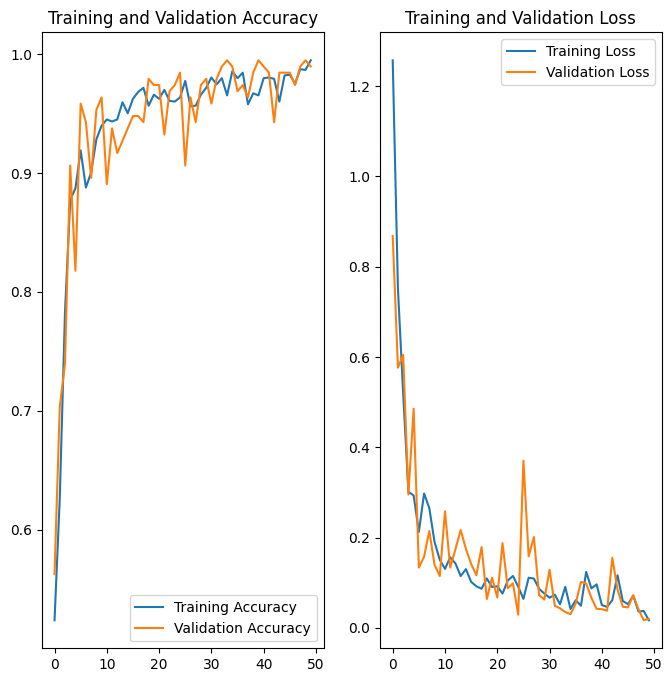

In [ ]:
plt.figure(figsize=(8,8))
plt.subplot(1,2,1)
plt.plot(range(EPOCHS), acc, label='Training Accuracy')
plt.plot(range(EPOCHS), val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1,2,2)
plt.plot(range(EPOCHS), loss, label='Training Loss')
plt.plot(range(EPOCHS), val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

first image to predict
actual label:  Potato___Early_blight
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
predicted label:  Potato___Early_blight


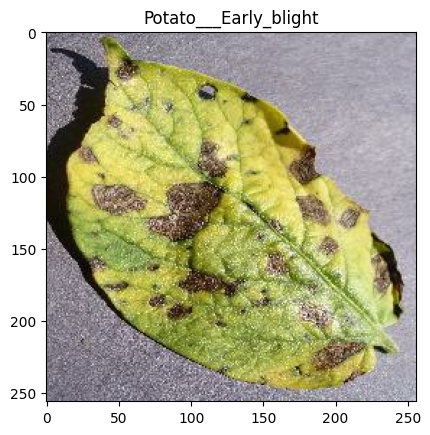

In [ ]:
import numpy as np
for images_batch, label_batch in X_test.take(1):
  first_image = images_batch[0].numpy().astype('uint8')
  first_label = label_batch[0].numpy()
  print("first image to predict")
  print("actual label: ", class_names[first_label])
  plt.imshow(first_image)
  plt.title(class_names[first_label])

  batch_prediction = model.predict(images_batch)
  print("predicted label: ", class_names[np.argmax(batch_prediction[0])])

In [ ]:
def predict(model, img):
  img_array = tf.keras.preprocessing.image.img_to_array(images[i].numpy())
  img_array = tf.expand_dims(img_array, 0)

  predictions = model.predict(img_array)

  predicted_class = class_names[np.argmax(predictions[0])]
  confidence = round(100*(np.max(predictions[0])), 2)
  return predicted_class, confidence

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


<ipython-input-60-c285c1c571d1>:4: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax = plt.subplot(3,3,i+1)


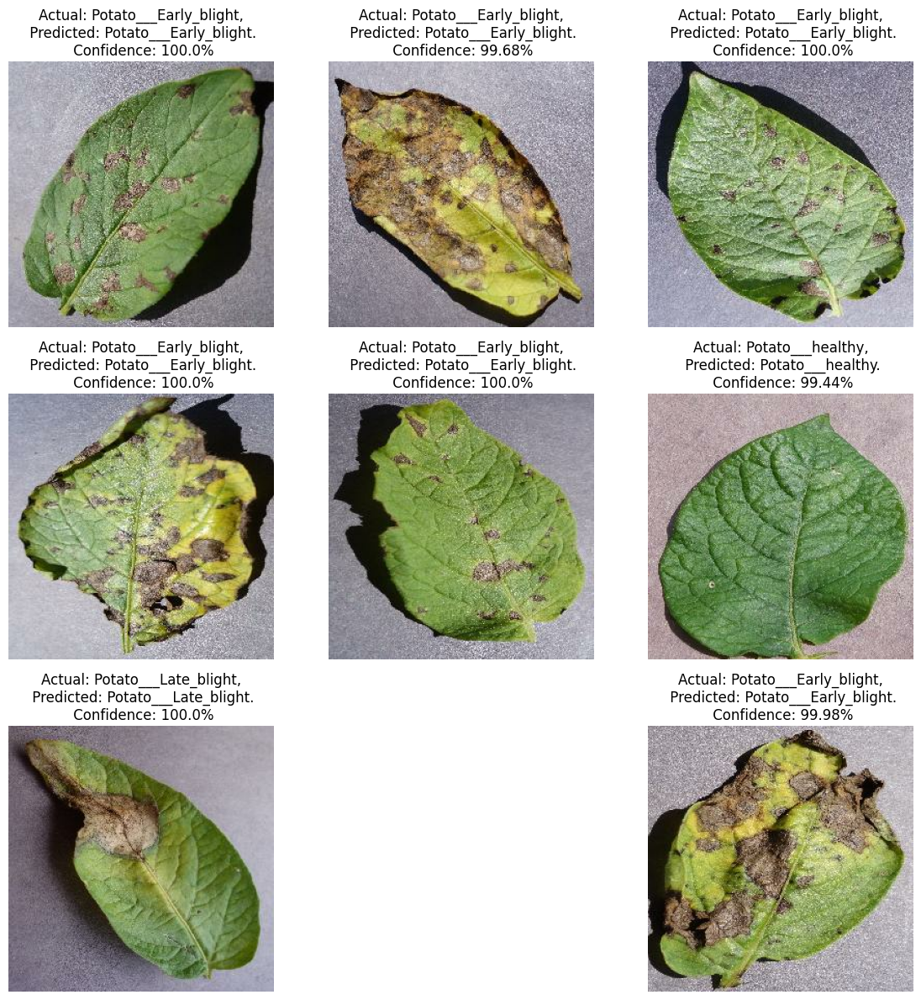

In [ ]:
plt.figure(figsize=(12,12))
for images, labels in test_ds.take(1):
  for i in range(9):
    ax = plt.subplot(3,3,i+1)
    plt.imshow(images[i].numpy().astype('uint8'))
    plt.axis('off')
    predicted_class, confidence = predict(model, images[i].numpy())
    actual_class = class_names[labels[i]]
    plt.title(f"Actual: {actual_class},\n Predicted: {predicted_class}.\n Confidence: {confidence}%")
    plt.tight_layout()

In [ ]:
# Optional
import os
model_version = max([int(i) for i in os.listdir("/content/drive/MyDrive/MD/Learning is Learning/PlantVillage/Model") + [0]]) + 1
# Added the .keras extension to the file path
model.save(f"/content/drive/MyDrive/MD/Learning is Learning/PlantVillage/Model/{model_version}.keras")

Image Data Generator

In [ ]:
import tensorflow as tf
from tensorflow.keras import models, layers
import matplotlib.pyplot as plt
from IPython.display import HTML

from tensorflow.keras.preprocessing.image import ImageDataGenerator

In [ ]:
pip install split_folders

In [ ]:
import splitfolders
splitfolders.ratio('/content/drive/MyDrive/MD/Learning is Learning/PlantVillage/training', output="/content/drive/MyDrive/MD/Learning is Learning/PlantVillage/dataset", seed=1337, ratio=(.7, .1, .2))

Copying files: 2152 files [00:31, 68.14 files/s]


In [ ]:
train_datagen = ImageDataGenerator(
    rescale=1./255,
    horizontal_flip = True,
    rotation_range = 10
)

In [ ]:
train_generator = train_datagen.flow_from_directory(
    '/content/drive/MyDrive/MD/Learning is Learning/PlantVillage/dataset/train',
    target_size=(IMAGE_SIZE,IMAGE_SIZE),
    batch_size=BATCH_SIZE,
    class_mode='sparse',
    #save_to_dir = "/content/drive/MyDrive/MD/Learning is Learning/PlantVillage/dataset/Augmented"
)

Found 1506 images belonging to 3 classes.


In [ ]:
save_dir = "/content/drive/MyDrive/MD/Learning is Learning/PlantVillage/dataset/Augmented"
if not os.path.exists(save_dir):
    os.makedirs(save_dir)

In [ ]:
for images_batch,label_batch in train_generator:
  print(images_batch.shape)
  print(label_batch.shape)
  break

(32, 256, 256, 3)
(32,)


In [ ]:
validation_datagen = ImageDataGenerator(
    rescale=1./255,
    horizontal_flip = True,
    rotation_range = 10
)

validation_generator = validation_datagen.flow_from_directory(
    '/content/drive/MyDrive/MD/Learning is Learning/PlantVillage/dataset/val',
    target_size=(IMAGE_SIZE,IMAGE_SIZE),
    batch_size=BATCH_SIZE,
    class_mode='sparse',
)

Found 215 images belonging to 3 classes.


In [ ]:
test_datagen = ImageDataGenerator(
    rescale=1./255,
    horizontal_flip = True,
    rotation_range = 10
)

test_generator = test_datagen.flow_from_directory(
    '/content/drive/MyDrive/MD/Learning is Learning/PlantVillage/dataset/test',
    target_size=(IMAGE_SIZE,IMAGE_SIZE),
    batch_size=BATCH_SIZE,
    class_mode='sparse',
)

Found 431 images belonging to 3 classes.


In [ ]:
model = models.Sequential([
    layers.InputLayer(shape=(IMAGE_SIZE, IMAGE_SIZE, CHANNELS)),
    layers.Conv2D(32, kernel_size=(3,3), activation='relu'),
    layers.MaxPooling2D((2,2)),
    layers.Conv2D(64, kernel_size=(3,3), activation='relu'),
    layers.MaxPooling2D((2,2)),
    layers.Conv2D(64, kernel_size=(3,3), activation='relu'),
    layers.MaxPooling2D((2,2)),
    layers.Conv2D(64, kernel_size=(3,3), activation='relu'),
    layers.MaxPooling2D((2,2)),
    layers.Conv2D(64, kernel_size=(3,3), activation='relu'),
    layers.MaxPooling2D((2,2)),
    layers.Conv2D(64, kernel_size=(3,3), activation='relu'),
    layers.MaxPooling2D((2,2)),
    layers.Flatten(),
    layers.Dense(64, activation='relu'),
    layers.Dense(len(class_names), activation='softmax'),
])


In [ ]:
model.summary()

Model: "sequential_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_12 (Conv2D)                   │ (None, 254, 254, 32)        │             896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_12 (MaxPooling2D)      │ (None, 127, 127, 32)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_13 (Conv2D)                   │ (None, 125, 125, 64)        │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_13 (MaxPooling2D)      │ (None, 62, 62, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_14 (Conv2D)                   │ (None, 60, 60, 64)          │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_14 (MaxPooling2D)      │ (None, 30, 30, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_15 (Conv2D)                   │ (None, 28, 28, 64)          │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_15 (MaxPooling2D)      │ (None, 14, 14, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_16 (Conv2D)                   │ (None, 12, 12, 64)          │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_16 (MaxPooling2D)      │ (None, 6, 6, 64)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_17 (Conv2D)                   │ (None, 4, 4, 64)            │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_17 (MaxPooling2D)      │ (None, 2, 2, 64)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_2 (Flatten)                  │ (None, 256)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_4 (Dense)                      │ (None, 64)                  │          16,448 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_5 (Dense)                      │ (None, 3)                   │             195 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 183,747 (717.76 KB)

 Trainable params: 183,747 (717.76 KB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
model.compile(
    optimizer='adam',
    loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
    metrics=['accuracy']
)

In [ ]:
history_g = model.fit(
    train_generator,
    steps_per_epoch= 47, # 1506/32
    batch_size=BATCH_SIZE,
    validation_data=validation_generator,
    validation_steps = 6, # 215/32
    verbose=1,
    epochs=20
)

Epoch 1/20
47/47 ━━━━━━━━━━━━━━━━━━━━ 26s 488ms/step - accuracy: 0.9220 - loss: 0.2101 - val_accuracy: 0.8958 - val_loss: 0.2638
Epoch 2/20
 1/47 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - accuracy: 0.8750 - loss: 0.3932

/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.8750 - loss: 0.3932 - val_accuracy: 0.9130 - val_loss: 0.2535
Epoch 3/20
47/47 ━━━━━━━━━━━━━━━━━━━━ 25s 467ms/step - accuracy: 0.9156 - loss: 0.1996 - val_accuracy: 0.9062 - val_loss: 0.2226
Epoch 4/20
47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.9688 - loss: 0.1093 - val_accuracy: 0.9565 - val_loss: 0.1261
Epoch 5/20
47/47 ━━━━━━━━━━━━━━━━━━━━ 26s 475ms/step - accuracy: 0.9316 - loss: 0.1680 - val_accuracy: 0.9375 - val_loss: 0.1551
Epoch 6/20
47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 1.0000 - loss: 0.0049 - val_accuracy: 0.9130 - val_loss: 0.2310
Epoch 7/20
47/47 ━━━━━━━━━━━━━━━━━━━━ 25s 466ms/step - accuracy: 0.9432 - loss: 0.1432 - val_accuracy: 0.9271 - val_loss: 0.1667
Epoch 8/20
47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 1.0000 - loss: 0.0742 - val_accuracy: 0.9565 - val_loss: 0.1376
Epoch 9/20
47/47 ━━━━━━━━━━━━━━━━━━━━ 25s 471ms/step - accuracy: 0.9405 - loss: 0.1560 - val_accuracy: 0.9115 - val_loss

In [ ]:
scores = model.evaluate(test_generator)

/usr/local/lib/python3.10/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


14/14 ━━━━━━━━━━━━━━━━━━━━ 7s 527ms/step - accuracy: 0.9011 - loss: 0.2546


In [ ]:
scores

[0.2525695562362671, 0.9025521874427795]

In [ ]:
acc_g = history_g.history['accuracy']
val_acc_g = history_g.history['val_accuracy']

loss_g = history_g.history['loss']
val_loss_g = history_g.history['val_loss']

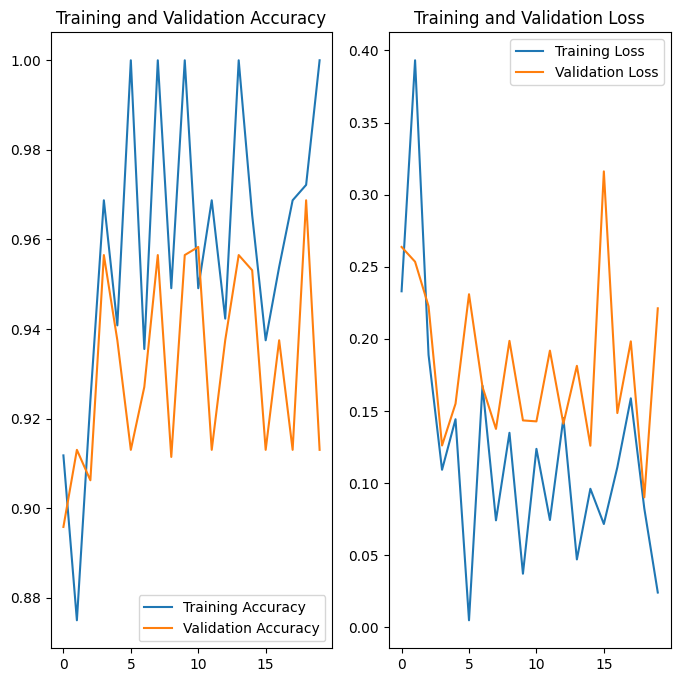

In [ ]:
plt.figure(figsize=(8,8))
plt.subplot(1,2,1)
plt.plot(range(20), acc_g, label='Training Accuracy')
plt.plot(range(20), val_acc_g, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1,2,2)
plt.plot(range(20), loss_g, label='Training Loss')
plt.plot(range(20), val_loss_g, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

first image to predict


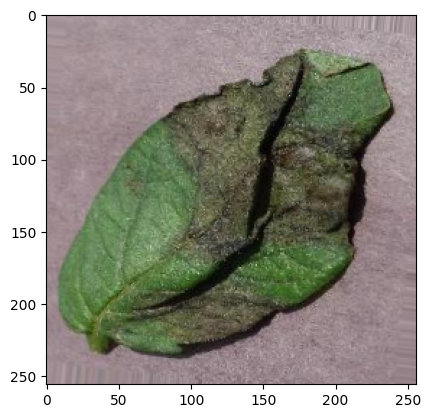

actual label:  Potato___Late_blight
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 413ms/step
predicted label:  Potato___Late_blight


In [ ]:
import numpy as np
import matplotlib.pyplot as plt # Make sure to import pyplot

for image_batch_g, label_batch_g in test_generator:
  first_image_g = image_batch_g[0]
  first_label_g = int(label_batch_g[0])

  print("first image to predict")
  plt.imshow(first_image_g) # Changed plt.show() to plt.imshow() to display the image
  plt.show() # Call plt.show() without arguments to display the figure
  print("actual label: ", class_names[first_label_g])

  batch_prediction_g = model.predict(image_batch_g)
  print("predicted label: ", class_names[np.argmax(batch_prediction_g[0])])
  break

In [ ]:
def predict(model, img):
  img_array = tf.keras.preprocessing.image.img_to_array(images[i])
  img_array = tf.expand_dims(img_array, 0)

  predictions = model.predict(img_array)

  predicted_class = class_names[np.argmax(predictions[0])]
  confidence = round(100*(np.max(predictions[0])), 2)
  return predicted_class, confidence

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


<ipython-input-123-72dbbe564a12>:4: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax = plt.subplot(3,3,i+1)


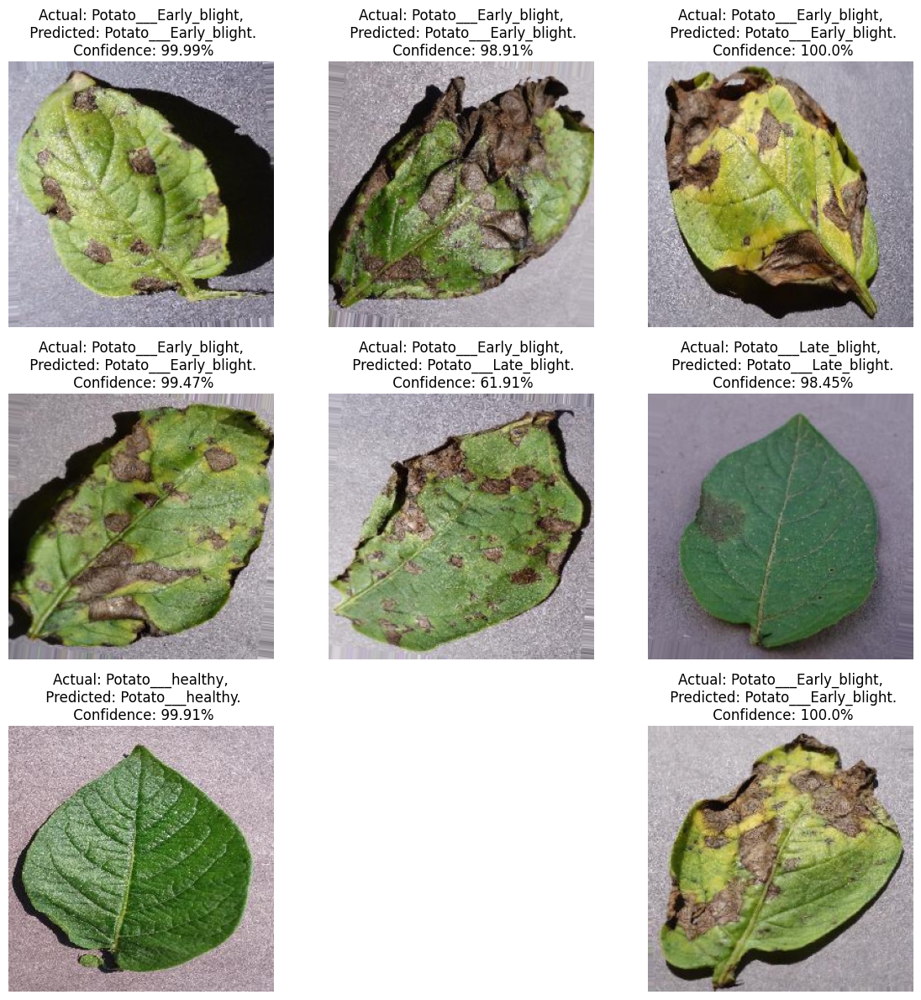

In [ ]:
plt.figure(figsize=(12,12))
for images, labels in test_generator:
  for i in range(9):
    ax = plt.subplot(3,3,i+1)
    plt.imshow(images[i])
    plt.axis('off')
    predicted_class, confidence = predict(model, images[i])
    actual_class = class_names[int(labels[i])]
    plt.title(f"Actual: {actual_class},\n Predicted: {predicted_class}.\n Confidence: {confidence}%")
    plt.tight_layout()

  break

In [ ]:
model.save("/content/drive/MyDrive/MD/Learning is Learning/PlantVillage/Model/model.h5")

### Checking GPU


In [ ]:
import tensorflow as tf
from tensorflow import keras
from matplotlib import pyplot as plt
import numpy as np
import pandas as pd

In [ ]:
tf.config.list_physical_devices()

[PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU'),
 PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

In [ ]:
tf.test.is_built_with_cuda()

True

In [ ]:
(X_train_full, y_train_full), (X_test, y_test) = keras.datasets.cifar10.load_data()

170498071/170498071 ━━━━━━━━━━━━━━━━━━━━ 4s 0us/step


In [ ]:
X_train_full.shape

(50000, 32, 32, 3)

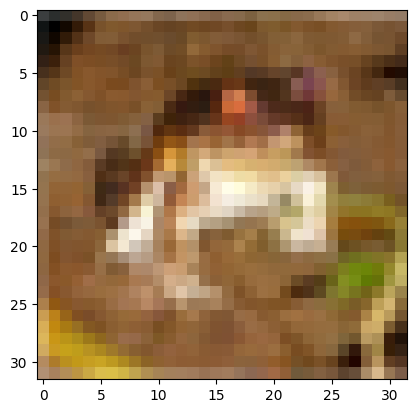

In [ ]:
plt.imshow(X_train_full[0])

In [ ]:
X_train_scaled = X_train_full / 255
X_test_scaled = X_test / 255

In [ ]:
y_train_full[0]

array([6], dtype=uint8)

In [ ]:
y_train_categorical = keras.utils.to_categorical(
    y_train_full, num_classes=10
)
y_test_categorical = keras.utils.to_categorical(
    y_test, num_classes=10
)

In [ ]:
model = keras.Sequential([
    keras.layers.Flatten(input_shape=(32,32,3)),# flatten into one dimension vector
    keras.layers.Dense(3000, activation='relu'),
    keras.layers.Dense(1000, activation='relu'),
    keras.layers.Dense(10, activation='sigmoid')
])

model.compile(optimizer='SGD',
              loss='categorical_crossentropy', # One-Hot
              metrics=['accuracy'])

model.fit(X_train_scaled, y_train_categorical, epochs=50)

Epoch 1/50
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 10s 5ms/step - accuracy: 0.3033 - loss: 1.9315
Epoch 2/50
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - accuracy: 0.4204 - loss: 1.6394
Epoch 3/50
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - accuracy: 0.4511 - loss: 1.5534
Epoch 4/50
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - accuracy: 0.4762 - loss: 1.4861
Epoch 5/50
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - accuracy: 0.4914 - loss: 1.4464
Epoch 6/50
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - accuracy: 0.5092 - loss: 1.3947
Epoch 7/50
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - accuracy: 0.5232 - loss: 1.3600
Epoch 8/50
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - accuracy: 0.5425 - loss: 1.3149
Epoch 9/50
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - accuracy: 0.5491 - loss: 1.2864
Epoch 10/50
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - accuracy: 0.5579 - loss: 1.2577
Epoch 11/50
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - accuracy: 0.5695 - loss: 1.2237
Epoch 12/50
1563/1563 ━━━━━━━

In [ ]:
model.evaluate(X_test_scaled,y_test_categorical)

313/313 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - accuracy: 0.5541 - loss: 1.5931


[1.6012988090515137, 0.5508999824523926]

In [ ]:
classes = ["airplane","automobile","bird","cat","deer","dog","frog","horse","ship","truck"]

In [ ]:
classes[y_test[0][0]]

'cat'

In [ ]:
y_pred_0 = model.predict(X_test_scaled)[0]
np.argmax(y_pred_0)

313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step


3

In [ ]:
classes[np.argmax(y_pred_0)]

'cat'

In [ ]:
def get_model():
    model = keras.Sequential([
    keras.layers.Flatten(input_shape=(32,32,3)),# flatten into one dimension vector
    keras.layers.Dense(3000, activation='relu'),
    keras.layers.Dense(1000, activation='relu'),
    keras.layers.Dense(10, activation='sigmoid')
])

    model.compile(optimizer='SGD',
                  loss='categorical_crossentropy', # One-Hot
                  metrics=['accuracy'])
    return model


In [ ]:
import time

with tf.device('/CPU:0'):
  model = get_model()
  model.fit(X_train_scaled, y_train_categorical, epochs=1)
  time_cpu = time.time()

/usr/local/lib/python3.10/dist-packages/keras/src/layers/reshaping/flatten.py:37: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1563/1563 ━━━━━━━━━━━━━━━━━━━━ 141s 89ms/step - accuracy: 0.3040 - loss: 1.9362


In [ ]:
with tf.device('/GPU:0'):
  model = get_model()
  model.fit(X_train_scaled, y_train_categorical, epochs=1)
  time_gpu = time.time()

1563/1563 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - accuracy: 0.3036 - loss: 1.9319




---





> Distributed Training



In [ ]:
import tensorflow as tf
from tensorflow import keras
import numpy as np

In [ ]:
(X_train,y_train),(X_test,y_test) = tf.keras.datasets.cifar10.load_data()

170498071/170498071 ━━━━━━━━━━━━━━━━━━━━ 2s 0us/step


In [ ]:
tf.config.experimental.list_physical_devices()

[PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU'),
 PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

In [ ]:
classes = ["airplane","automobile","bird","cat","deer","dog","frog","horse","ship","truck"]

In [ ]:
y_train[:5]

array([[6],
       [9],
       [9],
       [4],
       [1]], dtype=uint8)

In [ ]:
X_train_scaled = X_train / 255
X_test_scaled = X_test / 255

In [ ]:
y_train_categorical = keras.utils.to_categorical(
    y_train, num_classes=10,
)
y_test_categorical = keras.utils.to_categorical(
    y_test, num_classes=10,
)

In [ ]:
def get_model():
    model = keras.Sequential([
    keras.layers.Flatten(input_shape=(32,32,3)),# flatten into one dimension vector
    keras.layers.Dense(3000, activation='relu'),
    keras.layers.Dense(1000, activation='relu'),
    keras.layers.Dense(10, activation='sigmoid')
])

    model.compile(optimizer='SGD',
                  loss='categorical_crossentropy', # One-Hot
                  metrics=['accuracy'])
    return model

In [ ]:
train_tf_dataset = tf.data.Dataset.from_tensor_slices((X_train_scaled, y_train_categorical))
test_tf_dataset = tf.data.Dataset.from_tensor_slices((X_test_scaled, y_test_categorical))

In [ ]:
type(train_tf_dataset)

tensorflow.python.data.ops.from_tensor_slices_op._TensorSliceDataset

In [ ]:
strategy = tf.distribute.MirroredStrategy()

In [ ]:
strategy.num_replicas_in_sync

1

In [ ]:
BATCH_SIZE_PER_REPLICA = 250
BATCH_SIZE = BATCH_SIZE_PER_REPLICA * strategy.num_replicas_in_sync

In [ ]:
train_dataset = train_tf_dataset.batch(BATCH_SIZE).prefetch(tf.data.AUTOTUNE)
test_dataset = test_tf_dataset.batch(BATCH_SIZE)

In [ ]:
%%timeit -n1 -r1
with strategy.scope():
  gpu_model = get_model()
  gpu_model.fit(train_dataset, epochs=50)

/usr/local/lib/python3.10/dist-packages/keras/src/layers/reshaping/flatten.py:37: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 1/50
200/200 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - accuracy: 0.2505 - loss: 2.0869
Epoch 2/50
200/200 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.3577 - loss: 1.8305
Epoch 3/50
200/200 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.3875 - loss: 1.7580
Epoch 4/50
200/200 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.4070 - loss: 1.7108
Epoch 5/50
200/200 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.4192 - loss: 1.6743
Epoch 6/50
200/200 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.4301 - loss: 1.6440
Epoch 7/50
200/200 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.4397 - loss: 1.6179
Epoch 8/50
200/200 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.4481 - loss: 1.5947
Epoch 9/50
200/200 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.4552 - loss: 1.5741
Epoch 10/50
200/200 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.4607 - loss: 1.5555
Epoch 11/50
200/200 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.4674 - loss: 1.5387
Epoch 12/50
200/200 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step



---
Exercise

In [ ]:
import tensorflow as tf
from tensorflow import keras
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
fashion_mnist = keras.datasets.fashion_mnist
(train_images, train_labels), (test_images, test_labels) = fashion_mnist.load_data()

29515/29515 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
26421880/26421880 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
5148/5148 ━━━━━━━━━━━━━━━━━━━━ 0s 1us/step
4422102/4422102 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


In [ ]:
class_names = ['T-shirt/top', 'Trouser', 'Pullover', 'Dress', 'Coat',
               'Sandal', 'Shirt', 'Sneaker', 'Bag', 'Ankle boot']

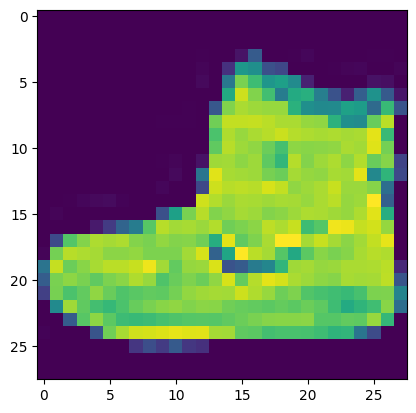

In [ ]:
plt.imshow(train_images[0])

In [ ]:
train_images.shape

(60000, 28, 28)

In [ ]:
train_images_scaled = train_images / 255.0
test_images_scaled = test_images / 255.0

In [ ]:
def get_model(hidden_layers=1):
    # Flatten layer for input
    layers = [keras.layers.Flatten(input_shape=(28, 28))]
    # hideen layers
    for i in range(hidden_layers):
        layers.append(keras.layers.Dense(500, activation='relu'),)
    # output layer
    layers.append(keras.layers.Dense(10, activation='sigmoid'))

    model = keras.Sequential(layers)

    model.compile(optimizer='adam',
                  loss='sparse_categorical_crossentropy',
                  metrics=['accuracy'])

    return model

In [ ]:
model = get_model(1)
model.fit(train_images_scaled, train_labels, epochs=5)

/usr/local/lib/python3.10/dist-packages/keras/src/layers/reshaping/flatten.py:37: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 1/5
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - accuracy: 0.7924 - loss: 0.5906
Epoch 2/5
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 7s 3ms/step - accuracy: 0.8674 - loss: 0.3626
Epoch 3/5
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - accuracy: 0.8825 - loss: 0.3269
Epoch 4/5
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - accuracy: 0.8917 - loss: 0.2942
Epoch 5/5
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - accuracy: 0.8932 - loss: 0.2837


In [ ]:
y_pred_2 = model.predict(test_images_scaled)[2]

313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step


In [ ]:
np.argmax(y_pred_2)

1

In [ ]:
test_labels[2]

1

In [ ]:
%%timeit -n1 -r1
with tf.device('/CPU:0'):
    model = get_model(1)
    model.fit(train_images_scaled, train_labels, epochs=5)

In [ ]:
%%timeit -n1 -r1
with tf.device('/GPU:0'):
    model = get_model(1)
    model.fit(train_images_scaled, train_labels, epochs=5)

/usr/local/lib/python3.10/dist-packages/keras/src/layers/reshaping/flatten.py:37: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 1/5
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - accuracy: 0.7919 - loss: 0.5925
Epoch 2/5
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - accuracy: 0.8643 - loss: 0.3729
Epoch 3/5
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - accuracy: 0.8818 - loss: 0.3221
Epoch 4/5
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - accuracy: 0.8890 - loss: 0.2987
Epoch 5/5
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - accuracy: 0.8955 - loss: 0.2792
30.8 s ± 0 ns per loop (mean ± std. dev. of 1 run, 1 loop each)


In [ ]:
%%timeit -n1 -r1
with tf.device('/CPU:0'):
    model = get_model(5)
    model.fit(train_images_scaled, train_labels, epochs=5)

In [ ]:
%%timeit -n1 -r1
with tf.device('/GPU:0'):
    model = get_model(5)
    model.fit(train_images_scaled, train_labels, epochs=5)

Epoch 1/5
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 7s 3ms/step - accuracy: 0.7703 - loss: 0.6305
Epoch 2/5
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - accuracy: 0.8557 - loss: 0.4008
Epoch 3/5
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - accuracy: 0.8723 - loss: 0.3609
Epoch 4/5
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - accuracy: 0.8815 - loss: 0.3233
Epoch 5/5
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 9s 2ms/step - accuracy: 0.8907 - loss: 0.3015
32.8 s ± 0 ns per loop (mean ± std. dev. of 1 run, 1 loop each)


### Customer churn prediction


In [ ]:
import pandas as pd
from matplotlib import pyplot as plt
import numpy as np
%matplotlib inline

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/MD/Learning is Learning/customer_churn.csv')
df.head()

,customerID,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,...,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
0,7590-VHVEG,Female,0,Yes,No,1,No,No phone service,DSL,No,...,No,No,No,No,Month-to-month,Yes,Electronic check,29.85,29.85,No
1,5575-GNVDE,Male,0,No,No,34,Yes,No,DSL,Yes,...,Yes,No,No,No,One year,No,Mailed check,56.95,1889.5,No
2,3668-QPYBK,Male,0,No,No,2,Yes,No,DSL,Yes,...,No,No,No,No,Month-to-month,Yes,Mailed check,53.85,108.15,Yes
3,7795-CFOCW,Male,0,No,No,45,No,No phone service,DSL,Yes,...,Yes,Yes,No,No,One year,No,Bank transfer (automatic),42.30,1840.75,No
4,9237-HQITU,Female,0,No,No,2,Yes,No,Fiber optic,No,...,No,No,No,No,Month-to-month,Yes,Electronic check,70.70,151.65,Yes


In [ ]:
df.drop('customerID',axis='columns',inplace=True)

In [ ]:
df.head()

,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
0,Female,0,Yes,No,1,No,No phone service,DSL,No,Yes,No,No,No,No,Month-to-month,Yes,Electronic check,29.85,29.85,No
1,Male,0,No,No,34,Yes,No,DSL,Yes,No,Yes,No,No,No,One year,No,Mailed check,56.95,1889.5,No
2,Male,0,No,No,2,Yes,No,DSL,Yes,Yes,No,No,No,No,Month-to-month,Yes,Mailed check,53.85,108.15,Yes
3,Male,0,No,No,45,No,No phone service,DSL,Yes,No,Yes,Yes,No,No,One year,No,Bank transfer (automatic),42.30,1840.75,No
4,Female,0,No,No,2,Yes,No,Fiber optic,No,No,No,No,No,No,Month-to-month,Yes,Electronic check,70.70,151.65,Yes


In [ ]:
df.TotalCharges.values

array(['29.85', '1889.5', '108.15', ..., '346.45', '306.6', '6844.5'],
      dtype=object)

In [ ]:
df.MonthlyCharges.values

array([ 29.85,  56.95,  53.85, ...,  29.6 ,  74.4 , 105.65])

In [ ]:
pd.to_numeric(df.TotalCharges)

ValueError: Unable to parse string " " at position 488

In [ ]:
pd.to_numeric(df.TotalCharges, errors='coerce').isnull()

,TotalCharges
0,False
1,False
2,False
3,False
4,False
...,...
7038,False
7039,False
7040,False
7041,False


In [ ]:
df[pd.to_numeric(df.TotalCharges, errors='coerce').isnull()]

,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
488,Female,0,Yes,Yes,0,No,No phone service,DSL,Yes,No,Yes,Yes,Yes,No,Two year,Yes,Bank transfer (automatic),52.55,,No
753,Male,0,No,Yes,0,Yes,No,No,No internet service,No internet service,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,20.25,,No
936,Female,0,Yes,Yes,0,Yes,No,DSL,Yes,Yes,Yes,No,Yes,Yes,Two year,No,Mailed check,80.85,,No
1082,Male,0,Yes,Yes,0,Yes,Yes,No,No internet service,No internet service,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,25.75,,No
1340,Female,0,Yes,Yes,0,No,No phone service,DSL,Yes,Yes,Yes,Yes,Yes,No,Two year,No,Credit card (automatic),56.05,,No
3331,Male,0,Yes,Yes,0,Yes,No,No,No internet service,No internet service,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,19.85,,No
3826,Male,0,Yes,Yes,0,Yes,Yes,No,No internet service,No internet service,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,25.35,,No
4380,Female,0,Yes,Yes,0,Yes,No,No,No internet service,No internet service,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,20.00,,No
5218,Male,0,Yes,Yes,0,Yes,No,No,No internet service,No internet service,No internet service,No internet service,No internet service,No internet service,One year,Yes,Mailed check,19.70,,No
6670,Female,0,Yes,Yes,0,Yes,Yes,DSL,No,Yes,Yes,Yes,Yes,No,Two year,No,Mailed check,73.35,,No


In [ ]:
df[pd.to_numeric(df.TotalCharges, errors='coerce').isnull()].shape

(11, 20)

In [ ]:
df.shape

(7043, 20)

In [ ]:
df.iloc[488].TotalCharges

' '

In [ ]:
df1 = df[df.TotalCharges!=' ']
df1.shape

(7032, 20)

In [ ]:
pd.to_numeric(df1.TotalCharges)

,TotalCharges
0,29.85
1,1889.50
2,108.15
3,1840.75
4,151.65
...,...
7038,1990.50
7039,7362.90
7040,346.45
7041,306.60


In [ ]:
df1.TotalCharges = pd.to_numeric(df1.TotalCharges)

<ipython-input-15-b67e0c3d31a6>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.TotalCharges = pd.to_numeric(df1.TotalCharges)


In [ ]:
df1.TotalCharges.dtypes # now we change object to float

dtype('float64')

In [ ]:
df1[df1.Churn == 'No'].tenure

,tenure
0,1
1,34
3,45
6,22
7,10
...,...
7037,72
7038,24
7039,72
7040,11


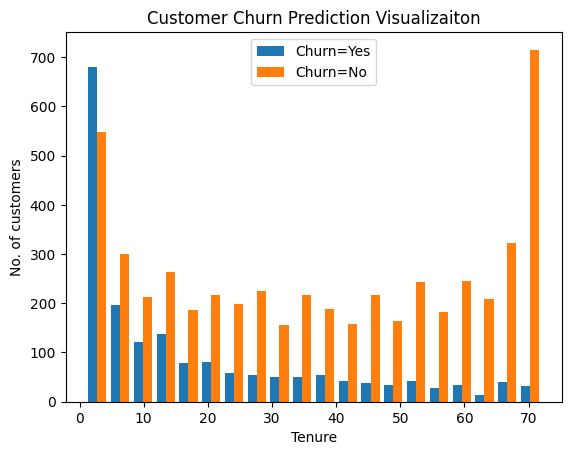

In [ ]:
tenure_churn_no = df1[df1.Churn == 'No'].tenure
tenure_churn_yes = df1[df1.Churn == 'Yes'].tenure

plt.hist([tenure_churn_yes, tenure_churn_no], bins=20, label=['Churn=Yes', 'Churn=No'])
plt.xlabel('Tenure')
plt.ylabel('No. of customers')
plt.title('Customer Churn Prediction Visualizaiton')
plt.legend()

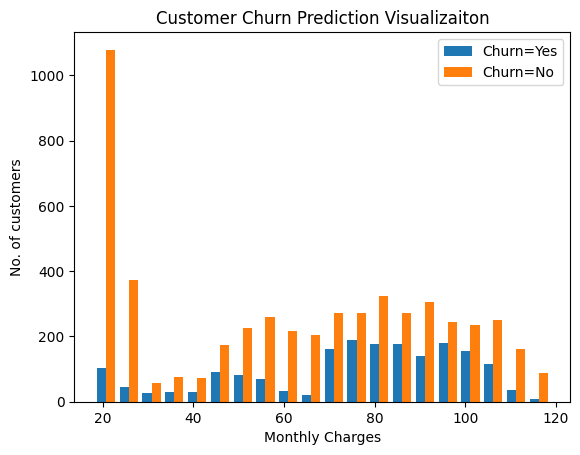

In [ ]:
mc_churn_no = df1[df1.Churn == 'No'].MonthlyCharges
mc_churn_yes = df1[df1.Churn == 'Yes'].MonthlyCharges

plt.hist([mc_churn_yes, mc_churn_no], bins=20, label=['Churn=Yes', 'Churn=No'])
plt.xlabel('Monthly Charges')
plt.ylabel('No. of customers')
plt.title('Customer Churn Prediction Visualizaiton')
plt.legend()

In [ ]:
def print_unique_col_values(df):
  for column in df:
    if df[column].dtypes=='object':
      print(f'{column}: {df[column].unique()}')

In [ ]:
print_unique_col_values(df1)

gender: ['Female' 'Male']
Partner: ['Yes' 'No']
Dependents: ['No' 'Yes']
PhoneService: ['No' 'Yes']
MultipleLines: ['No phone service' 'No' 'Yes']
InternetService: ['DSL' 'Fiber optic' 'No']
OnlineSecurity: ['No' 'Yes' 'No internet service']
OnlineBackup: ['Yes' 'No' 'No internet service']
DeviceProtection: ['No' 'Yes' 'No internet service']
TechSupport: ['No' 'Yes' 'No internet service']
StreamingTV: ['No' 'Yes' 'No internet service']
StreamingMovies: ['No' 'Yes' 'No internet service']
Contract: ['Month-to-month' 'One year' 'Two year']
PaperlessBilling: ['Yes' 'No']
PaymentMethod: ['Electronic check' 'Mailed check' 'Bank transfer (automatic)'
 'Credit card (automatic)']
Churn: ['No' 'Yes']


In [ ]:
# we would like to replace no phone service or no internet service in no
df1.replace('No internet service','No',inplace=True)
df1.replace('No phone service','No',inplace=True)

<ipython-input-21-1a56dff89029>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.replace('No internet service','No',inplace=True)
<ipython-input-21-1a56dff89029>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.replace('No phone service','No',inplace=True)


In [ ]:
print_unique_col_values(df1)

gender: ['Female' 'Male']
Partner: ['Yes' 'No']
Dependents: ['No' 'Yes']
PhoneService: ['No' 'Yes']
MultipleLines: ['No' 'Yes']
InternetService: ['DSL' 'Fiber optic' 'No']
OnlineSecurity: ['No' 'Yes']
OnlineBackup: ['Yes' 'No']
DeviceProtection: ['No' 'Yes']
TechSupport: ['No' 'Yes']
StreamingTV: ['No' 'Yes']
StreamingMovies: ['No' 'Yes']
Contract: ['Month-to-month' 'One year' 'Two year']
PaperlessBilling: ['Yes' 'No']
PaymentMethod: ['Electronic check' 'Mailed check' 'Bank transfer (automatic)'
 'Credit card (automatic)']
Churn: ['No' 'Yes']


In [ ]:
# Label Encoding from yes no to 1 0
yes_no_columns = ['Partner','Dependents','PhoneService','MultipleLines','OnlineSecurity','OnlineBackup',
                  'DeviceProtection','TechSupport','StreamingTV','StreamingMovies','PaperlessBilling','Churn']

for col in yes_no_columns:
  df1[col].replace({'Yes': 1,'No': 0},inplace=True)

<ipython-input-22-cd6c88a1d70a>:6: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df1[col].replace({'Yes': 1,'No': 0},inplace=True)
<ipython-input-22-cd6c88a1d70a>:6: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df1[col].replace({'Yes': 1,'No': 0},inplace=True)
<ipython-input-22-cd6c88a1d70a>:6: Set

In [ ]:
for column in df1:
    print(f'{column}: {df1[column].unique()}')

gender: ['Female' 'Male']
SeniorCitizen: [0 1]
Partner: [1 0]
Dependents: [0 1]
tenure: [ 1 34  2 45  8 22 10 28 62 13 16 58 49 25 69 52 71 21 12 30 47 72 17 27
  5 46 11 70 63 43 15 60 18 66  9  3 31 50 64 56  7 42 35 48 29 65 38 68
 32 55 37 36 41  6  4 33 67 23 57 61 14 20 53 40 59 24 44 19 54 51 26 39]
PhoneService: [0 1]
MultipleLines: [0 1]
InternetService: ['DSL' 'Fiber optic' 'No']
OnlineSecurity: [0 1]
OnlineBackup: [1 0]
DeviceProtection: [0 1]
TechSupport: [0 1]
StreamingTV: [0 1]
StreamingMovies: [0 1]
Contract: ['Month-to-month' 'One year' 'Two year']
PaperlessBilling: [1 0]
PaymentMethod: ['Electronic check' 'Mailed check' 'Bank transfer (automatic)'
 'Credit card (automatic)']
MonthlyCharges: [29.85 56.95 53.85 ... 63.1  44.2  78.7 ]
TotalCharges: [  29.85 1889.5   108.15 ...  346.45  306.6  6844.5 ]
Churn: [0 1]


In [ ]:
df1['gender'].replace({'Female':1,'Male':0},inplace=True)

<ipython-input-24-ba153b6b6960>:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df1['gender'].replace({'Female':1,'Male':0},inplace=True)
<ipython-input-24-ba153b6b6960>:1: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df1['gender'].replace({'Female':1,'Male':0},inplace=True)
<ipython-input-24-ba15

In [ ]:
# One hot encoding
df2 = pd.get_dummies(data=df1, columns=['InternetService','Contract','PaymentMethod']).astype(float)

In [ ]:
df2.head()

,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,OnlineSecurity,OnlineBackup,DeviceProtection,...,InternetService_DSL,InternetService_Fiber optic,InternetService_No,Contract_Month-to-month,Contract_One year,Contract_Two year,PaymentMethod_Bank transfer (automatic),PaymentMethod_Credit card (automatic),PaymentMethod_Electronic check,PaymentMethod_Mailed check
0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,...,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0
1,0.0,0.0,0.0,0.0,34.0,1.0,0.0,1.0,0.0,1.0,...,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
2,0.0,0.0,0.0,0.0,2.0,1.0,0.0,1.0,1.0,0.0,...,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
3,0.0,0.0,0.0,0.0,45.0,0.0,0.0,1.0,0.0,1.0,...,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0
4,1.0,0.0,0.0,0.0,2.0,1.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0


In [ ]:
df2.dtypes

,0
gender,float64
SeniorCitizen,float64
Partner,float64
Dependents,float64
tenure,float64
PhoneService,float64
MultipleLines,float64
OnlineSecurity,float64
OnlineBackup,float64
DeviceProtection,float64


In [ ]:
# Scaling
cols_to_scale = ['tenure','MonthlyCharges','TotalCharges']

from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
df2[cols_to_scale] = scaler.fit_transform(df2[cols_to_scale])

In [ ]:
df2.sample(3)

,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,OnlineSecurity,OnlineBackup,DeviceProtection,...,InternetService_DSL,InternetService_Fiber optic,InternetService_No,Contract_Month-to-month,Contract_One year,Contract_Two year,PaymentMethod_Bank transfer (automatic),PaymentMethod_Credit card (automatic),PaymentMethod_Electronic check,PaymentMethod_Mailed check
5351,1.0,0.0,0.0,0.0,0.154930,1.0,0.0,0.0,0.0,1.0,...,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
4054,1.0,1.0,0.0,0.0,0.464789,0.0,0.0,0.0,1.0,1.0,...,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0
1346,1.0,0.0,1.0,1.0,0.183099,1.0,1.0,0.0,0.0,1.0,...,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0


In [ ]:
X = df2.drop('Churn',axis='columns')
y = df2['Churn']

In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.2,random_state=5)

In [ ]:
X_train.shape

(5625, 26)

In [ ]:
X_test.shape

(1407, 26)

In [ ]:
import tensorflow as tf
from tensorflow import keras

model = keras.Sequential([
    keras.layers.Dense(26, input_dim=26, activation='relu'),
    keras.layers.Dense(15, activation='relu'),
    keras.layers.Dense(1, activation='sigmoid')
])

/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [ ]:
model.compile(optimizer='adam',
      loss='binary_crossentropy',
      metrics=['accuracy'])

model.fit(X_train, y_train, epochs=10)

Epoch 1/10
176/176 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step - accuracy: 0.6648 - loss: 0.5954
Epoch 2/10
176/176 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - accuracy: 0.7914 - loss: 0.4345
Epoch 3/10
176/176 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8013 - loss: 0.4213
Epoch 4/10
176/176 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.7990 - loss: 0.4176
Epoch 5/10
176/176 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7993 - loss: 0.4197
Epoch 6/10
176/176 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8035 - loss: 0.4079
Epoch 7/10
176/176 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8078 - loss: 0.4075
Epoch 8/10
176/176 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8111 - loss: 0.3937
Epoch 9/10
176/176 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8160 - loss: 0.4012
Epoch 10/10
176/176 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8101 - loss: 0.4093


In [ ]:
model.evaluate(X_test, y_test)

44/44 ━━━━━━━━━━━━━━━━━━━━ 3s 29ms/step - accuracy: 0.8005 - loss: 0.4320


[0.4445377290248871, 0.7860696315765381]

In [ ]:
yp = model.predict(X_test)
yp[:5]

44/44 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step


array([[0.15581493],
       [0.33941177],
       [0.01328598],
       [0.7682587 ],
       [0.42632648]], dtype=float32)

In [ ]:
y_test[:5]

,Churn
2660,0.0
744,0.0
5579,1.0
64,1.0
3287,1.0


In [ ]:
y_pred = []
for element in yp:
  if element > 0.5:
    y_pred.append(1)
  else:
    y_pred.append(0)

In [ ]:
y_pred[:10]

[0, 0, 0, 1, 1, 1, 0, 1, 0, 0]

In [ ]:
y_test[:10]

,Churn
2660,0.0
744,0.0
5579,1.0
64,1.0
3287,1.0
816,1.0
2670,0.0
5920,0.0
1023,0.0
6087,0.0


In [ ]:
from sklearn.metrics import confusion_matrix , classification_report

print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

         0.0       0.83      0.89      0.86       999
         1.0       0.67      0.54      0.60       408

    accuracy                           0.79      1407
   macro avg       0.75      0.72      0.73      1407
weighted avg       0.78      0.79      0.78      1407



Text(95.72222222222221, 0.5, 'Truth')

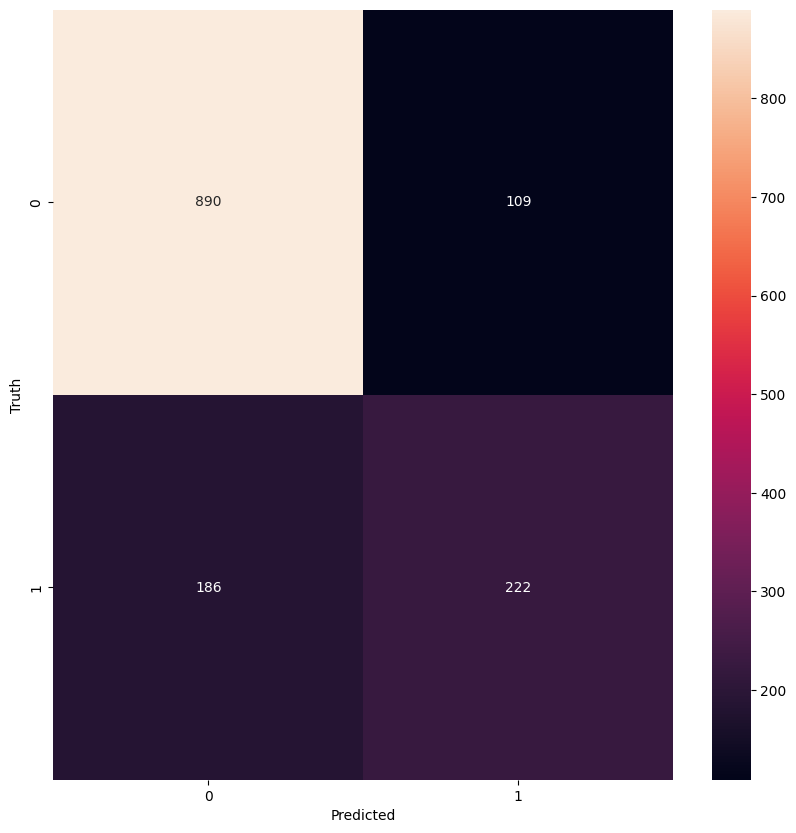

In [ ]:
import seaborn as sn

cm = tf.math.confusion_matrix(labels=y_test,predictions=y_pred)

plt.figure(figsize = (10,10))
sn.heatmap(cm, annot=True, fmt='d')
plt.xlabel('Predicted')
plt.ylabel('Truth')

In [ ]:
round((906+200)/(906+200+208+93),2) # which is the accuracy

0.79

In [ ]:
round(906/(906+208),2) # the precision for 0

0.81

In [ ]:
round(200/(200+93),2) # the precision for 1

0.68

In [ ]:
round(906/(906+93),2) # recall for 0

0.91

In [ ]:
round(200/(200+208),2) # recall for 1

0.49



---



In [ ]:
import pandas as pd
import plotly.express as px
from sklearn.model_selection import train_test_split
from sklearn.ensemble import IsolationForest
from sklearn.metrics import classification_report

data = pd.read_csv("/content/drive/MyDrive/MD/Learning is Learning/Data_cn/transaction_anomalies_dataset.csv")
data.head()

,Transaction_ID,Transaction_Amount,Transaction_Volume,Average_Transaction_Amount,Frequency_of_Transactions,Time_Since_Last_Transaction,Day_of_Week,Time_of_Day,Age,Gender,Income,Account_Type
0,TX0,1024.835708,3,997.234714,12,29,Friday,06:00,36,Male,1436074,Savings
1,TX1,1013.952065,4,1020.210306,7,22,Friday,01:00,41,Female,627069,Savings
2,TX2,970.956093,1,989.496604,5,12,Tuesday,21:00,61,Male,786232,Savings
3,TX3,1040.822254,2,969.522480,16,28,Sunday,14:00,61,Male,619030,Savings
4,TX4,998.777241,1,1007.111026,7,7,Friday,08:00,56,Female,649457,Savings


In [ ]:
data.isnull().sum()

,0
Transaction_ID,0
Transaction_Amount,0
Transaction_Volume,0
Average_Transaction_Amount,0
Frequency_of_Transactions,0
Time_Since_Last_Transaction,0
Day_of_Week,0
Time_of_Day,0
Age,0
Gender,0


In [ ]:
fig_amount = px.histogram(data, x='Transaction_Amount',
                          nbins=20,
                          title='Distribution of Transaction Amount')
fig_amount.show()

In [ ]:
fig_box_amount = px.box(data,
                        x='Account_Type',
                        y='Transaction_Amount',
                        title='Transaction Amount by Account Type')
fig_box_amount.show()

In [ ]:
fig_scatter_avg_amount_age = px.scatter(data, x='Age',
                                        y='Average_Transaction_Amount',
                                        color='Account_Type',
                                        title='Average Transaction Amount vs. Age',
                                        trendline='ols')
fig_scatter_avg_amount_age.show()

In [ ]:
fig_day_of_week = px.bar(data, x='Day_of_Week',
                         title='Count of Transactions by Day of the Week')
fig_day_of_week.show()

In [ ]:
correlation_matrix = data[['Transaction_Amount',
                          'Transaction_Volume',
                          'Average_Transaction_Amount',
                          'Frequency_of_Transactions',
                          'Time_Since_Last_Transaction',
                          'Age',
                          'Income']].corr()
fig_corr_heatmap = px.imshow(correlation_matrix,
                             title='Correlation Heatmap')
fig_corr_heatmap.show()

In [ ]:
mean_amount = data['Transaction_Amount'].mean()
std_amount = data['Transaction_Amount'].std()

anomaly_threshold = mean_amount + 2 * std_amount

data['Is_Anomaly'] = data['Transaction_Amount'] > anomaly_threshold

fig_anomalies = px.scatter(data, x='Transaction_Amount', y='Average_Transaction_Amount',
                           color='Is_Anomaly', title='Anomalies in Transaction Amount')
fig_anomalies.update_traces(marker=dict(size=12),
                            selector=dict(mode='markers', marker_size=1))
fig_anomalies.show()

In [ ]:
num_anomalies = data['Is_Anomaly'].sum()
num_anomalies

20

In [ ]:
total_instances = data.shape[0]
anomaly_ratio = num_anomalies / total_instances
anomaly_ratio

0.02

In [ ]:
relevant_features = ['Transaction_Amount',
                     'Average_Transaction_Amount',
                     'Frequency_of_Transactions']


X = data[relevant_features]
y = data['Is_Anomaly']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


model = IsolationForest(contamination=0.02, random_state=42)
model.fit(X_train)

IsolationForest(contamination=0.02, random_state=42)

In [ ]:
# Predict anomalies on the test set
y_pred = model.predict(X_test)

# Convert predictions to binary values (0: normal, 1: anomaly)
y_pred_binary = [1 if pred == -1 else 0 for pred in y_pred]

# Evaluate the model's performance
report = classification_report(y_test, y_pred_binary, target_names=['Normal', 'Anomaly'])
print(report)

              precision    recall  f1-score   support

      Normal       1.00      1.00      1.00       196
     Anomaly       1.00      1.00      1.00         4

    accuracy                           1.00       200
   macro avg       1.00      1.00      1.00       200
weighted avg       1.00      1.00      1.00       200



In [ ]:
# Relevant features used during training
relevant_features = ['Transaction_Amount', 'Average_Transaction_Amount', 'Frequency_of_Transactions']

# Get user inputs for features
user_inputs = []
for feature in relevant_features:
    user_input = float(input(f"Enter the value for '{feature}': "))
    user_inputs.append(user_input)

# Create a DataFrame from user inputs
user_df = pd.DataFrame([user_inputs], columns=relevant_features)

# Predict anomalies using the model
user_anomaly_pred = model.predict(user_df)

# Convert the prediction to binary value (0: normal, 1: anomaly)
user_anomaly_pred_binary = 1 if user_anomaly_pred == -1 else 0

if user_anomaly_pred_binary == 1:
    print("Anomaly detected: This transaction is flagged as an anomaly.")
else:
    print("No anomaly detected: This transaction is normal.")

Enter the value for 'Transaction_Amount': 3000
Enter the value for 'Average_Transaction_Amount': 2500
Enter the value for 'Frequency_of_Transactions': 19
Anomaly detected: This transaction is flagged as an anomaly.


### Imbalanced Data

In [ ]:
def ANN(X_train, y_train, X_test, y_test, loss, weights):
    model = keras.Sequential([
        keras.layers.Dense(26, input_dim=26, activation='relu'),
        keras.layers.Dense(15, activation='relu'),
        keras.layers.Dense(1, activation='sigmoid')
    ])

    model.compile(optimizer='adam', loss=loss, metrics=['accuracy'])

    if weights == -1:
        model.fit(X_train, y_train, epochs=100)
    else:
        model.fit(X_train, y_train, epochs=100, class_weight = weights)

    print(model.evaluate(X_test, y_test))

    y_preds = model.predict(X_test)
    y_preds = np.round(y_preds)

    print("Classification Report: \n", classification_report(y_test, y_preds))

    return y_preds

In [ ]:
y_preds = ANN(X_train, y_train, X_test, y_test, 'binary_crossentropy', -1)

Epoch 1/100


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


176/176 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - accuracy: 0.6374 - loss: 0.6088
Epoch 2/100
176/176 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.7965 - loss: 0.4294
Epoch 3/100
176/176 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.7991 - loss: 0.4240
Epoch 4/100
176/176 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8032 - loss: 0.4209
Epoch 5/100
176/176 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - accuracy: 0.8132 - loss: 0.4078
Epoch 6/100
176/176 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - accuracy: 0.8156 - loss: 0.4023
Epoch 7/100
176/176 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8217 - loss: 0.3869
Epoch 8/100
176/176 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8141 - loss: 0.4027
Epoch 9/100
176/176 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8111 - loss: 0.4021
Epoch 10/100
176/176 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8090 - loss: 0.4003
Epoch 11/100
176/176 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - accuracy: 0.8089 - loss: 0.4068
Epoch 12/100
176/176 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step

We can find that the F-1 score for class 1 is much lower than class 0

In [ ]:
y_test.value_counts() # which has an imbalanced in data

,count
Churn,
0.0,999
1.0,408




> Undersampling



In [ ]:
count_class_0, count_class_1 = df1.Churn.value_counts()

df_class_0 = df2[df2['Churn'] == 0]
df_class_1 = df2[df2['Churn'] == 1]

In [ ]:
count_class_0, count_class_1

(5163, 1869)

In [ ]:
df_class_0.shape, df_class_1.shape

((5163, 27), (1869, 27))

In [ ]:
df_class_0.sample(2)

,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,OnlineSecurity,OnlineBackup,DeviceProtection,...,InternetService_DSL,InternetService_Fiber optic,InternetService_No,Contract_Month-to-month,Contract_One year,Contract_Two year,PaymentMethod_Bank transfer (automatic),PaymentMethod_Credit card (automatic),PaymentMethod_Electronic check,PaymentMethod_Mailed check
3268,0.0,0.0,1.0,1.0,0.323944,1.0,1.0,1.0,0.0,0.0,...,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
2675,0.0,0.0,1.0,1.0,0.577465,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0


In [ ]:
# in order to make a balance data set
df_class_0_under = df_class_0.sample(count_class_1)

In [ ]:
df_under = pd.concat([df_class_0_under, df_class_1],axis=0)
df_under.shape

(3738, 27)

In [ ]:
df_under.Churn.value_counts()

,count
Churn,
0.0,1869
1.0,1869


In [ ]:
X_under = df_under.drop('Churn',axis='columns')
y_under = df_under.Churn

In [ ]:
X_train_under, X_test_under, y_train_under, y_test_under = train_test_split(X_under,y_under,test_size=0.2,random_state=15,stratify=y_under)

In [ ]:
X_train_under.shape, X_test_under.shape

((2990, 26), (748, 26))

In [ ]:
y_train_under.value_counts()

,count
Churn,
0.0,1495
1.0,1495


In [ ]:
y_pred_under = ANN(X_train_under, y_train_under, X_test_under, y_test_under, 'binary_crossentropy', -1)

/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/100
94/94 ━━━━━━━━━━━━━━━━━━━━ 9s 32ms/step - accuracy: 0.6177 - loss: 0.6582
Epoch 2/100
94/94 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7499 - loss: 0.5241
Epoch 3/100
94/94 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.7529 - loss: 0.4992
Epoch 4/100
94/94 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - accuracy: 0.7585 - loss: 0.4919
Epoch 5/100
94/94 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7831 - loss: 0.4654
Epoch 6/100
94/94 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7653 - loss: 0.4838
Epoch 7/100
94/94 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7598 - loss: 0.4857
Epoch 8/100
94/94 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - accuracy: 0.7728 - loss: 0.4724
Epoch 9/100
94/94 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7920 - loss: 0.4467
Epoch 10/100
94/94 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7524 - loss: 0.5081
Epoch 11/100
94/94 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7713 - loss: 0.4690
Epoch 12/100
94/94 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy

It finds that the result is balanced




> Oversampling




In [ ]:
count_class_0, count_class_1

(5163, 1869)

In [ ]:
df_class_1.shape

(1869, 27)

In [ ]:
df_class_1_over = df_class_1.sample(count_class_0, replace=True) # copy some more into df
df_class_1_over.shape

(5163, 27)

In [ ]:
df_class_1_over.sample(5)

,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,OnlineSecurity,OnlineBackup,DeviceProtection,...,InternetService_DSL,InternetService_Fiber optic,InternetService_No,Contract_Month-to-month,Contract_One year,Contract_Two year,PaymentMethod_Bank transfer (automatic),PaymentMethod_Credit card (automatic),PaymentMethod_Electronic check,PaymentMethod_Mailed check
3737,1.0,0.0,0.0,0.0,0.056338,1.0,1.0,0.0,0.0,0.0,...,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
6453,0.0,1.0,1.0,0.0,0.647887,1.0,1.0,0.0,0.0,1.0,...,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0
5724,0.0,0.0,0.0,0.0,0.000000,1.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
248,0.0,0.0,0.0,0.0,0.000000,1.0,0.0,1.0,0.0,0.0,...,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
117,1.0,0.0,1.0,1.0,0.126761,1.0,1.0,1.0,0.0,0.0,...,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0


In [ ]:
df_over = pd.concat([df_class_0, df_class_1_over], axis=0)
df_over.shape

(10326, 27)

In [ ]:
df_over.Churn.value_counts()

,count
Churn,
0.0,5163
1.0,5163


In [ ]:
X_over = df_over.drop('Churn',axis='columns')
y_over = df_over.Churn

In [ ]:
X_train_over, X_test_over, y_train_over, y_test_over = train_test_split(X_over,y_over,test_size=0.2,random_state=15,stratify=y_over)

In [ ]:
y_pred_over = ANN(X_train_over, y_train_over, X_test_over, y_test_over, 'binary_crossentropy', -1)

/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/100
259/259 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - accuracy: 0.6059 - loss: 0.6347
Epoch 2/100
259/259 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7604 - loss: 0.4925
Epoch 3/100
259/259 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.7529 - loss: 0.4941
Epoch 4/100
259/259 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.7641 - loss: 0.4829
Epoch 5/100
259/259 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - accuracy: 0.7731 - loss: 0.4677
Epoch 6/100
259/259 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7823 - loss: 0.4592
Epoch 7/100
259/259 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7824 - loss: 0.4680
Epoch 8/100
259/259 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.7817 - loss: 0.4639
Epoch 9/100
259/259 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.7817 - loss: 0.4622
Epoch 10/100
259/259 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - accuracy: 0.7760 - loss: 0.4655
Epoch 11/100
259/259 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7895 - loss: 0.4485
Epoch 12/100
259/259 ━━━━━━━━━━━━━━━━━━━━



> SMOTE



 increasing the number of cases in your dataset in a balanced way

In [ ]:
X_smote = df2.drop('Churn',axis='columns')
y_smote = df2.Churn

In [ ]:
!pip install imblearn

In [ ]:
from imblearn.over_sampling import SMOTE

smote = SMOTE(sampling_strategy='minority')
X_smote_resampled, y_smote_resampled = smote.fit_resample(X_smote, y_smote)

In [ ]:
y_smote_resampled.value_counts()

,count
Churn,
0.0,5163
1.0,5163


In [ ]:
X_train_smote, X_test_smote, y_train_smote, y_test_smote = train_test_split(X_smote_resampled, y_smote_resampled, test_size=0.2,random_state=15,stratify=y_smote_resampled)

In [ ]:
y_pred_smote = ANN(X_train_smote, y_train_smote, X_test_smote, y_test_smote, 'binary_crossentropy', -1)

/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/100
259/259 ━━━━━━━━━━━━━━━━━━━━ 7s 10ms/step - accuracy: 0.6404 - loss: 0.6238
Epoch 2/100
259/259 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - accuracy: 0.7719 - loss: 0.4799
Epoch 3/100
259/259 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.7774 - loss: 0.4710
Epoch 4/100
259/259 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7764 - loss: 0.4703
Epoch 5/100
259/259 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7774 - loss: 0.4631
Epoch 6/100
259/259 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7721 - loss: 0.4629
Epoch 7/100
259/259 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.7862 - loss: 0.4512
Epoch 8/100
259/259 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.7882 - loss: 0.4478
Epoch 9/100
259/259 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.7841 - loss: 0.4507
Epoch 10/100
259/259 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.7855 - loss: 0.4491
Epoch 11/100
259/259 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - accuracy: 0.7969 - loss: 0.4421
Epoch 12/100
259/259 ━━━━━━━━━━━━━━━━━━━

Now, we are having balanced and desirable results



> Ensemble with undersampling



In [ ]:
df2.Churn.value_counts()

,count
Churn,
0.0,5163
1.0,1869


In [ ]:
X_ensemble = df2.drop('Churn',axis='columns')
y_ensemble = df2.Churn

In [ ]:
X_train_ensemble, X_test_ensemble, y_train_ensemble, y_test_ensemble = train_test_split(X_ensemble,y_ensemble,test_size=0.2,random_state=15,stratify=y_ensemble)

In [ ]:
y_train_ensemble.value_counts()

,count
Churn,
0.0,4130
1.0,1495


In [ ]:
df3 = X_train_ensemble.copy()
df3['Churn'] = y_train_ensemble

In [ ]:
df3_class_0 = df3[df3['Churn'] == 0]
df3_class_1 = df3[df3['Churn'] == 1]

In [ ]:
df3_class_0.shape, df3_class_1.shape

((4130, 27), (1495, 27))

In [ ]:
def get_train_batch(df_majority,df_minority,start,end):
  df_train = pd.concat([df_majority[start:end],df_minority],axis=0)

  X_train = df_train.drop('Churn',axis='columns')
  y_train = df_train.Churn
  return X_train,y_train

In [ ]:
X_train, y_train = get_train_batch(df3_class_0,df3_class_1,0,1495)
X_train.shape

(2990, 26)

In [ ]:
y_p = ANN(X_train, y_train, X_test_ensemble, y_test_ensemble, 'binary_crossentropy', -1)

/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/100
94/94 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.5605 - loss: 0.6763
Epoch 2/100
94/94 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.7448 - loss: 0.5279
Epoch 3/100
94/94 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7764 - loss: 0.4932
Epoch 4/100
94/94 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.7575 - loss: 0.4956
Epoch 5/100
94/94 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.7605 - loss: 0.4897
Epoch 6/100
94/94 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7552 - loss: 0.5026
Epoch 7/100
94/94 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7657 - loss: 0.4819
Epoch 8/100
94/94 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.7796 - loss: 0.4752
Epoch 9/100
94/94 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7728 - loss: 0.4766
Epoch 10/100
94/94 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.7835 - loss: 0.4759
Epoch 11/100
94/94 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.7848 - loss: 0.4682
Epoch 12/100
94/94 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy

In [ ]:
X_train, y_train = get_train_batch(df3_class_0,df3_class_1,1495,2990)
y_p2 = ANN(X_train, y_train, X_test_ensemble, y_test_ensemble, 'binary_crossentropy', -1)

/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/100
94/94 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step - accuracy: 0.5598 - loss: 0.6536
Epoch 2/100
94/94 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - accuracy: 0.7667 - loss: 0.5281
Epoch 3/100
94/94 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7502 - loss: 0.5051
Epoch 4/100
94/94 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7527 - loss: 0.5046
Epoch 5/100
94/94 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7492 - loss: 0.4978
Epoch 6/100
94/94 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7592 - loss: 0.4925
Epoch 7/100
94/94 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7631 - loss: 0.4847
Epoch 8/100
94/94 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7626 - loss: 0.4812
Epoch 9/100
94/94 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7744 - loss: 0.4768
Epoch 10/100
94/94 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7706 - loss: 0.4847
Epoch 11/100
94/94 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7634 - loss: 0.4759
Epoch 12/100
94/94 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy

In [ ]:
X_train, y_train = get_train_batch(df3_class_0,df3_class_1,2990,4130)
y_p3 = ANN(X_train, y_train, X_test_ensemble, y_test_ensemble, 'binary_crossentropy', -1)

Epoch 1/100


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


83/83 ━━━━━━━━━━━━━━━━━━━━ 6s 29ms/step - accuracy: 0.6454 - loss: 0.6472
Epoch 2/100
83/83 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7683 - loss: 0.5188
Epoch 3/100
83/83 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7643 - loss: 0.4894
Epoch 4/100
83/83 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.7686 - loss: 0.4871
Epoch 5/100
83/83 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7656 - loss: 0.4751
Epoch 6/100
83/83 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.7726 - loss: 0.4772
Epoch 7/100
83/83 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7779 - loss: 0.4735
Epoch 8/100
83/83 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.7757 - loss: 0.4666
Epoch 9/100
83/83 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7728 - loss: 0.4672
Epoch 10/100
83/83 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.7877 - loss: 0.4584
Epoch 11/100
83/83 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - accuracy: 0.7833 - loss: 0.4546
Epoch 12/100
83/83 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7806 - l

In [ ]:
# Do majority Voting
len(y_p), len(y_p2), len(y_p3)

(1407, 1407, 1407)

In [ ]:
y_p_final = y_p.copy()

for i in range(len(y_p)):
  n_ones= y_p[i] + y_p2[i] + y_p3[i]
  if n_ones > 1:
    y_p_final[i] = 1
  else:
    y_p_final[i] = 0


In [ ]:
print(classification_report(y_test_ensemble,y_p_final))

              precision    recall  f1-score   support

         0.0       0.89      0.68      0.78      1033
         1.0       0.47      0.78      0.59       374

    accuracy                           0.71      1407
   macro avg       0.68      0.73      0.68      1407
weighted avg       0.78      0.71      0.73      1407



### CNN

In [ ]:
import tensorflow as tf
from tensorflow.keras import datasets, layers, models
import matplotlib.pyplot as plt
import numpy as np

In [ ]:
(X_train,y_train),(X_test,y_test) = datasets.cifar10.load_data()

170498071/170498071 ━━━━━━━━━━━━━━━━━━━━ 3s 0us/step


In [ ]:
X_test.shape

(10000, 32, 32, 3)

In [ ]:
classes = ['airplane','automobile','bird','cat','deer','dog','frog','horse','ship','truck']

In [ ]:
def plot_sample(X,y,index):
  plt.figure(figsize=(15,2))
  plt.imshow(X[index])
  plt.xlabel(classes[y[index]])

In [ ]:
y_train[:5].shape

(5,)

In [ ]:
y_train = y_train.reshape(-1,)
y_train[:5].shape

(5,)

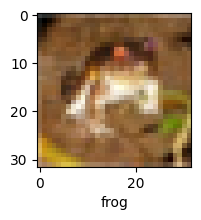

In [ ]:
plot_sample(X_train,y_train,0)

In [ ]:
X_train = X_train / 255.0
X_test = X_test / 255.0

In [ ]:
model = models.Sequential([
    layers.Flatten(input_shape=(32,32,3)),
    layers.Dense(3000,activation='relu'),
    layers.Dense(1000,activation='relu'),
    layers.Dense(10,activation='sigmoid')
])

model.compile(optimizer='SGD',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

model.fit(X_train,y_train,epochs=5)

/usr/local/lib/python3.10/dist-packages/keras/src/layers/reshaping/flatten.py:37: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 1/5
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 7s 3ms/step - accuracy: 0.3076 - loss: 1.9307
Epoch 2/5
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - accuracy: 0.4235 - loss: 1.6415
Epoch 3/5
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - accuracy: 0.4531 - loss: 1.5480
Epoch 4/5
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - accuracy: 0.4815 - loss: 1.4819
Epoch 5/5
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - accuracy: 0.4943 - loss: 1.4381


In [ ]:
model.evaluate(X_test,y_test)

313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.4867 - loss: 1.4617


[1.4655585289001465, 0.482699990272522]

In [ ]:
from sklearn.metrics import confusion_matrix, classification_report
import numpy as np
y_pred = model.predict(X_test)
y_pred_classes = [np.argmax(element) for element in y_pred]

print("Classification Report: \n", classification_report(y_test, y_pred_classes))

313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
Classification Report: 
               precision    recall  f1-score   support

           0       0.41      0.71      0.52      1000
           1       0.56      0.67      0.61      1000
           2       0.44      0.27      0.34      1000
           3       0.39      0.29      0.33      1000
           4       0.40      0.44      0.42      1000
           5       0.48      0.26      0.34      1000
           6       0.60      0.42      0.50      1000
           7       0.45      0.66      0.53      1000
           8       0.58      0.63      0.60      1000
           9       0.57      0.48      0.52      1000

    accuracy                           0.48     10000
   macro avg       0.49      0.48      0.47     10000
weighted avg       0.49      0.48      0.47     10000



In [ ]:
model_cnn = models.Sequential([
    # cnn
    layers.Conv2D(filters=32, kernel_size=(3, 3), activation='relu', input_shape=(32, 32, 3)),
    layers.MaxPooling2D((2, 2)),

    layers.Conv2D(filters=64, kernel_size=(3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),

    layers.Flatten(),
    layers.Dense(64, activation='relu'),
    layers.Dense(10, activation='softmax')
])

model_cnn.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

model_cnn.fit(X_train, y_train, epochs=10)

/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/10
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - accuracy: 0.3863 - loss: 1.6912
Epoch 2/10
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - accuracy: 0.6051 - loss: 1.1276
Epoch 3/10
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - accuracy: 0.6565 - loss: 0.9817
Epoch 4/10
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - accuracy: 0.6935 - loss: 0.8781
Epoch 5/10
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - accuracy: 0.7157 - loss: 0.8156
Epoch 6/10
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - accuracy: 0.7466 - loss: 0.7301
Epoch 7/10
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - accuracy: 0.7643 - loss: 0.6779
Epoch 8/10
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - accuracy: 0.7737 - loss: 0.6429
Epoch 9/10
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - accuracy: 0.7926 - loss: 0.5976
Epoch 10/10
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - accuracy: 0.8050 - loss: 0.5597


In [ ]:
model_cnn.evaluate(X_test,y_test)

313/313 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - accuracy: 0.7160 - loss: 0.8892


[0.9060652256011963, 0.7074999809265137]

In [ ]:
y_test = y_test.reshape(-1,)

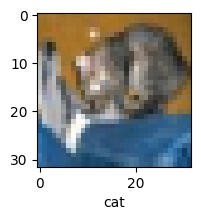

In [ ]:
plot_sample(X_test,y_test,0)

In [ ]:
y_pred = model.predict(X_test)
y_pred[:5]

313/313 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


array([[0.42484987, 0.7154192 , 0.49912047, 0.8142232 , 0.39042   ,
        0.6594703 , 0.6832322 , 0.07237574, 0.6629026 , 0.09494182],
       [0.9359206 , 0.97616076, 0.30145055, 0.23171642, 0.1924148 ,
        0.05329205, 0.01270362, 0.21346875, 0.9736649 , 0.97853446],
       [0.9765603 , 0.9242211 , 0.41320717, 0.20087044, 0.24968982,
        0.11873017, 0.00442955, 0.4562841 , 0.9759174 , 0.9002645 ],
       [0.94835377, 0.6774341 , 0.64066017, 0.2222593 , 0.5554509 ,
        0.16833648, 0.0074144 , 0.7945817 , 0.8536515 , 0.42470145],
       [0.25950706, 0.07035255, 0.70343196, 0.53024626, 0.96556985,
        0.5754966 , 0.717909  , 0.48061556, 0.31597883, 0.03822064]],
      dtype=float32)

In [ ]:
classes[np.argmax(y_pred[0])]

'cat'

In [ ]:
y_pred_class = [np.argmax(element) for element in y_pred]
y_pred_class[:5]

[3, 9, 0, 0, 4]

In [ ]:
y_test[:5]

array([3, 8, 8, 0, 6], dtype=uint8)



> Data Augmentation



In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import cv2
import os
import PIL
import tensorflow as tf

from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential

In [ ]:
dataset_url = "https://storage.googleapis.com/download.tensorflow.org/example_images/flower_photos.tgz"
data_dir = tf.keras.utils.get_file('flower_photos', origin=dataset_url,  cache_dir='.', untar=True)

228813984/228813984 ━━━━━━━━━━━━━━━━━━━━ 1s 0us/step


In [ ]:
data_dir

'./datasets/flower_photos'

In [ ]:
import pathlib
data_dir = pathlib.Path(data_dir)
data_dir

PosixPath('datasets/flower_photos')

In [ ]:
list(data_dir.glob('*/*.jpg'))[:5]

[PosixPath('datasets/flower_photos/roses/4061451210_1650590c6a.jpg'),
 PosixPath('datasets/flower_photos/roses/8642943283_47e44d049d_m.jpg'),
 PosixPath('datasets/flower_photos/roses/16149016979_23ef42b642_m.jpg'),
 PosixPath('datasets/flower_photos/roses/19988406792_68201f76e3_n.jpg'),
 PosixPath('datasets/flower_photos/roses/410425647_4586667858.jpg')]

In [ ]:
image_count = len(list(data_dir.glob('*/*.jpg')))
print(image_count)

3670


In [ ]:
roses = list(data_dir.glob('roses/*'))

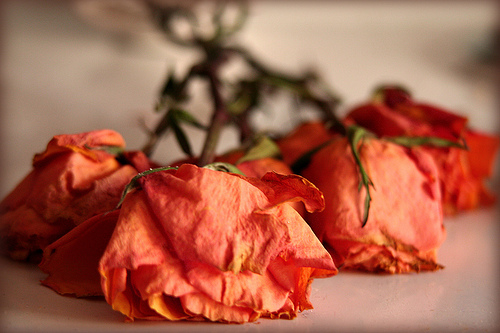

In [ ]:
PIL.Image.open(str(roses[0]))

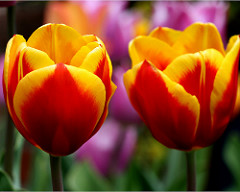

In [ ]:
tulips = list(data_dir.glob('tulips/*'))
PIL.Image.open(str(tulips[0]))

In [ ]:
flowers_images_dict = {
    'roses': list(data_dir.glob('roses/*')),
    'daisy': list(data_dir.glob('daisy/*')),
    'dandelion': list(data_dir.glob('dandelion/*')),
    'sunflowers': list(data_dir.glob('sunflowers/*')),
    'tulips': list(data_dir.glob('tulips/*')),
}

In [ ]:
flowers_images_dict['roses'][:5]

[PosixPath('datasets/flower_photos/roses/4061451210_1650590c6a.jpg'),
 PosixPath('datasets/flower_photos/roses/8642943283_47e44d049d_m.jpg'),
 PosixPath('datasets/flower_photos/roses/16149016979_23ef42b642_m.jpg'),
 PosixPath('datasets/flower_photos/roses/19988406792_68201f76e3_n.jpg'),
 PosixPath('datasets/flower_photos/roses/410425647_4586667858.jpg')]

In [ ]:
flowers_labels_dict = {
    'roses': 0,
    'daisy': 1,
    'dandelion': 2,
    'sunflowers': 3,
    'tulips': 4,
}

array([[[ 49,  58,  95],
        [ 49,  59,  93],
        [ 50,  61,  93],
        ...,
        [ 67,  80, 112],
        [ 63,  75, 109],
        [ 61,  73, 107]],

       [[ 49,  59,  93],
        [ 50,  61,  93],
        [ 50,  64,  93],
        ...,
        [ 70,  83, 115],
        [ 66,  79, 111],
        [ 64,  76, 110]],

       [[ 48,  61,  93],
        [ 50,  64,  93],
        [ 52,  66,  94],
        ...,
        [ 72,  88, 117],
        [ 67,  82, 114],
        [ 65,  80, 112]],

       ...,

       [[ 55,  66,  98],
        [ 58,  69, 101],
        [ 61,  70, 103],
        ...,
        [ 64,  75, 107],
        [ 61,  72, 104],
        [ 59,  69, 103]],

       [[ 53,  64,  96],
        [ 55,  66,  98],
        [ 58,  67, 100],
        ...,
        [ 62,  73, 105],
        [ 59,  70, 102],
        [ 57,  67, 101]],

       [[ 51,  62,  94],
        [ 53,  64,  96],
        [ 55,  64,  97],
        ...,
        [ 59,  70, 102],
        [ 56,  66, 100],
        [ 54,  64,  98]]], dtype=uint8)
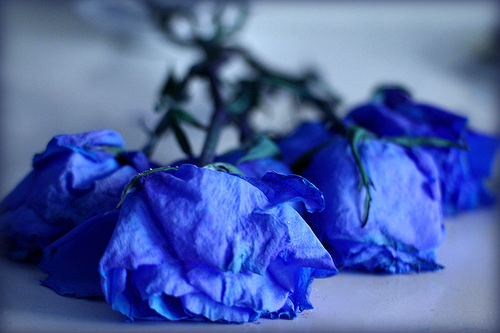

In [ ]:
cv2.imread(str(flowers_images_dict['roses'][0]))

In [ ]:
cv2.resize(cv2.imread(str(flowers_images_dict['roses'][0])),(180,180)).shape

(180, 180, 3)

In [ ]:
X , y = [],[]

for flower_name, images in flowers_images_dict.items():
  for image in images:
    img = cv2.imread(str(image))
    resized_img = cv2.resize(img,(180,180))
    X.append(resized_img)
    y.append(flowers_labels_dict[flower_name])

In [ ]:
y[:5]

[0, 0, 0, 0, 0]

In [ ]:
X = np.array(X)
y = np.array(y)

In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=0)

In [ ]:
X_train_scaled = X_train / 255
X_test_scaled = X_test / 255

In [ ]:
model = Sequential([
    layers.Conv2D(16,3,padding='same',activation='relu',),
    layers.MaxPooling2D(),
    layers.Conv2D(32,3,padding='same',activation='relu',),
    layers.MaxPooling2D(),
    layers.Conv2D(64,3,padding='same',activation='relu',),
    layers.MaxPooling2D(),
    layers.Flatten(),
    layers.Dense(128,activation='relu'),
    layers.Dense(5,activation='softmax')
])

model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

model.fit(X_train_scaled, y_train, epochs=30)

Epoch 1/30
86/86 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step - accuracy: 0.2934 - loss: 1.6422
Epoch 2/30
86/86 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - accuracy: 0.5815 - loss: 1.0644
Epoch 3/30
86/86 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step - accuracy: 0.6899 - loss: 0.8325
Epoch 4/30
86/86 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step - accuracy: 0.7351 - loss: 0.6920
Epoch 5/30
86/86 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - accuracy: 0.8396 - loss: 0.4445
Epoch 6/30
86/86 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - accuracy: 0.9116 - loss: 0.2688
Epoch 7/30
86/86 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step - accuracy: 0.9622 - loss: 0.1403
Epoch 8/30
86/86 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step - accuracy: 0.9799 - loss: 0.0828
Epoch 9/30
86/86 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step - accuracy: 0.9888 - loss: 0.0447
Epoch 10/30
86/86 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step - accuracy: 0.9965 - loss: 0.0217
Epoch 11/30
86/86 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step - accuracy: 0.9989 - loss: 0.0070
Epoch 12/30
86/86 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step - accuracy:

In [ ]:
model.evaluate(X_test,y_test) # overfitting

29/29 ━━━━━━━━━━━━━━━━━━━━ 2s 35ms/step - accuracy: 0.5434 - loss: 716.3997


[711.2442626953125, 0.5413943529129028]

In [ ]:
pred = model.predict(X_test_scaled)
pred

29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step


array([[2.9181823e-05, 9.9873108e-01, 1.2397716e-03, 1.0445892e-11,
        1.3046096e-08],
       [1.9340765e-03, 1.0393096e-06, 7.7570239e-06, 9.9723130e-01,
        8.2586886e-04],
       [4.4652341e-11, 9.6447175e-06, 9.9998927e-01, 5.8412962e-07,
        4.8087884e-07],
       ...,
       [6.3399557e-04, 1.1056519e-07, 2.0881145e-10, 9.9898916e-01,
        3.7668063e-04],
       [9.7046262e-01, 2.4179228e-06, 1.5330956e-08, 7.5835025e-08,
        2.9534897e-02],
       [3.0642601e-05, 7.0219525e-05, 4.1964361e-03, 8.4524930e-01,
        1.5045343e-01]], dtype=float32)

In [ ]:
score = tf.nn.softmax(pred[0])
score

<tf.Tensor: shape=(5,), dtype=float32, numpy=
array([0.14890018, 0.40422755, 0.14908056, 0.14889583, 0.14889583],
      dtype=float32)>

In [ ]:
np.argmax(score)

1

In [ ]:
y_test[0]

1

In [ ]:
data_aug = keras.Sequential([
    layers.RandomZoom(0.3),
])

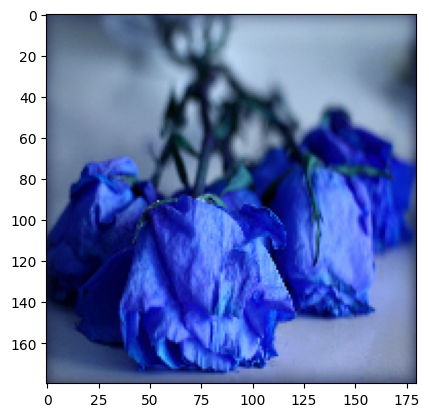

In [ ]:
plt.imshow(X[0])

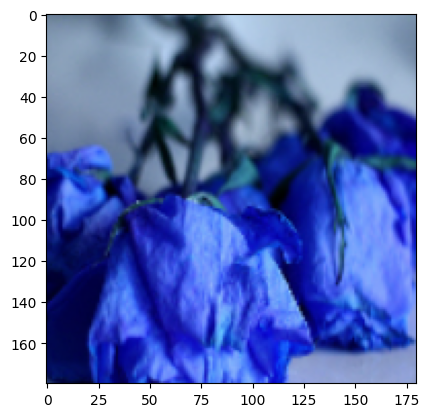

In [ ]:
plt.imshow(data_aug(X)[0].numpy().astype('uint8'))

In [ ]:
model_aug = Sequential([
    data_aug,
    layers.Conv2D(16,3,padding='same',activation='relu',),
    layers.MaxPooling2D(),
    layers.Conv2D(32,3,padding='same',activation='relu',),
    layers.MaxPooling2D(),
    layers.Conv2D(64,3,padding='same',activation='relu',),
    layers.MaxPooling2D(),
    layers.Dropout(0.2),
    layers.Flatten(),
    layers.Dense(128,activation='relu'),
    layers.Dense(5,activation='softmax')
])

model_aug.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

model_aug.fit(X_train_scaled, y_train, epochs=20)

Epoch 1/20
86/86 ━━━━━━━━━━━━━━━━━━━━ 6s 27ms/step - accuracy: 0.3050 - loss: 1.5786
Epoch 2/20
86/86 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step - accuracy: 0.5732 - loss: 1.0575
Epoch 3/20
86/86 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step - accuracy: 0.6354 - loss: 0.9159
Epoch 4/20
86/86 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step - accuracy: 0.6795 - loss: 0.8417
Epoch 5/20
86/86 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step - accuracy: 0.7215 - loss: 0.7500
Epoch 6/20
86/86 ━━━━━━━━━━━━━━━━━━━━ 2s 28ms/step - accuracy: 0.7439 - loss: 0.6786
Epoch 7/20
86/86 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step - accuracy: 0.7861 - loss: 0.5885
Epoch 8/20
86/86 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step - accuracy: 0.8147 - loss: 0.5355
Epoch 9/20
86/86 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step - accuracy: 0.8348 - loss: 0.4602
Epoch 10/20
86/86 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step - accuracy: 0.8456 - loss: 0.4235
Epoch 11/20
86/86 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step - accuracy: 0.8752 - loss: 0.3510
Epoch 12/20
86/86 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step - accuracy:

In [ ]:
model_aug.evaluate(X_test_scaled,y_test)

29/29 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - accuracy: 0.6676 - loss: 1.4763


[1.4294203519821167, 0.6851851940155029]

Much better !!

## **Optimization**





### **Gradient Descending**



In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow import keras
import pandas as pd
import matplotlib.pyplot as plt

%matplotlib inline

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/MD/Learning is Learning/insurance_data.csv')
df.head()

,age,affordibility,bought_insurance
0,22,1,0
1,25,0,0
2,47,1,1
3,52,0,0
4,46,1,1


In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(df[['age','affordibility']],df.bought_insurance,test_size=0.2,random_state=25)

In [ ]:
X_train_scaled = X_train.copy()
X_train_scaled['age'] = X_train_scaled['age'] / 100
X_test_scaled = X_test.copy()
X_test_scaled['age'] = X_test_scaled['age'] / 100

In [ ]:
model = keras.Sequential([
    keras.layers.Dense(1, input_shape=(2,), activation='sigmoid', kernel_initializer='ones', bias_initializer='zeros') # w= 1 , b=0 for initialization
])

model.compile(optimizer='adam',
              loss='binary_crossentropy',
              metrics=['accuracy'])

model.fit(X_train_scaled, y_train, epochs=5000)

Epoch 1/5000


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Streaming output truncated to the last 5000 lines.
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - accuracy: 0.5000 - loss: 0.6748
Epoch 115/5000
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step - accuracy: 0.5000 - loss: 0.6745
Epoch 116/5000
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step - accuracy: 0.5000 - loss: 0.6742
Epoch 117/5000
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.5000 - loss: 0.6740
Epoch 118/5000
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.5000 - loss: 0.6737
Epoch 119/5000
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - accuracy: 0.5000 - loss: 0.6735
Epoch 120/5000
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step - accuracy: 0.5000 - loss: 0.6732
Epoch 121/5000
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - accuracy: 0.5000 - loss: 0.6730
Epoch 122/5000
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.5000 - loss: 0.6727
Epoch 123/5000
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - accuracy: 0.5000 - loss: 0.6724
Epoch 124/5000
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.5000 - loss: 0.6722
Epoch 1

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.



Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py", line 3553, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-55-1d14490008aa>", line 9, in <cell line: 9>
    model.fit(X_train_scaled, y_train, epochs=5000)
  File "/usr/local/lib/python3.10/dist-packages/keras/src/utils/traceback_utils.py", line 117, in error_handler
    return fn(*args, **kwargs)
  File "/usr/local/lib/python3.10/dist-packages/keras/src/backend/tensorflow/trainer.py", line 316, in fit
    for step, iterator in epoch_iterator.enumerate_epoch():
  File "/usr/local/lib/python3.10/dist-packages/keras/src/backend/tensorflow/trainer.py", line 649, in enumerate_epoch
    iterator = iter(self._distributed_dataset)
  File "/usr/local/lib/python3.10/dist-packages/tensorflow/python/data/ops/dataset_ops.py", line 501, in __iter__
    return iterator_ops.OwnedIterator(self)
  File "/usr/local/lib/python3.10/dist-packages/ten

TypeError: object of type 'NoneType' has no len()

In [ ]:
model.evaluate(X_test_scaled,y_test)

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 736ms/step - accuracy: 0.8333 - loss: 0.4747


[0.47473907470703125, 0.8333333134651184]

In [ ]:
model.predict(X_test_scaled)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 453ms/step


array([[0.67106545],
       [0.4809206 ],
       [0.27954316],
       [0.5488039 ],
       [0.68296826],
       [0.7491491 ]], dtype=float32)

In [ ]:
y_test

,bought_insurance
2,1
10,0
21,0
11,0
14,1
9,1


In [ ]:
coef, intercept = model.get_weights()
coef, intercept

(array([[2.7219388],
        [1.0881293]], dtype=float32),
 array([-1.6544329], dtype=float32))

In [ ]:
def sigmoid(X):
  import math
  return 1 / (1 + math.exp(-X))

In [ ]:
def prediction_function(age, affordibility):
  weighted_sum = coef[0]*age + coef[1]*affordibility + intercept
  return sigmoid(weighted_sum)

In [ ]:
prediction_function(0.47,1)

<ipython-input-59-5de9060e72c3>:3: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  return 1 / (1 + math.exp(-X))


0.6710654344022844

In [ ]:
X_test_scaled

,age,affordibility
2,0.47,1
10,0.18,1
21,0.26,0
11,0.28,1
14,0.49,1
9,0.61,1


In [ ]:
def log_loss(y_true,y_predicted):
  epsilon = 1e-15
  y_predicted_new = [max(i,epsilon) for i in y_predicted]
  y_predicted_new = [min(i,1-epsilon) for i in y_predicted_new]
  y_predicted_new = np.array(y_predicted_new)
  return -np.mean(y_true*np.log(y_predicted_new)+(1-y_true)*np.log(1-y_predicted_new))

In [ ]:
def sigmoid_numpy(X):
  import math
  return 1 / (1 + np.exp(-X))

In [ ]:
def gradient_descent(age, affordibility, y_true, epochs, loss_thresold):
  w1 = w2 = 1
  bias = 0
  rate = 0.5
  n = len(age)
  for i in range(epochs):
    weighted_sum = w1 * age + w2 * affordibility + bias
    y_predicted = sigmoid_numpy(weighted_sum)

    loss = log_loss(y_true, y_predicted)

    #updated weight and bias
    #derivative comes firts
    w1d = (1/n)*np.dot(np.transpose(age),(y_predicted-y_true)) # dot prodcuct is the SUM
    w2d = (1/n)*np.dot(np.transpose(affordibility),(y_predicted-y_true))
    bias_d = np.mean(y_predicted-y_true)
    #update
    w1 = w1 - rate * w1d
    w2 = w2 - rate * w2d
    bias = bias - rate * bias_d
    print (f'Epoch:{i}, w1:{w1}, w2:{w2}, bias:{bias}, loss:{loss}')
    if loss<=loss_thresold:
      break
  return w1, w2, bias


In [ ]:
gradient_descent(X_train_scaled['age'],X_train_scaled['affordibility'],y_train,1000, 0.4631)

Epoch:0, w1:0.974907633470177, w2:0.948348125394529, bias:-0.11341867736368583, loss:0.7113403233723417
Epoch:1, w1:0.9556229728273669, w2:0.9058873696677865, bias:-0.2122349122718517, loss:0.681264778737757
Epoch:2, w1:0.9416488476693794, w2:0.8719790823960313, bias:-0.2977578997796538, loss:0.6591474252715025
Epoch:3, w1:0.9323916996249162, w2:0.8457541517722915, bias:-0.3715094724003511, loss:0.6431523291301917
Epoch:4, w1:0.9272267472726993, w2:0.8262362885332687, bias:-0.43506643026891584, loss:0.6316873063379158
Epoch:5, w1:0.9255469396815343, w2:0.8124402814952774, bias:-0.48994490058938817, loss:0.623471707997592
Epoch:6, w1:0.9267936114129968, w2:0.8034375029757677, bias:-0.5375299543522853, loss:0.6175321183044205
Epoch:7, w1:0.93047170420295, w2:0.7983920007454487, bias:-0.5790424270894963, loss:0.6131591858705934
Epoch:8, w1:0.9361540784567942, w2:0.7965748796787705, bias:-0.6155315088627655, loss:0.6098518179750948
Epoch:9, w1:0.9434791243557357, w2:0.7973647616854131, bia

(5.051047623653049, 1.4569794548473887, -2.9596534546250037)

In [ ]:
coef, intercept
# Actually it should correspondent the the value above but this training is not good, so we cant see the result
# but it should be

(array([[2.7219388],
        [1.0881293]], dtype=float32),
 array([-1.6544329], dtype=float32))



---


> **Implement the Own NN**





In [ ]:
class myNN:
  def __init__(self):
    self.w1 = 1
    self.w2 = 1
    self.bias = 0


  def fit(self, X, y, epochs, loss_thresold):
    self.w1, self.w2, self.bias = self.gradient_descent(X['age'],X['affordibility'],y, epochs, loss_thresold)

  def predict(self, X_test):
    weighted_sum = self.w1*X_test['age'] + self.w2*X_test['affordibility'] + self.bias
    return sigmoid_numpy(weighted_sum)


  def gradient_descent(self,age, affordibility, y_true, epochs, loss_thresold):
    w1 = w2 = 1
    bias = 0
    rate = 0.5
    n = len(age)
    for i in range(epochs):
      weighted_sum = w1 * age + w2 * affordibility + bias
      y_predicted = sigmoid_numpy(weighted_sum)

      loss = log_loss(y_true, y_predicted)

      #updated weight and bias
      #derivative comes firts
      w1d = (1/n)*np.dot(np.transpose(age),(y_predicted-y_true)) # dot prodcuct is the SUM
      w2d = (1/n)*np.dot(np.transpose(affordibility),(y_predicted-y_true))
      bias_d = np.mean(y_predicted-y_true)
      #update
      w1 = w1 - rate * w1d
      w2 = w2 - rate * w2d
      bias = bias - rate * bias_d
      if i%100==0:
        print (f'Epoch:{i}, w1:{w1}, w2:{w2}, bias:{bias}, loss:{loss}')
      if loss<=loss_thresold:
        break
    return w1, w2, bias

In [ ]:
customModel = myNN()
customModel.fit(X_train_scaled, y_train, epochs=8000, loss_thresold=0.4631)

Epoch:0, w1:0.974907633470177, w2:0.948348125394529, bias:-0.11341867736368583, loss:0.7113403233723417
Epoch:100, w1:2.200713131760032, w2:1.2941584023238903, bias:-1.6607009122062801, loss:0.5390680417774752
Epoch:200, w1:3.443016970881803, w2:1.4042218624465033, bias:-2.2571369883752723, loss:0.5005011269691375
Epoch:300, w1:4.472179522095915, w2:1.438787986553552, bias:-2.707387811922373, loss:0.4750814640632793


In [ ]:
customModel.predict(X_test_scaled)

,0
2,0.705020
10,0.355836
21,0.161599
11,0.477919
14,0.725586
9,0.828987


In [ ]:
y_test

,bought_insurance
2,1
10,0
21,0
11,0
14,1
9,1




---



### **SGD vs BGD vs Mini-BGD**




Batch Gradient Descent:
Parameters are updated only once in an epoch

Stochastic Gradient Descent: the number of parameter updates in an epoch is equal to the number of samples

Mini-batch gradient descent: the number of parameter updates in an epoch is equal to the number of batches

Recall that:

For BGD
$$
\text{minimize}_{\theta}\frac{1}{m}∑_{i=1}^{m}𝓵(h_{𝜃}(x^{(i)}),y^{(i)})
$$

$$
\theta := \theta - \alpha \nabla_{\theta} f(\theta)
$$

And for Mini-BGD
$$
\theta := \theta - \frac{\alpha}{B}\sum_{i=1}^{B}\nabla_{\theta}𝓵(h_{𝜃}(x^{(i)}),y^{(i)})
$$

Where sample a minibatch of data $X \in \mathbb{R}^{B \times n} , y \in \{1, \ldots, k\}^B $

In [ ]:
import tensorflow as tf
from tensorflow import keras
from matplotlib import pyplot as plt
%matplotlib inline
import numpy as np
import pandas as pd

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/MD/Learning is Learning/homeprices_banglore.csv')
df.head()

,area,bedrooms,price
0,1056,2,39.07
1,2600,4,120.00
2,1440,3,62.00
3,1521,3,75.00
4,1200,2,51.00


In [ ]:
from sklearn import preprocessing

xscaler = preprocessing.MinMaxScaler()

scaled_X = xscaler.fit_transform(df.drop('price',axis=1))
scaled_X

array([[0.08827586, 0.25      ],
       [0.62068966, 0.75      ],
       [0.22068966, 0.5       ],
       [0.24862069, 0.5       ],
       [0.13793103, 0.25      ],
       [0.12758621, 0.25      ],
       [0.6662069 , 0.75      ],
       [0.86206897, 0.75      ],
       [0.17586207, 0.5       ],
       [1.        , 1.        ],
       [0.34482759, 0.5       ],
       [0.68448276, 0.75      ],
       [0.06896552, 0.25      ],
       [0.10344828, 0.25      ],
       [0.5       , 0.5       ],
       [0.12931034, 0.25      ],
       [0.13103448, 0.5       ],
       [0.25517241, 0.5       ],
       [0.67931034, 0.5       ],
       [0.        , 0.        ]])

In [ ]:
yscaler = preprocessing.MinMaxScaler()

scaled_y = yscaler.fit_transform(df['price'].values.reshape(-1,1))
scaled_y

array([[0.05237037],
       [0.65185185],
       [0.22222222],
       [0.31851852],
       [0.14074074],
       [0.04444444],
       [0.76296296],
       [0.91111111],
       [0.13333333],
       [1.        ],
       [0.37037037],
       [0.8       ],
       [0.04444444],
       [0.05925926],
       [0.51111111],
       [0.07407407],
       [0.11851852],
       [0.20740741],
       [0.51851852],
       [0.        ]])

In [ ]:
K = np.array([[1,2,3],[4,5,6]])
p = np.array([[1,2,3],[4,5,6],[1,1,1]])
K.dot(p)
# np.dot(K,p)

array([[12, 15, 18],
       [30, 39, 48]])

In [ ]:
def batch_gradient_descent(X, y_true, epochs, learning_rate=0.01):
    m = X.shape[0] #number of samples
    n = X.shape[1] #number of features
    w = np.ones(shape=(n))
    b = 0
    cost_list = []
    epoch_list = []
    for i in range(epochs):
        y_pred = np.dot(w,scaled_X.T) + b

        w_d = -(2/m)*np.dot(scaled_X.T,(y_true-y_pred))
        b_d = -(2/m)*np.sum(y_true-y_pred)

        w = w - learning_rate * w_d
        b = b - learning_rate * b_d

        cost = np.mean(np.square(y_true-y_pred))


        if i%10==0:
            cost_list.append(cost)
            epoch_list.append(i)
    return w, b, cost, cost_list, epoch_list



In [ ]:
w,b,cost,cost_list,epoch_list = batch_gradient_descent(scaled_X, scaled_y.reshape(-1),500)
w,b,cost

(array([0.70712464, 0.67456527]), -0.23034857438407427, 0.0068641890429808105)

Text(0, 0.5, 'Cost')

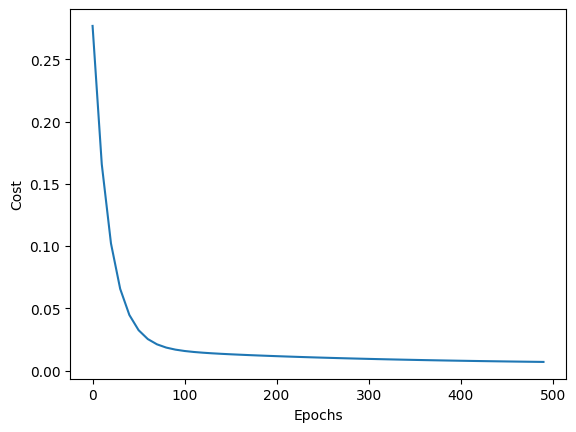

In [ ]:
plt.plot(epoch_list,cost_list)
plt.xlabel('Epochs')
plt.ylabel('Cost')

In [ ]:
def predict(area,bedrooms,w,b):
  scaled_X = xscaler.transform([[area,bedrooms]])[0]
  y_pred = w[0]*scaled_X[0] + w[1]*scaled_X[1] + b
  return yscaler.inverse_transform([[y_pred]])[0][0] # reverse the process of the scaler

predict(2600,4,w,b)

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(


128.45484403267596

In [ ]:
def stochastic_gradient_descent(X, y_true, epochs, learning_rate=0.01):
    m = X.shape[0] #number of samples
    n = X.shape[1] #number of features
    w = np.ones(shape=(n))
    b = 0
    cost_list = []
    epoch_list = []
    for i in range(epochs):
        random_index = np.random.randint(0,m-1)
        sample_x = X[random_index]
        sample_y = y_true[random_index]

        y_pred = np.dot(w,sample_x.T) + b

        w_d = -(2/m)*(sample_x.T.dot(sample_y-y_pred))
        b_d = -(2/m)*np.sum(sample_y-y_pred)

        w = w - learning_rate * w_d
        b = b - learning_rate * b_d

        cost = np.mean(np.square(sample_y-y_pred))

        if i%100==0:
            cost_list.append(cost)
            epoch_list.append(i)

    return w, b, cost, cost_list, epoch_list

In [ ]:
w_sgd, b_sgd, cost_sgd, cost_list_sgd, epoch_list_sgd = stochastic_gradient_descent(scaled_X, scaled_y.reshape(-1),10000)
w_sgd, b_sgd, cost_sgd

(array([0.72872719, 0.7092548 ]), -0.2646450910361398, 0.0002445489723578023)

Text(0, 0.5, 'Cost')

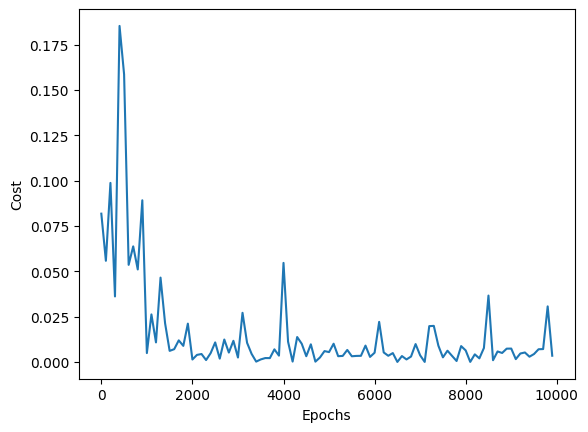

In [ ]:
plt.plot(epoch_list_sgd,cost_list_sgd)
plt.xlabel('Epochs')
plt.ylabel('Cost')

### Exponential Weighted Averages

Exponentially weighted averaging is a weighted averaging method in which the weights are exponentially decreasing, with greater weights assigned to more recent data and lesser weights assigned to earlier data

For given time series data $x_1, x_2, \ldots, x_t$，EWA $v_t$：
$v_t = \beta v_{t-1} + (1 - \beta) x_t$

- $v_t$: EWA for time t
- $β$: Smooth coefficient range: 0 ≤ $β$ < 1
- $x_t$: the data for time t


Expansion:

$v_t = (1 - \beta) \sum_{i=0}^{t-1} \beta^i x_{t-i} + \beta^t v_0$

$v_t$ is the weighted average for all previous data ，weight is $ (1 - \beta) \beta^i$。


β is close to 1:

The weights decay slowly and the historical data have a greater impact.
Smoothing effect is more pronounced, slower response.

β close to 0:

Weights decay quickly, more focus on recent data.
The smoothing effect is weaker and the response is faster.



> Bias Correction

At the beginning， $v_0$ is always 0, leading $v_t$ quite small.
Thus，introducing Bias Correction：

$$
\hat{v}_t = \frac{v_t}{1 - \beta^t}
$$

- **Purpose**：Eliminate the impact of initial value on EWA，makes the evaluation more accurate




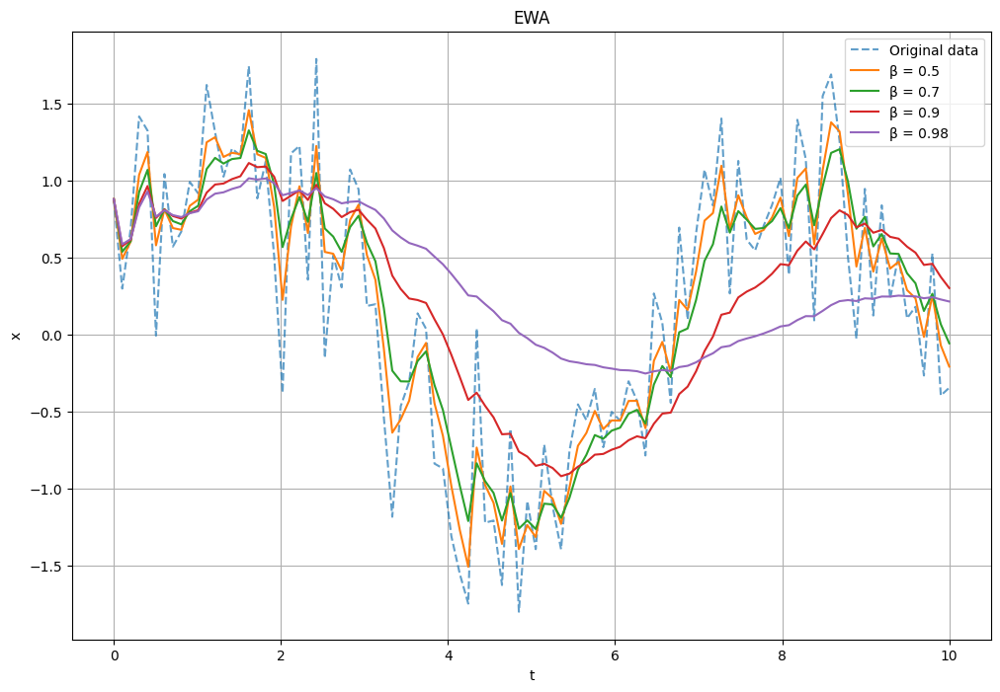

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

np.random.seed(0)
t = np.linspace(0, 10, 100)
x = np.sin(t) + np.random.normal(0, 0.5, size=t.shape)

beta_values = [0.5, 0.7, 0.9, 0.98]

plt.figure(figsize=(12, 8))
plt.plot(t, x, label='Original data', linestyle='--', alpha=0.7)

for beta in beta_values:
    v = np.zeros_like(x)
    v_corrected = np.zeros_like(x)
    v_prev = 0

    for i in range(len(x)):
        v[i] = beta * v_prev + (1 - beta) * x[i]
        v_prev = v[i]
        v_corrected[i] = v[i] / (1 - beta ** (i + 1))
    plt.plot(t, v_corrected, label=f'β = {beta}')

plt.title('EWA')
plt.xlabel('t')
plt.ylabel('x')
plt.legend()
plt.grid(True)
plt.show()




> **Newton's Method**

In optimization problems, the goal is to minimize (or maximize) an objective function f(x). For multivariate functions, Newton's method is extended to use the gradient (first derivative) and the Hessian Matrix (second derivative) for iterative updates

$$
\mathbf{x}_{n+1} = \mathbf{x}_n - \mathbf{H}^{-1}(\mathbf{x}_n) \nabla f(\mathbf{x}_n)
$$

1. Initialization: choose an initial point x0. (could be parameters)
2. Calculate gradient and Hessian matrix: Calculate the gradient of the objective function ∇f(xn) and the Hessian matrix H(xn) at the current point xn.
3. Calculate update direction: Solve the system of linear equations H(xn)Δxn=∇f(xn) to get the update direction Δxn.
4. Update parameter: update the estimated point xn+1=xn-Δxn.
5. Convergence judgment: if $∥Δx_n∥ or ∥∇f(x_n)∥$ is smaller than the preset threshold, stop iteration; otherwise, return to step 2

Pros and cons:
* pros
1. **Fast convergence**: near the approximate optimal point, Newton's method has a **quadratic convergence** speed, much faster than first-order methods such as gradient descent.
2. Utilizing second-order information: By using the Hessian matrix, Newton's method can more **accurately** reflect the curvature information of the objective function, and the optimization process is more efficient
* cons
1. **High computational cost**: For high dimensional problems, the cost of computing and storing the Hessian matrix and its inverse matrix is very high, limiting the application of Newton's method to large scale problems.
2. Positive definiteness of the Hessian matrix: Newton's method assumes that the Hessian matrix is positive definite to ensure the direction of descent. However, in practice, the Hessian matrix may not satisfy this condition, causing the algorithm to fail or converge to a saddle point.
3. Initial point dependence: Newton's method is more sensitive to the initial point, and improper selection may lead to failure of convergence or convergence to a local optimum.

* Example

Initial point $\mathbf{x}_0 = (1.0, 1.0)$

Calculate the gradient $\nabla f(\mathbf{x}_0) = (2, 2)$

Calculate the Hessian matrix $\mathbf{H} = \begin{bmatrix} 2 & 0 \\ 0 & 2 \end{bmatrix}$

Calculate the inverse of the Hessian matrix $\mathbf{H}^{-1} = \begin{bmatrix} 0.5 & 0 \\ 0 & 0.5 \end{bmatrix}$

Update $\Delta \mathbf{x} = \mathbf{H}^{-1} \nabla f(\mathbf{x}_0) = (1.0, 1.0)$

Update $\mathbf{x}_1 = \mathbf{x}_0 - \Delta \mathbf{x} = (0, 0)$

Check convergence condition:

$$
\|\mathbf{x}_1 - \mathbf{x}_0\| = \sqrt{(0 - 1)^2 + (0 - 1)^2} = \sqrt{2} > 1e^{-6}
$$

However, in the next iteration, the gradient is zero, reaching the optimal solution.




> **GD with momentum**

In gradient descent, previous gradients are accumulated to form momentum terms that accelerate convergence and reduce oscillations

We want the update of gradient to be fast on horizontal and slow on vertical

$$
v_t = \beta v_{t-1} + (1 - \beta) \nabla_\theta J(\theta)
$$
$$
\theta = \theta - \alpha v_t
$$

- $\nabla_\theta J(\theta)$: The current gradient
- $v_t$: The exponentially weighted average (moment)
- $\alpha$: Learning rate
- $\beta$: momentum averaging parameter

* 'Unbiasing' momentum terms
$$
\theta_{t+1} = \theta_t - \frac{\alpha v_{t+1}}{1-\beta^{t+1}}
$$
If as we do in above, the momentum term $v_t$ will be smaller in initial iterations than in later ones, so by unbias the update we can have equal expected magnitude across all iterations

This actually makes the first few steps larger than classific momentum

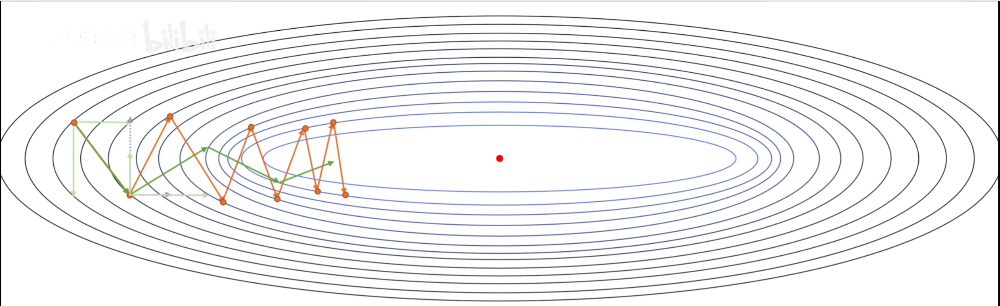

* Nesterov Momentum

This computes momentum update at "next" point


$$
v_t = \beta v_{t-1} + (1 - \beta) \nabla_\theta J(\theta_{t-1} - \alpha v_{t-1})
$$
$$
\theta_{t} = \theta_{t-1} - \alpha v_{t}
$$

Advantages:

Faster convergence: By correcting in advance, NAG is able to approximate the optimal solution faster.

Reduced oscillations: In steep or narrow valleys, NAG is able to reduce oscillations more effectively.

More accurate gradient estimation: calculating the gradient before the parameters are updated makes the gradient direction more accurate.

Disadvantages:

Slightly higher computational complexity: requires the gradient to be computed at the predicted position, adding some computational overhead.

Hyperparameter tuning: similar to the momentum method, NAG needs to adjust the momentum decay coefficient and learning rate appropriately.

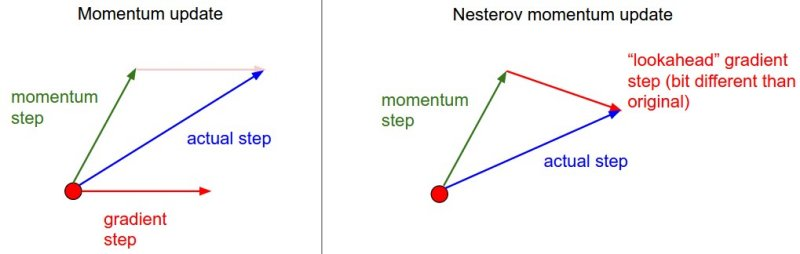

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

theta = 5.0
alpha = 0.1
beta = 0.9
num_iterations = 50

theta_values = []
loss_values = []

v = 0

for i in range(num_iterations):
    grad = 2 * theta  # J(θ) = θ^2

    v = beta * v + (1 - beta) * grad

    theta = theta - alpha * v

    loss = theta ** 2

    theta_values.append(theta)
    loss_values.append(loss)

    print(f"Iteration {i+1}: θ = {theta:.5f}, Loss = {loss:.5f}")


plt.figure(figsize=(8, 4))
plt.plot(range(1, num_iterations + 1), loss_values, marker='o')
plt.title('Momentum')
plt.xlabel('iteration')
plt.ylabel('J(θ)')
plt.grid(True)
plt.show()


In [ ]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Flatten
from tensorflow.keras.optimizers import SGD
from tensorflow.keras.datasets import mnist

# 加载和预处理数据
(x_train, y_train), (x_test, y_test) = mnist.load_data()
x_train, x_test = x_train / 255.0, x_test / 255.0

# 构建模型
model = Sequential([
    Flatten(input_shape=(28, 28)),
    Dense(128, activation='relu'),
    Dense(10, activation='softmax')  # 输出层使用 Softmax 激活
])

# 定义优化器，使用 Nesterov 加速梯度
optimizer = SGD(learning_rate=0.01, momentum=0.9, nesterov=True)

# 编译模型
model.compile(optimizer=optimizer,
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

# 训练模型
model.fit(x_train, y_train, epochs=10, batch_size=32, validation_split=0.1)

# 评估模型
loss, accuracy = model.evaluate(x_test, y_test)
print(f"Test Accuracy: {accuracy}")


11490434/11490434 ━━━━━━━━━━━━━━━━━━━━ 1s 0us/step


/usr/local/lib/python3.10/dist-packages/keras/src/layers/reshaping/flatten.py:37: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 1/10
1688/1688 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - accuracy: 0.8533 - loss: 0.5165 - val_accuracy: 0.9603 - val_loss: 0.1524
Epoch 2/10
1688/1688 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - accuracy: 0.9526 - loss: 0.1659 - val_accuracy: 0.9682 - val_loss: 0.1162
Epoch 3/10
1688/1688 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - accuracy: 0.9653 - loss: 0.1177 - val_accuracy: 0.9750 - val_loss: 0.0919
Epoch 4/10
1688/1688 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - accuracy: 0.9732 - loss: 0.0920 - val_accuracy: 0.9767 - val_loss: 0.0822
Epoch 5/10
1688/1688 ━━━━━━━━━━━━━━━━━━━━ 7s 3ms/step - accuracy: 0.9789 - loss: 0.0731 - val_accuracy: 0.9765 - val_loss: 0.0797
Epoch 6/10
1688/1688 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - accuracy: 0.9818 - loss: 0.0631 - val_accuracy: 0.9770 - val_loss: 0.0777
Epoch 7/10
1688/1688 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - accuracy: 0.9847 - loss: 0.0520 - val_accuracy: 0.9780 - val_loss: 0.0730
Epoch 8/10
1688/1688 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - accuracy: 0.9882 - loss: 0.0441 - 

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import datasets, transforms

# 数据预处理
transform = transforms.Compose([transforms.ToTensor(), transforms.Normalize((0.5,), (0.5,))])

# 加载数据集
train_dataset = datasets.MNIST(root='./data', train=True, download=True, transform=transform)
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=32, shuffle=True)

test_dataset = datasets.MNIST(root='./data', train=False, download=True, transform=transform)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=32, shuffle=False)

# 定义模型
class MyModel(nn.Module):
    def __init__(self):
        super(MyModel, self).__init__()
        self.flatten = nn.Flatten()
        self.fc1 = nn.Linear(28 * 28, 128)
        self.relu = nn.ReLU()
        self.fc2 = nn.Linear(128, 10)
        self.softmax = nn.Softmax(dim=1)

    def forward(self, x):
        x = self.flatten(x)
        x = self.fc1(x)
        x = self.relu(x)
        x = self.fc2(x)
        return self.softmax(x)

model = MyModel()

# 定义损失函数和优化器，使用 Nesterov 加速梯度
criterion = nn.CrossEntropyLoss()
optimizer = optim.SGD(model.parameters(), lr=0.01, momentum=0.9, nesterov=True)

# 训练模型
for epoch in range(10):
    model.train()
    running_loss = 0.0
    for batch_idx, (inputs, targets) in enumerate(train_loader):
        # 前向传播
        outputs = model(inputs)
        loss = criterion(outputs, targets)

        # 反向传播和优化
        optimizer.zero_grad()  # 清除之前的梯度
        loss.backward()        # 计算梯度
        optimizer.step()       # 更新参数

        running_loss += loss.item()
        if batch_idx % 100 == 99:
            print(f"Epoch {epoch + 1}, Batch {batch_idx + 1}, Loss: {running_loss / 100:.4f}")
            running_loss = 0.0

# 评估模型
model.eval()
correct = 0
total = 0
with torch.no_grad():
    for inputs, targets in test_loader:
        outputs = model(inputs)
        _, predicted = torch.max(outputs.data, 1)
        total += targets.size(0)
        correct += (predicted == targets).sum().item()

print(f"Test Accuracy: {100 * correct / total:.2f}%")




> **RMSprop**

The average of the squared gradients is used to dynamically adjust the **learning rate**

$$
s_{dw} = \beta s_{dw} + (1 - \beta)dw^2
$$

$dw$ are small

$$
s_{db} = \beta s_{db} + (1 - \beta)db^2
$$

$db$ are large


$$
w = w - \alpha \frac{dw}{\sqrt{s_{dw}}}
$$

$$
b = b - \alpha \frac{db}{\sqrt{s_{db}}}
$$
with large db to divide, the oscilation on vertical will be small

Assuming that the w is the horizontal axis,

b is the vertical axis.

Still, we want slow on vertical and fast on horizontal

**Slow down the direction with large partial derivative**



> **Adam**

Adaptive moment estimation

Combining *Momentum* and *RMSProp*, exponentially weighted averaging of first-order and second-order moments of gradients

$$
v_t = \beta_1 v_{t-1} + (1 - \beta_1) \nabla_\theta J(\theta)
$$
$$
s_t = \beta_2 s_{t-1} + (1 - \beta_2) [\nabla_\theta J(\theta)]^2
$$
$$
\hat{v}_t = \frac{v_t}{1 - \beta_1^t}
$$
$$
\hat{s}_t = \frac{s_t}{1 - \beta_2^t}
$$
$$
\theta = \theta - \alpha \frac{\hat{v}_t}{\sqrt{\hat{s}_t} + \epsilon}
$$

Where θ is a generalized parameter stands for w,b




```
Pseudocode:

Initialize parameters θ₀
Initialize first moment vector m₀ = 0
Initialize second moment vector v₀ = 0
Initialize time step t = 0

While θₜ not converged do:
    t = t + 1
    Compute gradient gₜ = ∇ₜ J(θₜ₋₁)
    Update biased first moment estimate:
        mₜ = β₁ * mₜ₋₁ + (1 - β₁) * gₜ
    Update biased second moment estimate:
        vₜ = β₂ * vₜ₋₁ + (1 - β₂) * gₜ²
    Compute bias-corrected first moment estimate:
        m̂ₜ = mₜ / (1 - β₁ᵗ)
    Compute bias-corrected second moment estimate:
        v̂ₜ = vₜ / (1 - β₂ᵗ)
    Update parameters:
        θₜ = θₜ₋₁ - α * m̂ₜ / (√(v̂ₜ) + ε)

```



In [ ]:
import numpy as np

class AdamOptimizer:
    def __init__(self, parameters, learning_rate=0.001, beta1=0.9, beta2=0.999, epsilon=1e-8):
        self.parameters = parameters  # List of parameters to optimize
        self.learning_rate = learning_rate
        self.beta1 = beta1
        self.beta2 = beta2
        self.epsilon = epsilon

        # Initialize moment estimates
        self.m = [np.zeros_like(p) for p in parameters]
        self.v = [np.zeros_like(p) for p in parameters]
        self.t = 0  # Time step

    def step(self, gradients):
        self.t += 1
        updated_params = []
        for i, (param, grad) in enumerate(zip(self.parameters, gradients)):
            # Update biased first moment estimate
            self.m[i] = self.beta1 * self.m[i] + (1 - self.beta1) * grad
            # Update biased second moment estimate
            self.v[i] = self.beta2 * self.v[i] + (1 - self.beta2) * (grad ** 2)
            # Compute bias-corrected moment estimates
            m_hat = self.m[i] / (1 - self.beta1 ** self.t)
            v_hat = self.v[i] / (1 - self.beta2 ** self.t)
            # Update parameters
            param_update = self.learning_rate * m_hat / (np.sqrt(v_hat) + self.epsilon)
            param -= param_update
            updated_params.append(param)
        return updated_params

# Example usage:
# Initialize parameters
theta = [np.random.randn(3, 3), np.random.randn(3, 1)]  # Example parameters
optimizer = AdamOptimizer(theta)

# Dummy gradients
gradients = [np.random.randn(*p.shape) for p in theta]

# Update parameters
theta = optimizer.step(gradients)


| Algorithm           | Learning Rate Adaptation     | Momentum  | Suitable for Sparse Gradients | Bias Correction |
|---------------------|------------------------------|-----------|-------------------------------|-----------------|
| SGD                 | No                           | Optional  | No                            | No              |
| SGD with Momentum   | No                           | Yes       | No                            | No              |
| AdaGrad             | Yes (per-parameter)          | No        | Yes                           | No              |
| RMSProp             | Yes (exponential decay)      | No        | Yes                           | No              |
| Adam                | Yes (adaptive moment)        | Yes       | Yes                           | Yes             |


## **Hyperparameter Tuning**

### Batch Norm

Aims to solve the problem of gradient vanishing and gradient explosion in deep neural network training to accelerate training and improve model performance

* Internal Covariate Shift (ICS): during training, changes in the parameters of the previous layer lead to changes in the input distribution of the subsequent layer, which increases the difficulty of training.

* Gradient Vanishing and Gradient Explosion: the gradient of a deep network may decrease or increase layer by layer during backpropagation, making training difficult.

* Batch Normalization The above problems are mitigated by normalizing the inputs at each layer, allowing the use of higher learning rates and faster training.

For the given mini-batch input $\{x^{(1)}, x^{(2)}, \ldots, x^{(m)}\}$, the steps for batch normalization are as follows:

1. **Calculate the batch mean:**

$$
\mu_B = \frac{1}{m} \sum_{i=1}^{m} x^{(i)}
$$

2. **Calculate the batch variance:**

$$
\sigma_B^2 = \frac{1}{m} \sum_{i=1}^{m} (x^{(i)} - \mu_B)^2
$$

3. **Normalization:**

$$
\hat{x}^{(i)} = \frac{x^{(i)} - \mu_B}{\sqrt{\sigma_B^2 + \epsilon}}
$$

- $\epsilon$ is a small constant to prevent division by zero, typically taken to be $10^{-5}$.


Batch normalization introduces two learnable parameters:

- **Scale parameter** $\gamma$: Used to adjust the standard deviation $\sqrt{\sigma_B^2 + \epsilon}$
- **Shift parameter** $\beta$: Used to adjust the mean $\mu_B$

The output after normalization is given by:

$$
y^{(i)} = \gamma \hat{x}^{(i)} + \beta
$$

By learning $\gamma$ and $\beta$, the network can reproduce any possible input distribution.




> Why?

* batch normalization stabilizes the distribution of inputs across layers by normalizing the inputs of each layer to have a mean of 0 and a variance of 1. In this way, subsequent layers do not have to be adjusted frequently to accommodate input changes, and the model can learn faster

* Since batch normalization stabilizes the distribution of activation values and mitigates the problems of gradient explosion and gradient vanishing, **higher learning rates** can be safely used. This results in larger parameter updates and faster model convergence
  * Through standardization, the inputs of each layer are kept within a more stable range, preventing the activation values from being too large or too small, thus maintaining the stability of the gradient and facilitating effective parameter updating

In [ ]:
def batch_norm(X, gamma, beta, moving_mean, moving_var, eps, momentum):
    # Use is_grad_enabled to determine whether we are in training mode
    if not torch.is_grad_enabled():
        # In prediction mode, use mean and variance obtained by moving average
        X_hat = (X - moving_mean) / torch.sqrt(moving_var + eps)
    else:
        assert len(X.shape) in (2, 4)
        if len(X.shape) == 2:
            # When using a fully connected layer, calculate the mean and
            # variance on the feature dimension
            mean = X.mean(dim=0)
            var = ((X - mean) ** 2).mean(dim=0)
        else:
            # When using a two-dimensional convolutional layer, calculate the
            # mean and variance on the channel dimension (axis=1). Here we
            # need to maintain the shape of X, so that the broadcasting
            # operation can be carried out later
            mean = X.mean(dim=(0, 2, 3), keepdim=True)
            var = ((X - mean) ** 2).mean(dim=(0, 2, 3), keepdim=True)
        # In training mode, the current mean and variance are used
        X_hat = (X - mean) / torch.sqrt(var + eps)
        # Update the mean and variance using moving average
        moving_mean = (1.0 - momentum) * moving_mean + momentum * mean
        moving_var = (1.0 - momentum) * moving_var + momentum * var
    Y = gamma * X_hat + beta  # Scale and shift
    return Y, moving_mean.data, moving_var.data

In [ ]:
class BatchNorm(nn.Module):
    # num_features: the number of outputs for a fully connected layer or the
    # number of output channels for a convolutional layer. num_dims: 2 for a
    # fully connected layer and 4 for a convolutional layer
    def __init__(self, num_features, num_dims):
        super().__init__()
        if num_dims == 2:
            shape = (1, num_features)
        else:
            shape = (1, num_features, 1, 1)
        # The scale parameter and the shift parameter (model parameters) are
        # initialized to 1 and 0, respectively
        self.gamma = nn.Parameter(torch.ones(shape))
        self.beta = nn.Parameter(torch.zeros(shape))
        # The variables that are not model parameters are initialized to 0 and
        # 1
        self.moving_mean = torch.zeros(shape)
        self.moving_var = torch.ones(shape)

    def forward(self, X):
        # If X is not on the main memory, copy moving_mean and moving_var to
        # the device where X is located
        if self.moving_mean.device != X.device:
            self.moving_mean = self.moving_mean.to(X.device)
            self.moving_var = self.moving_var.to(X.device)
        # Save the updated moving_mean and moving_var
        Y, self.moving_mean, self.moving_var = batch_norm(
            X, self.gamma, self.beta, self.moving_mean,
            self.moving_var, eps=1e-5, momentum=0.1)
        return Y